In [1]:
import torch
from Loader_17 import DAVIS_Rawset, DAVIS_Infer, DAVIS_Dataset, normalize
from polygon import RasLoss, SoftPolygon
from tqdm import tqdm
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import numpy as np
import copy
import matplotlib.pyplot as plt
from einops import rearrange
import torch.nn.functional as F
from MyLoss import deviation_loss, total_len_loss
from torch.nn.init import xavier_uniform_
from ms_deform_attn import MSDeformAttn
from torch.utils.data import Dataset

In [2]:
train_rawset = DAVIS_Rawset(is_train=True)
val_rawset = DAVIS_Rawset(is_train=False)

In [3]:
class OneVideoImageDataset(Dataset):
    def __init__(
        self,
        video_set: list[tuple[torch.Tensor, torch.Tensor]],
    ) -> None:
        super().__init__()
        self.video_set = video_set

    def __len__(self) -> int:
        return len(self.video_set)

    def __getitem__(
        self,
        index: int,
    ) -> tuple[torch.Tensor, torch.Tensor]:
        return self.video_set[index]

In [4]:
video_image_dataset = OneVideoImageDataset(train_rawset.data_set[0])
video_image_loader = DataLoader(video_image_dataset, batch_size=1, shuffle=True)

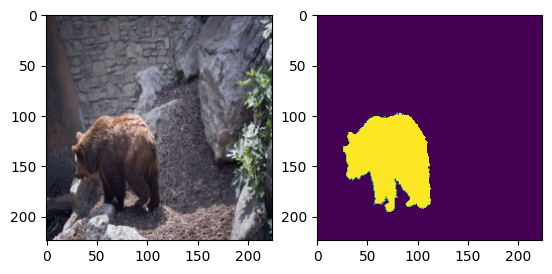

In [5]:
# test the loader, get the first batch
img, mask = next(iter(video_image_loader))
plt.figure()
plt.subplot(1, 2, 1)
plt.imshow(normalize(img[0].permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.imshow(mask[0])
plt.show()

torch.Size([3, 224, 224]) torch.Size([224, 224])


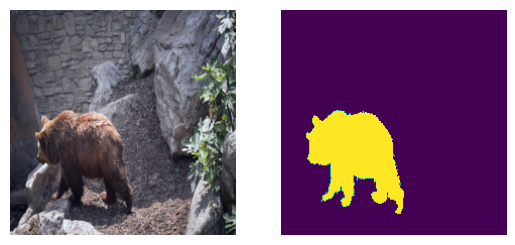

In [6]:
video_idx = 0
frame_idx = 0
bear_img, bear_mask = train_rawset.data_set[video_idx][frame_idx]
print(bear_img.shape, bear_mask.shape)
plt.figure()
plt.subplot(1, 2, 1)
plt.axis('off')
plt.imshow(normalize(bear_img.permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.axis('off')
plt.imshow(bear_mask)
plt.show()

torch.Size([3, 224, 224]) torch.Size([224, 224])


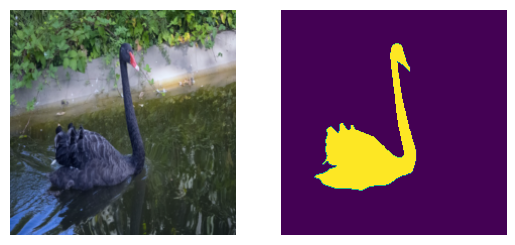

In [7]:
video_idx = 2
frame_idx = 0
swan_img, swan_mask = val_rawset.data_set[video_idx][frame_idx]
print(swan_img.shape, swan_mask.shape)
plt.figure()
plt.subplot(1, 2, 1)
plt.axis('off')
plt.imshow(normalize(swan_img.permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.axis('off')
plt.imshow(swan_mask)
plt.show()
batch_swan_img = swan_img.unsqueeze(0).cuda()
batch_swan_mask = swan_mask.unsqueeze(0).cuda()

torch.Size([3, 224, 224]) torch.Size([224, 224])


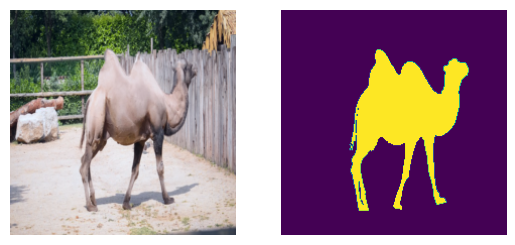

In [8]:
video_idx = 6
frame_idx = 0
camel_img, camel_mask = val_rawset.data_set[video_idx][frame_idx]
print(camel_img.shape, camel_mask.shape)
plt.figure()
plt.subplot(1, 2, 1)
plt.axis('off')
plt.imshow(normalize(camel_img.permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.axis('off')
plt.imshow(camel_mask)
plt.show()
batch_camel_img = camel_img.unsqueeze(0).cuda()
batch_camel_mask = camel_mask.unsqueeze(0).cuda()


torch.Size([3, 224, 224]) torch.Size([224, 224])


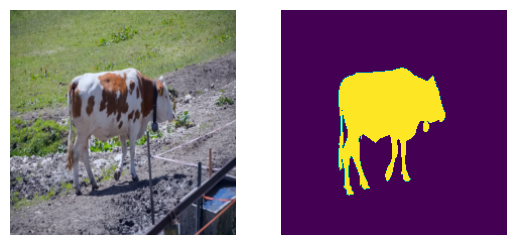

In [9]:
video_idx = 9
frame_idx = 0
cow_img, cow_mask = val_rawset.data_set[video_idx][frame_idx]
print(cow_img.shape, cow_mask.shape)
plt.figure()
plt.subplot(1, 2, 1)
plt.axis('off')
plt.imshow(normalize(cow_img.permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.axis('off')
plt.imshow(cow_mask)
plt.show()
batch_cow_img = cow_img.unsqueeze(0).cuda()
batch_cow_mask = cow_mask.unsqueeze(0).cuda()


torch.Size([3, 224, 224]) torch.Size([224, 224])


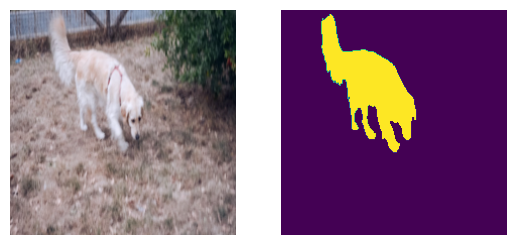

In [10]:
video_idx = 11
frame_idx = 0
dog_img, dog_mask = val_rawset.data_set[video_idx][frame_idx]
print(dog_img.shape, dog_mask.shape)
plt.figure()
plt.subplot(1, 2, 1)
plt.axis('off')
plt.imshow(normalize(dog_img.permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.axis('off')
plt.imshow(dog_mask)
plt.show()
batch_dog_img = dog_img.unsqueeze(0).cuda()
batch_dog_mask = dog_mask.unsqueeze(0).cuda()


In [11]:
def _get_clones(module, N):
    return nn.ModuleList([copy.deepcopy(module) for i in range(N)])


def _get_activation_fn(activation):
    """Return an activation function given a string"""
    if activation == "relu":
        return F.relu
    if activation == "gelu":
        return F.gelu
    if activation == "glu":
        return F.glu
    raise RuntimeError(F"activation should be relu/gelu, not {activation}.")

In [12]:
def get_valid_ratio(mask):
        _, H, W = mask.shape
        valid_H = torch.sum(~mask[:, :, 0], 1)
        valid_W = torch.sum(~mask[:, 0, :], 1)
        valid_ratio_h = valid_H.float() / H
        valid_ratio_w = valid_W.float() / W
        valid_ratio = torch.stack([valid_ratio_w, valid_ratio_h], -1)
        return valid_ratio
get_valid_ratio(torch.zeros_like(bear_mask).unsqueeze(0).bool())

tensor([[1., 1.]])

In [13]:
batch_bear_img = bear_img.unsqueeze(0).cuda()
batch_bear_mask = bear_mask.unsqueeze(0).cuda()
batch_bear_img.shape, batch_bear_mask.shape

(torch.Size([1, 3, 224, 224]), torch.Size([1, 224, 224]))

In [23]:
featup = torch.hub.load(
    "mhamilton723/FeatUp",
    "dino16",
    use_norm=True,
).cuda()
base_encoder = featup.model

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [24]:
bear_feats = featup(batch_bear_img)
bear_feats.shape

/work3/s232248/miniconda3/envs/rass/lib/python3.12/site-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1720538439764/work/aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


torch.Size([1, 384, 224, 224])

In [25]:
srcs = []
padding_masks = []
lower_reses = [14, 56]
for low_res in lower_reses:
    srcs.append(
        F.interpolate(
            bear_feats,
            size=(low_res, low_res),
            mode="bilinear",
        ),
    )
srcs.append(bear_feats)
for src in srcs:
    padding_masks.append(torch.zeros_like(src[:, 0:1, :, :]).squeeze(1).bool())
padding_masks[-1].shape

torch.Size([1, 224, 224])

In [26]:
# prepare the input for the MSDeformAttn module
src_flatten = []
spatial_shapes = []
for idx, src in enumerate(srcs):
    src_flatten.append(
        rearrange(src, "b c h w -> b (h w) c"),
    )
    spatial_shapes.append(src.shape[-2:])
level_start_index = torch.cat((torch.tensor([0]), torch.cumsum(torch.tensor([x.shape[1] for x in src_flatten]), 0)[:-1])).cuda()
src_flatten = torch.cat(src_flatten, 1).cuda()
valid_ratios = torch.stack([get_valid_ratio(mask) for mask in padding_masks], 1).cuda()
spatial_shapes = torch.as_tensor(spatial_shapes, dtype=torch.long, device=src_flatten.device)
level_start_index, spatial_shapes, src_flatten.shape, valid_ratios.shape

(tensor([   0,  196, 3332], device='cuda:0'),
 tensor([[ 14,  14],
         [ 56,  56],
         [224, 224]], device='cuda:0'),
 torch.Size([1, 53508, 384]),
 torch.Size([1, 3, 2]))

In [14]:
class DeformableTransformerEncoderLayer(nn.Module):
    def __init__(self,
                 d_model=256, d_ffn=1024,
                 dropout=0.1, activation="relu",
                 n_levels=4, n_heads=8, n_points=4):
        super().__init__()

        # self attention
        self.self_attn = MSDeformAttn(d_model, n_levels, n_heads, n_points)
        self.dropout1 = nn.Dropout(dropout)
        self.norm1 = nn.LayerNorm(d_model)

        # ffn
        self.linear1 = nn.Linear(d_model, d_ffn)
        self.activation = _get_activation_fn(activation)
        self.dropout2 = nn.Dropout(dropout)
        self.linear2 = nn.Linear(d_ffn, d_model)
        self.dropout3 = nn.Dropout(dropout)
        self.norm2 = nn.LayerNorm(d_model)

    @staticmethod
    def with_pos_embed(tensor, pos):
        return tensor if pos is None else tensor + pos

    def forward_ffn(self, src):
        src2 = self.linear2(self.dropout2(self.activation(self.linear1(src))))
        src = src + self.dropout3(src2)
        src = self.norm2(src)
        return src

    def forward(self, src, pos, reference_points, spatial_shapes, level_start_index, padding_mask=None):
        # self attention
        src2 = self.self_attn(self.with_pos_embed(src, pos), reference_points, src, spatial_shapes, level_start_index, padding_mask)
        src = src + self.dropout1(src2)
        src = self.norm1(src)

        # ffn
        src = self.forward_ffn(src)

        return src


class DeformableTransformerEncoder(nn.Module):
    def __init__(self, encoder_layer, num_layers):
        super().__init__()
        self.layers = _get_clones(encoder_layer, num_layers)
        self.num_layers = num_layers

    @staticmethod
    def get_reference_points(spatial_shapes, valid_ratios, device):
        reference_points_list = []
        for lvl, (H_, W_) in enumerate(spatial_shapes):

            ref_y, ref_x = torch.meshgrid(torch.linspace(0.5, H_ - 0.5, H_, dtype=torch.float32, device=device),
                                          torch.linspace(0.5, W_ - 0.5, W_, dtype=torch.float32, device=device))
            ref_y = ref_y.reshape(-1)[None] / (valid_ratios[:, None, lvl, 1] * H_)
            ref_x = ref_x.reshape(-1)[None] / (valid_ratios[:, None, lvl, 0] * W_)
            ref = torch.stack((ref_x, ref_y), -1)
            reference_points_list.append(ref)
        reference_points = torch.cat(reference_points_list, 1)
        reference_points = reference_points[:, :, None] * valid_ratios[:, None]
        return reference_points

    def forward(self, src, spatial_shapes, level_start_index, valid_ratios, pos=None, padding_mask=None):
        output = src
        reference_points = self.get_reference_points(spatial_shapes, valid_ratios, device=src.device)
        for _, layer in enumerate(self.layers):
            output = layer(output, pos, reference_points, spatial_shapes, level_start_index, padding_mask)

        return output

In [28]:
deform_encoder_layer = DeformableTransformerEncoderLayer(d_model=384, d_ffn=1024, n_levels=3, n_heads=6, n_points=4).cuda()
deform_encoder = DeformableTransformerEncoder(deform_encoder_layer, num_layers=1).cuda()

In [29]:
encoded_scrs = deform_encoder(
    src=src_flatten,
    spatial_shapes=spatial_shapes,
    level_start_index=level_start_index,
    valid_ratios=valid_ratios,
)
encoded_scrs.shape

torch.Size([1, 53508, 384])

In [15]:
def get_bou_feats(img_feats: torch.Tensor, boundary: torch.Tensor) -> torch.Tensor:
    return img_feats[
        torch.arange(boundary.shape[0]).unsqueeze(1),
        :,
        boundary[:, :, 1],
        boundary[:, :, 0],
    ]


class PositionalEncoding(nn.Module):
    def __init__(self, embed_dim: int, dropout=0.1, max_seq_len=102400) -> None:
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)

        pe = torch.zeros(max_seq_len, embed_dim)
        position = torch.arange(0, max_seq_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(
            torch.arange(0, embed_dim, 2).float() * (-np.log(10000.0) / embed_dim)
        )
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0)
        self.register_buffer("pe", pe)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = x + self.pe[:, : x.size(1)]
        return self.dropout(x)


def get_img_tokens(img_features: torch.Tensor) -> torch.Tensor:
    img_tokens = rearrange(
        img_features,
        "b c h w -> b (h w) c",
    )
    return img_tokens


def get_extrame_4_points(batch_indices: torch.Tensor):
    if batch_indices.shape[0] == 0:
        mid = 224 // 2
        return torch.tensor([[mid, mid], [mid, mid], [mid, mid], [mid, mid]])
    x_min = batch_indices[:, 1].min()
    x_max = batch_indices[:, 1].max()
    y_min = batch_indices[:, 0].min()
    y_max = batch_indices[:, 0].max()
    return torch.tensor(
        [[x_min, y_min], [x_min, y_max], [x_max, y_max], [x_max, y_min]]
    )


def get_bounding_box(sgm: torch.Tensor):
    indices = torch.nonzero(sgm)
    batch_size = sgm.shape[0]
    bounding_boxes = []
    for i in range(batch_size):
        batch_indices = indices[indices[:, 0] == i][:, 1:]
        bounding_boxes.append(get_extrame_4_points(batch_indices))
    return torch.stack(bounding_boxes)


def add_mid_points(points: torch.Tensor) -> torch.Tensor:
    points_shift = torch.roll(points, 1, 1)
    mid_points = (points + points_shift) / 2
    new_points = torch.zeros((points.shape[0], points.shape[1] * 2, 2)).to(
        points.device
    )
    new_points[:, ::2] = mid_points
    new_points[:, 1::2] = points
    return new_points

In [16]:
class DeformableTransformerDecoderLayer(nn.Module):
    def __init__(self, d_model=256, d_ffn=1024,
                 dropout=0.1, activation="relu",
                 n_levels=4, n_heads=8, n_points=4):
        super().__init__()

        # cross attention
        self.cross_attn = MSDeformAttn(d_model, n_levels, n_heads, n_points)
        self.dropout1 = nn.Dropout(dropout)
        self.norm1 = nn.LayerNorm(d_model)

        # self attention
        self.self_attn = nn.MultiheadAttention(d_model, n_heads, dropout=dropout)
        self.dropout2 = nn.Dropout(dropout)
        self.norm2 = nn.LayerNorm(d_model)

        # ffn
        self.linear1 = nn.Linear(d_model, d_ffn)
        self.activation = _get_activation_fn(activation)
        self.dropout3 = nn.Dropout(dropout)
        self.linear2 = nn.Linear(d_ffn, d_model)
        self.dropout4 = nn.Dropout(dropout)
        self.norm3 = nn.LayerNorm(d_model)

    @staticmethod
    def with_pos_embed(tensor, pos):
        return tensor if pos is None else tensor + pos

    def forward_ffn(self, tgt):
        tgt2 = self.linear2(self.dropout3(self.activation(self.linear1(tgt))))
        tgt = tgt + self.dropout4(tgt2)
        tgt = self.norm3(tgt)
        return tgt

    def forward(self, tgt, query_pos, reference_points, src, src_spatial_shapes, level_start_index, src_padding_mask=None):
        # self attention
        q = k = self.with_pos_embed(tgt, query_pos)
        tgt2 = self.self_attn(q.transpose(0, 1), k.transpose(0, 1), tgt.transpose(0, 1))[0].transpose(0, 1)
        tgt = tgt + self.dropout2(tgt2)
        tgt = self.norm2(tgt)

        # cross attention
        tgt2 = self.cross_attn(self.with_pos_embed(tgt, query_pos),
                               reference_points,
                               src, src_spatial_shapes, level_start_index, src_padding_mask)
        tgt = tgt + self.dropout1(tgt2)
        tgt = self.norm1(tgt)

        # ffn
        tgt = self.forward_ffn(tgt)

        return tgt


class DeformableTransformerDecoder(nn.Module):
    def __init__(self, decoder_layer, num_layers, return_intermediate=False):
        super().__init__()
        self.layers = _get_clones(decoder_layer, num_layers)
        self.num_layers = num_layers
        self.return_intermediate = return_intermediate

    def forward(self, tgt, reference_points, src, src_spatial_shapes, src_level_start_index, src_valid_ratios,
                query_pos=None, src_padding_mask=None):
        output = tgt

        intermediate = []
        intermediate_reference_points = []
        for lid, layer in enumerate(self.layers):
            if reference_points.shape[-1] == 4:
                reference_points_input = reference_points[:, :, None] \
                                         * torch.cat([src_valid_ratios, src_valid_ratios], -1)[:, None]
            else:
                assert reference_points.shape[-1] == 2
                reference_points_input = reference_points[:, :, None] * src_valid_ratios[:, None]
            output = layer(output, query_pos, reference_points_input, src, src_spatial_shapes, src_level_start_index, src_padding_mask)

            if self.return_intermediate:
                intermediate.append(output)
                intermediate_reference_points.append(reference_points)

        if self.return_intermediate:
            return torch.stack(intermediate), torch.stack(intermediate_reference_points)

        return output, reference_points

In [32]:
query_embed = nn.Embedding(4, 384).cuda()
query = query_embed.weight.unsqueeze(0).repeat(1, 1, 1).cuda()
init_bou = get_bounding_box(batch_bear_mask).cuda() / 224
init_bou, query.shape, query[:, :2].shape

(tensor([[[0.1116, 0.4464],
          [0.1116, 0.9018],
          [0.5402, 0.9018],
          [0.5402, 0.4464]]], device='cuda:0'),
 torch.Size([1, 4, 384]),
 torch.Size([1, 2, 384]))

In [33]:
deform_decoder_layer = DeformableTransformerDecoderLayer(
    d_model=384,
    d_ffn=1024,
    n_levels=3,
    n_heads=6,
    n_points=4,
).cuda()
deform_decoder = DeformableTransformerDecoder(deform_decoder_layer, num_layers=1).cuda()

In [34]:
decode_output, _ = deform_decoder(
    query,
    init_bou,
    encoded_scrs,
    spatial_shapes,
    level_start_index,
    valid_ratios,
)
decode_output.shape

torch.Size([1, 4, 384])

In [17]:
class MLP(nn.Module):
    """Very simple multi-layer perceptron (also called FFN)"""

    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super().__init__()
        self.num_layers = num_layers
        h = [hidden_dim] * (num_layers - 1)
        self.layers = nn.ModuleList(
            nn.Linear(n, k) for n, k in zip([input_dim] + h, h + [output_dim])
        )

    def forward(self, x):
        for i, layer in enumerate(self.layers):
            x = F.relu(layer(x)) if i < self.num_layers - 1 else layer(x)
        return x


def _get_clones(module, N):
    return nn.ModuleList([copy.deepcopy(module) for i in range(N)])


def inverse_sigmoid(x, eps=1e-5):
    x = x.clamp(min=0, max=1)
    x1 = x.clamp(min=eps)
    x2 = (1 - x).clamp(min=eps)
    return torch.log(x1 / x2)

In [19]:
class DeformLearnImage(nn.Module):
    def __init__(
        self,
        layer_num=1,
        up_scale_num=4,
        head_num=6,
        medium_level_size=[14, 28, 56, 112],
        offset_limit=56,
        n_points=4,
        freeze_backbone=True,
    ) -> None:
        super(DeformLearnImage, self).__init__()
        self.up_scale_num = up_scale_num
        self.offset_limit = offset_limit
        self.medium_level_size = medium_level_size
        self.featup = torch.hub.load(
            "mhamilton723/FeatUp",
            "dino16",
            use_norm=True,
        ).cuda()
        if freeze_backbone:
            for param in self.featup.parameters():
                param.requires_grad = False
        d_model = 384
        d_ffn = 1024
        n_levels = len(medium_level_size) + 1
        self.pos_enoc = PositionalEncoding(d_model)
        self.layer_norm = nn.LayerNorm(d_model)
        deform_encoder_layer = DeformableTransformerEncoderLayer(
            d_model=d_model,
            d_ffn=d_ffn,
            n_levels=n_levels,
            n_heads=head_num,
            n_points=n_points,
        )
        self.deform_encoder = DeformableTransformerEncoder(
            deform_encoder_layer,
            num_layers=layer_num,
        )
        query_num = 4
        self.query_num = query_num
        for i in range(up_scale_num):
            query_num *= 2
        self.query_embed = nn.Embedding(query_num, d_model)
        # init the query embedding
        xavier_uniform_(self.query_embed.weight)
        deform_decoder_layer = DeformableTransformerDecoderLayer(
            d_model=d_model,
            d_ffn=d_ffn,
            n_levels=n_levels,
            n_heads=head_num,
            n_points=n_points,
        )
        deform_decoder = DeformableTransformerDecoder(
            deform_decoder_layer,
            num_layers=layer_num,
        )
        self.deform_decoders = _get_clones(deform_decoder, up_scale_num + 1)
        xy_fc = MLP(d_model, d_model, 2, 3).cuda()
        # xy_fc = nn.Linear(d_model, 2).cuda()
        self.xy_fc = _get_clones(xy_fc, up_scale_num + 1)

    def get_valid_ratio(self, mask: torch.Tensor):
        _, H, W = mask.shape
        valid_H = torch.sum(~mask[:, :, 0], 1)
        valid_W = torch.sum(~mask[:, 0, :], 1)
        valid_ratio_h = valid_H.float() / H
        valid_ratio_w = valid_W.float() / W
        valid_ratio = torch.stack([valid_ratio_w, valid_ratio_h], -1)
        return valid_ratio

    def forward(
        self,
        img: torch.Tensor,
        mask: torch.Tensor,
    ):
        feats = self.featup(img)
        # prepare the input for the MSDeformAttn module
        srcs = []
        padding_masks = []
        for low_res in self.medium_level_size:
            srcs.append(
                F.interpolate(
                    feats,
                    size=(low_res, low_res),
                    mode="bilinear",
                ),
            )
        srcs.append(feats)
        for src in srcs:
            padding_masks.append(torch.zeros_like(src[:, 0:1, :, :]).squeeze(1).bool())
        src_flatten = []
        spatial_shapes = []
        for src in srcs:
            src_flatten.append(
                rearrange(src, "b c h w -> b (h w) c"),
            )
            spatial_shapes.append(src.shape[-2:])
        level_start_index = torch.cat(
            (
                torch.tensor([0]),
                torch.cumsum(
                    torch.tensor([x.shape[1] for x in src_flatten]),
                    0,
                )[:-1],
            )
        ).cuda()
        src_flatten = torch.cat(src_flatten, 1).cuda()
        valid_ratios = torch.stack(
            [self.get_valid_ratio(mask) for mask in padding_masks],
            1,
        ).cuda()
        spatial_shapes = torch.as_tensor(
            spatial_shapes,
            dtype=torch.long,
            device=src_flatten.device,
        )
        src_flatten = self.layer_norm(src_flatten)
        src_flatten = self.pos_enoc(src_flatten)
        src_flatten = self.deform_encoder(
            src=src_flatten,
            spatial_shapes=spatial_shapes,
            level_start_index=level_start_index,
            valid_ratios=valid_ratios,
        )

        B, S, C = src_flatten.shape
        queries = self.query_embed.weight.unsqueeze(0).repeat(B, 1, 1).cuda()
        init_bou = get_bounding_box(mask).cuda() / 224
        current_query_num = init_bou.shape[1]
        current_query = queries[:, :current_query_num]
        decode_output, _ = self.deform_decoders[0](
            current_query,
            init_bou,
            src_flatten,
            spatial_shapes,
            level_start_index,
            valid_ratios,
        )

        xy_offset = (
            (self.xy_fc[0](decode_output).sigmoid() - 0.5) * self.offset_limit / 224
        )
        init_bou += xy_offset

        # xy_offset = self.xy_fc[0](decode_output)
        # xy_offset = xy_offset.sigmoid()
        # init_bou = inverse_sigmoid(init_bou) + xy_offset
        # init_bou = init_bou.sigmoid().clone()
        
        # init_bou = init_bou.clamp(0, 1)

        results = [init_bou]
        for i in range(self.up_scale_num):
            new_query = queries[:, current_query_num : current_query_num * 2]
            current_query_num *= 2

            current_query = torch.zeros((B, current_query_num, C)).to(src_flatten.device)
            current_query[:, ::2] = new_query
            current_query[:, 1::2] = decode_output
            # current_query = torch.cat([new_query, decode_output], 1)

            cur_bou = add_mid_points(results[-1])
            decode_output, _ = self.deform_decoders[i + 1](
                current_query,
                cur_bou,
                src_flatten,
                spatial_shapes,
                level_start_index,
                valid_ratios,
            )

            xy_offset = (
                (self.xy_fc[i + 1](decode_output).sigmoid() - 0.5)
                * self.offset_limit
                / 224
            )
            cur_bou += xy_offset

            # xy_offset = self.xy_fc[i + 1](decode_output)
            # cur_bou = inverse_sigmoid(cur_bou) + xy_offset
            # cur_bou = cur_bou.sigmoid().clone()

            # cur_bou = cur_bou.clamp(0, 1)

            results.append(cur_bou)
        results = [result * 224 for result in results]

        if self.training:
            return results
        else:
            return results[-1]


model = DeformLearnImage(up_scale_num=4).cuda()
model.train()
results = model(batch_bear_img, batch_bear_mask)
results[-1].shape

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


torch.Size([1, 64, 2])

In [73]:
def get_bou_iou(
    index: int,
    boundary: torch.Tensor,
    mask: torch.Tensor,
    rasterizer,
) -> torch.Tensor:
    pred_sgm = rasterizer(boundary, 224, 224)
    pred_sgm[pred_sgm == -1] = 0
    pred_sgm = pred_sgm[index]
    boundary = boundary[index]
    mask = mask[index]
    intersection = pred_sgm * mask
    intersection = intersection.sum()
    union = pred_sgm.sum() + mask.sum() - intersection.sum()
    iou = intersection / union
    return iou

tensor([-1.,  1.], device='cuda:0', grad_fn=<Unique2Backward0>)


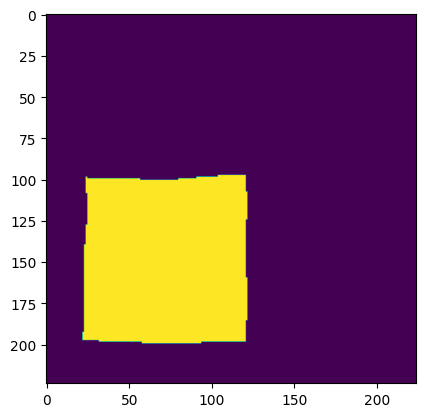

In [72]:
ras_loss = RasLoss().cuda()
gt_rasterizer = SoftPolygon(1, "hard_mask").cuda()
pred_sgm = gt_rasterizer(results[-1], 224, 224)
# pred_sgm = ras_loss.soft_polygon(results[-1], 224, 224)
plt.imshow(pred_sgm[0].detach().cpu().numpy())
print(pred_sgm.unique())

In [287]:
model = DeformLearnImage().cuda()
loss_dict = {}
dif_iou_dict = {}
epoch_num = 300
ras_loss = RasLoss().cuda()
optimizer = optim.Adam(model.parameters(), lr=1e-3)
# with torch.autograd.detect_anomaly():
for e in range(epoch_num):
    model.train()
    optimizer.zero_grad()
    pred_boundary = model(batch_camel_img, batch_camel_mask)
    loss = 0
    for i in range(len(pred_boundary)):
        loss += ras_loss(pred_boundary[i], batch_camel_mask)
    loss /= len(pred_boundary)
    # index = 1
    # loss = ras_loss(pred_boundary[index], batch_camel_mask)
    loss.backward()
    optimizer.step()
    loss_dict[e] = loss.item()
    # iou = get_bou_iou(0, pred_boundary[index], batch_camel_mask, ras_loss.soft_polygon)
    iou = get_bou_iou(
        0,
        pred_boundary[-1],
        batch_camel_mask,
        gt_rasterizer,
        # ras_loss.soft_polygon,
    )
    dif_iou_dict[e] = iou.item()
    print(f"Epoch {e}, Loss: {loss.item()}, IoU: {iou.item()}")

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.3673422634601593, IoU: 0.45821577310562134
Epoch 1, Loss: 0.39376145601272583, IoU: 0.2916102409362793
Epoch 2, Loss: 0.3805931508541107, IoU: 0.46188950538635254
Epoch 3, Loss: 0.3258211612701416, IoU: 0.3595917820930481
Epoch 4, Loss: 0.24751310050487518, IoU: 0.622788667678833
Epoch 5, Loss: 0.2422693967819214, IoU: 0.6369619965553284
Epoch 6, Loss: 0.23236651718616486, IoU: 0.6133973002433777
Epoch 7, Loss: 0.209716796875, IoU: 0.6618613600730896
Epoch 8, Loss: 0.21269682049751282, IoU: 0.6711606979370117
Epoch 9, Loss: 0.20083609223365784, IoU: 0.6881973147392273
Epoch 10, Loss: 0.1998136043548584, IoU: 0.7045873403549194
Epoch 11, Loss: 0.18555869162082672, IoU: 0.715723991394043
Epoch 12, Loss: 0.18363486230373383, IoU: 0.7305175065994263
Epoch 13, Loss: 0.18262434005737305, IoU: 0.7319502830505371
Epoch 14, Loss: 0.1753735989332199, IoU: 0.7411401867866516
Epoch 15, Loss: 0.17471489310264587, IoU: 0.7439268231391907
Epoch 16, Loss: 0.18033179640769958, IoU: 0.7

KeyboardInterrupt: 

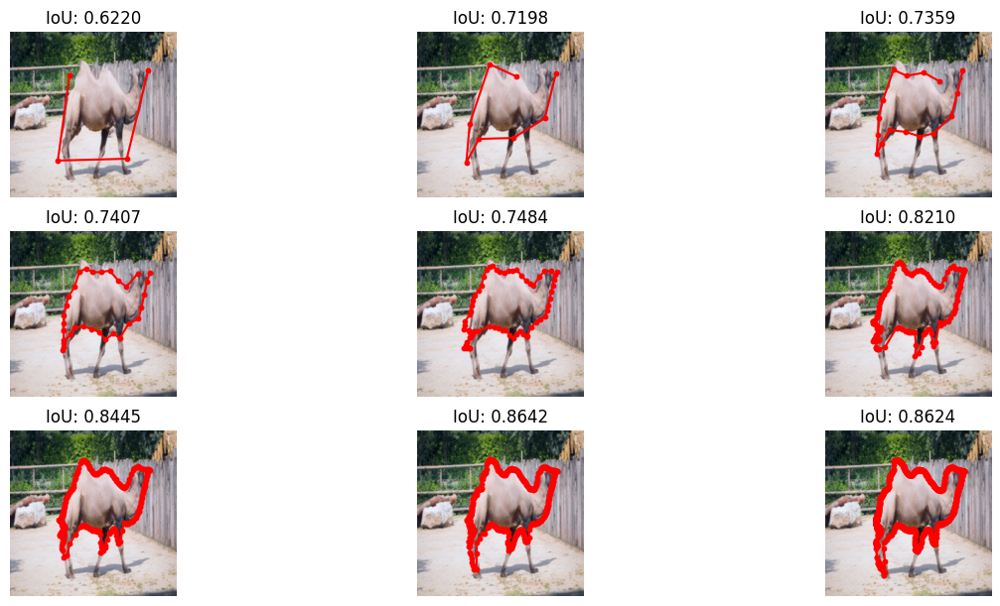

In [283]:
def show_one_image_result(
    img: torch.Tensor,
    mask: torch.Tensor,
    results: torch.Tensor,
    rasterizer: nn.Module,
    index=0,
    one_line_object_num=3,
    figure_size=(15, 10),
) -> None:
    plt.figure(figsize=figure_size)
    line_num = len(results) // one_line_object_num + 1
    for i in range(len(results)):
        plt.subplot(line_num, one_line_object_num, i + 1)
        plt.axis("off")
        iou = get_bou_iou(index, results[i], mask, rasterizer)
        plt.title(f"IoU: {iou.item():.4f}")
        plt.imshow(normalize(img[index].cpu().permute(1, 2, 0)))
        plt.scatter(results[i][index][:, 0].cpu().detach().numpy(), results[i][index][:, 1].cpu().detach().numpy(), s=10, c="r")
        plt.plot(results[i][index][:, 0].cpu().detach().numpy(), results[i][index][:, 1].cpu().detach().numpy(), c="r")
    plt.show()
pred_boundary = model(batch_camel_img, batch_camel_mask)
show_one_image_result(batch_camel_img, batch_camel_mask, pred_boundary, ras_loss.soft_polygon)

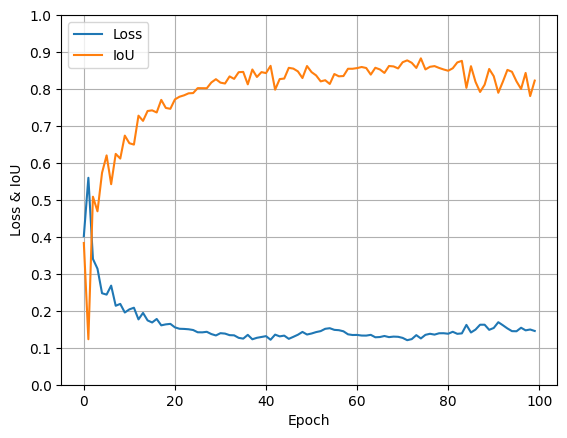

In [284]:
# show iou and loss
plt.figure()
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

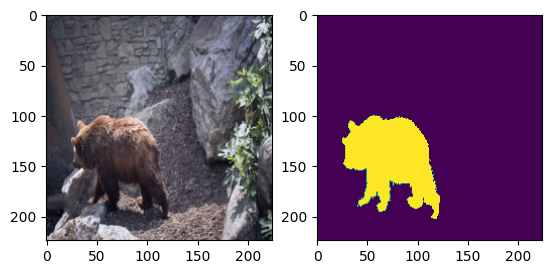

In [56]:
video_idx = 0
video_img_dataset = OneVideoImageDataset(
    train_rawset.data_set[video_idx],
)
video_img_loader = DataLoader(
    video_img_dataset,
    batch_size=1,
    shuffle=False,
)
img, mask = next(iter(video_img_loader))
plt.figure()
plt.subplot(1, 2, 1)
plt.imshow(normalize(img[0].permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.imshow(mask[0])
plt.show()

In [86]:
loss_dict = {}
dif_iou_dict = {}
epoch_num = 100
iou_eval_period = 5
ras_loss = RasLoss().cuda()
model = DeformLearnImage().cuda()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [87]:
for e in range(epoch_num):
    mean_loss = 0
    model.train()
    for img, mask in tqdm(video_img_loader):
        optimizer.zero_grad()
        pred_boundary = model(img.cuda(), mask.cuda())
        loss = 0
        for i in range(len(pred_boundary)):
            loss += ras_loss(pred_boundary[i], mask.cuda())
        loss /= len(pred_boundary)
        loss.backward()
        optimizer.step()
        mean_loss += loss.item()
    mean_loss /= len(video_img_loader)
    print(f"Epoch {e}, Loss: {mean_loss}")
    loss_dict[e] = mean_loss
    if e % iou_eval_period == 0:
        model.eval()
        mean_iou = 0
        for img, mask in tqdm(video_img_loader):
            pred_boundary = model(img.cuda(), mask.cuda())
            iou = get_bou_iou(
                0,
                pred_boundary,
                mask.cuda(),
                gt_rasterizer,
            )
            mean_iou += iou.item()
        mean_iou /= len(video_img_loader)
        print(f"Epoch {e}, IoU: {mean_iou}")
        dif_iou_dict[e] = mean_iou


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.90it/s]


Epoch 0, Loss: 0.11338029211250747


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.04it/s]


Epoch 0, IoU: 0.8380840318958934


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 1, Loss: 0.10165651678675558


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 2, Loss: 0.09549867979637007


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 3, Loss: 0.0899413819538384


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 4, Loss: 0.08837860486492878


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.90it/s]


Epoch 5, Loss: 0.085778252108068


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.06it/s]


Epoch 5, IoU: 0.897536212351264


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 6, Loss: 0.08255356822798891


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 7, Loss: 0.08153990974150054


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 8, Loss: 0.07998240848140019


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.90it/s]


Epoch 9, Loss: 0.0795893314771536


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.90it/s]


Epoch 10, Loss: 0.0780864949451714


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 13.98it/s]


Epoch 10, IoU: 0.8941243472622662


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 11, Loss: 0.07751438257897772


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 12, Loss: 0.07522448615693464


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 13, Loss: 0.0762243471221953


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.90it/s]


Epoch 14, Loss: 0.07383704907828714


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 15, Loss: 0.07380665484361532


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.24it/s]


Epoch 15, IoU: 0.8984888363175276


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 16, Loss: 0.07474480015112132


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.95it/s]


Epoch 17, Loss: 0.07188543563754093


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 18, Loss: 0.0727929481555049


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 19, Loss: 0.07330749679084231


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.97it/s]


Epoch 20, Loss: 0.07038621899739998


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.29it/s]


Epoch 20, IoU: 0.9154636089394732


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 21, Loss: 0.06912568974785688


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 22, Loss: 0.06827266914088552


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 23, Loss: 0.06787205001384747


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 24, Loss: 0.06804029252834437


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 25, Loss: 0.0678268877289644


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.26it/s]


Epoch 25, IoU: 0.9089658718283583


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 26, Loss: 0.06751008545298402


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 27, Loss: 0.06860798415614337


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 28, Loss: 0.06671380169871377


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.95it/s]


Epoch 29, Loss: 0.06624062631915255


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:12<00:00,  6.78it/s]


Epoch 30, Loss: 0.06801333355649215


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.00it/s]


Epoch 30, IoU: 0.9148116773221551


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 31, Loss: 0.06771286290774985


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 32, Loss: 0.06624992318996568


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 33, Loss: 0.06595420937349157


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 34, Loss: 0.0664668543400561


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 35, Loss: 0.06568906124590373


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 13.35it/s]


Epoch 35, IoU: 0.9304047103335218


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.84it/s]


Epoch 36, Loss: 0.0653354915812975


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.89it/s]


Epoch 37, Loss: 0.06580814551107766


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 38, Loss: 0.06511341426067235


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 39, Loss: 0.06461675624113257


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.97it/s]


Epoch 40, Loss: 0.06601928819606943


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.14it/s]


Epoch 40, IoU: 0.9184141449811982


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.97it/s]


Epoch 41, Loss: 0.06613210134389924


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 42, Loss: 0.06526720737356966


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.97it/s]


Epoch 43, Loss: 0.06447489268896056


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 44, Loss: 0.06441352629988659


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 45, Loss: 0.06482006100619711


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.19it/s]


Epoch 45, IoU: 0.929507183592494


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 46, Loss: 0.06451156921684742


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 47, Loss: 0.06468102045175506


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.97it/s]


Epoch 48, Loss: 0.06555408407456992


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 49, Loss: 0.06613370312786684


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 50, Loss: 0.06635543572284826


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.18it/s]


Epoch 50, IoU: 0.9093428697527909


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 51, Loss: 0.06540330544840998


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 52, Loss: 0.06463871114864582


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.97it/s]


Epoch 53, Loss: 0.06460825789992403


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 54, Loss: 0.06576384694837942


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.89it/s]


Epoch 55, Loss: 0.06401383213517142


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 13.88it/s]


Epoch 55, IoU: 0.9381721114240041


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 56, Loss: 0.06396018413872254


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 57, Loss: 0.0643675503570859


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 58, Loss: 0.06286482045018091


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 59, Loss: 0.06377443771173315


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.95it/s]


Epoch 60, Loss: 0.0639892036504135


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.15it/s]


Epoch 60, IoU: 0.9287628124399883


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 61, Loss: 0.06381352136774761


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 62, Loss: 0.06278361457331878


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 63, Loss: 0.0630240199587694


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 64, Loss: 0.06329253406786337


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 65, Loss: 0.0638817745465331


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.23it/s]


Epoch 65, IoU: 0.9300507052642543


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 66, Loss: 0.06353932273824041


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 67, Loss: 0.0641337762155184


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 68, Loss: 0.06330985439623274


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 69, Loss: 0.06398846854160471


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 70, Loss: 0.06364922180044942


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.12it/s]


Epoch 70, IoU: 0.9320674872979885


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 71, Loss: 0.06363491682199443


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 72, Loss: 0.06297036505690436


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 73, Loss: 0.06311485589277453


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.95it/s]


Epoch 74, Loss: 0.06151807162819839


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 75, Loss: 0.061517160158695246


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.21it/s]


Epoch 75, IoU: 0.9283474989053679


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.97it/s]


Epoch 76, Loss: 0.06217860253300608


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 77, Loss: 0.0629050797987275


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 78, Loss: 0.06281087938241842


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 79, Loss: 0.06188487724923506


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 80, Loss: 0.062269710731215594


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.18it/s]


Epoch 80, IoU: 0.9315574888775988


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 81, Loss: 0.06222110300711015


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 82, Loss: 0.06140066974046754


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 83, Loss: 0.06148820515812897


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 84, Loss: 0.06158462044124196


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 85, Loss: 0.061890471999238174


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.32it/s]


Epoch 85, IoU: 0.9409132141892503


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 86, Loss: 0.062277799881086116


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 87, Loss: 0.06250872158604424


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 88, Loss: 0.06212532833763739


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.96it/s]


Epoch 89, Loss: 0.06236121789892999


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 90, Loss: 0.06276569279228769


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.32it/s]


Epoch 90, IoU: 0.9386085860612916


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 91, Loss: 0.06235235874972692


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 92, Loss: 0.062306768056459544


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 93, Loss: 0.06224921472915789


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 94, Loss: 0.06188137770244261


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 95, Loss: 0.06140531722183635


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.26it/s]


Epoch 95, IoU: 0.9407278415633411


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 96, Loss: 0.06160200359981235


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 97, Loss: 0.06117131283915624


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 98, Loss: 0.06114931395504533


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]

Epoch 99, Loss: 0.06088003207270692


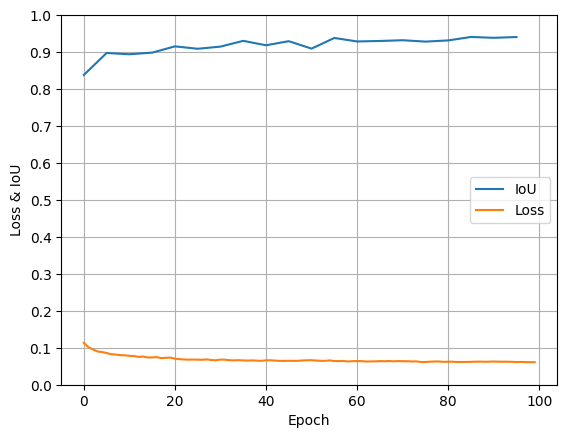

In [88]:
# show iou and loss
plt.figure()
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

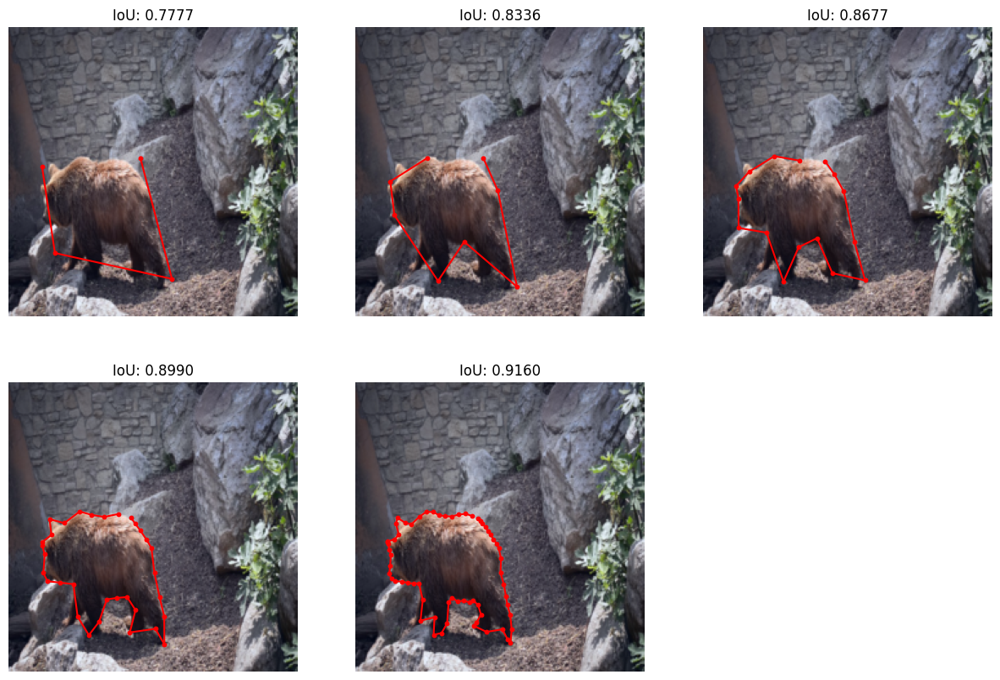

In [98]:
img, mask = next(iter(video_img_loader))
# show the result of one image
pred_boundary = model(img.cuda(), mask.cuda())
show_one_image_result(img.cuda(), mask.cuda(), pred_boundary, gt_rasterizer)

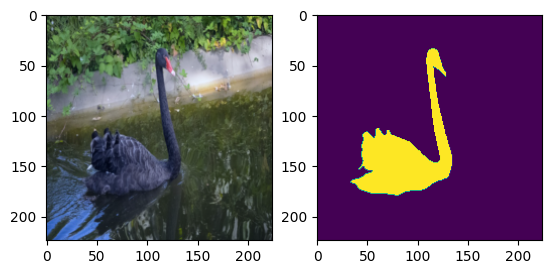

In [103]:
video_idx = 2
video_img_dataset = OneVideoImageDataset(
    val_rawset.data_set[video_idx],
)
video_img_loader = DataLoader(
    video_img_dataset,
    batch_size=1,
    shuffle=False,
)
img, mask = next(iter(video_img_loader))
plt.figure()
plt.subplot(1, 2, 1)
plt.imshow(normalize(img[0].permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.imshow(mask[0])
plt.show()

In [105]:
loss_dict = {}
dif_iou_dict = {}
epoch_num = 50
iou_eval_period = 5
ras_loss = RasLoss().cuda()
model = DeformLearnImage().cuda()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [106]:
for e in range(epoch_num):
    mean_loss = 0
    model.train()
    for img, mask in tqdm(video_img_loader):
        optimizer.zero_grad()
        pred_boundary = model(img.cuda(), mask.cuda())
        loss = 0
        for i in range(len(pred_boundary)):
            loss += ras_loss(pred_boundary[i], mask.cuda())
        loss /= len(pred_boundary)
        loss.backward()
        optimizer.step()
        mean_loss += loss.item()
    mean_loss /= len(video_img_loader)
    print(f"Epoch {e}, Loss: {mean_loss}")
    loss_dict[e] = mean_loss
    if e % iou_eval_period == 0:
        model.eval()
        mean_iou = 0
        for img, mask in tqdm(video_img_loader):
            pred_boundary = model(img.cuda(), mask.cuda())
            iou = get_bou_iou(
                0,
                pred_boundary,
                mask.cuda(),
                gt_rasterizer,
            )
            mean_iou += iou.item()
        mean_iou /= len(video_img_loader)
        print(f"Epoch {e}, IoU: {mean_iou}")
        dif_iou_dict[e] = mean_iou

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:07<00:00,  6.96it/s]


Epoch 0, Loss: 0.2933414974808693


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.23it/s]


Epoch 0, IoU: 0.7483778393268585


 26%|██████████████████████████████▋                                                                                       | 13/50 [00:01<00:05,  6.76it/s]


KeyboardInterrupt: 

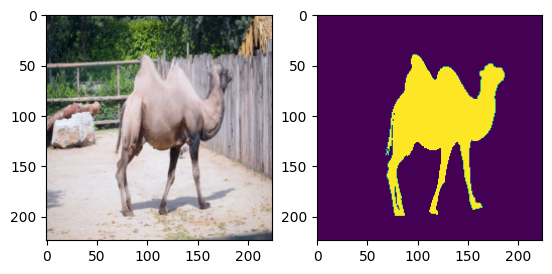

In [161]:
video_idx = 6
video_img_dataset = OneVideoImageDataset(
    val_rawset.data_set[video_idx],
)
video_img_loader = DataLoader(
    video_img_dataset,
    batch_size=1,
    shuffle=False,
)
img, mask = next(iter(video_img_loader))
plt.figure()
plt.subplot(1, 2, 1)
plt.imshow(normalize(img[0].permute(1, 2, 0)))
plt.subplot(1, 2, 2)
plt.imshow(mask[0])
plt.show()

In [108]:
loss_dict = {}
dif_iou_dict = {}
epoch_num = 50
iou_eval_period = 5
ras_loss = RasLoss().cuda()
model = DeformLearnImage().cuda()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [109]:
for e in range(epoch_num):
    mean_loss = 0
    model.train()
    for img, mask in tqdm(video_img_loader):
        optimizer.zero_grad()
        pred_boundary = model(img.cuda(), mask.cuda())
        loss = 0
        for i in range(len(pred_boundary)):
            loss += ras_loss(pred_boundary[i], mask.cuda())
        loss /= len(pred_boundary)
        loss.backward()
        optimizer.step()
        mean_loss += loss.item()
    mean_loss /= len(video_img_loader)
    print(f"Epoch {e}, Loss: {mean_loss}")
    loss_dict[e] = mean_loss
    if e % iou_eval_period == 0 or e == epoch_num - 1:
        model.eval()
        mean_iou = 0
        for img, mask in tqdm(video_img_loader):
            pred_boundary = model(img.cuda(), mask.cuda())
            iou = get_bou_iou(
                0,
                pred_boundary,
                mask.cuda(),
                gt_rasterizer,
            )
            mean_iou += iou.item()
        mean_iou /= len(video_img_loader)
        print(f"Epoch {e}, IoU: {mean_iou}")
        dif_iou_dict[e] = mean_iou
    

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.98it/s]


Epoch 0, Loss: 0.20881527894073063


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.24it/s]


Epoch 0, IoU: 0.5917096906238132


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 1, Loss: 0.19608855843544007


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 2, Loss: 0.18679169797235065


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.91it/s]


Epoch 3, Loss: 0.1716995757487085


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.99it/s]


Epoch 4, Loss: 0.17625783764653735


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 5, Loss: 0.1711240469581551


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.14it/s]


Epoch 5, IoU: 0.7144837207264371


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 6, Loss: 0.16178854314817323


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 7, Loss: 0.16032634849349658


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.00it/s]


Epoch 8, Loss: 0.16151768979099063


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 9, Loss: 0.16134498508440123


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 10, Loss: 0.16015621133976513


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.27it/s]


Epoch 10, IoU: 0.7529141505559286


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.00it/s]


Epoch 11, Loss: 0.15647189716498058


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 12, Loss: 0.15398538145754073


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 13, Loss: 0.1482157321439849


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.00it/s]


Epoch 14, Loss: 0.14501907353599866


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 15, Loss: 0.1450660383535756


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.24it/s]


Epoch 15, IoU: 0.7729631000094943


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 16, Loss: 0.14539650562736722


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 17, Loss: 0.14750297516584396


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 18, Loss: 0.14843475396434466


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.00it/s]


Epoch 19, Loss: 0.14452849295404221


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.97it/s]


Epoch 20, Loss: 0.14037067807383008


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.23it/s]


Epoch 20, IoU: 0.7542636262045966


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.00it/s]


Epoch 21, Loss: 0.14103541125853855


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.98it/s]


Epoch 22, Loss: 0.1389394192232026


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 23, Loss: 0.1378462105989456


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.47it/s]


Epoch 24, Loss: 0.14701079212956958


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:17<00:00,  5.24it/s]


Epoch 25, Loss: 0.1435483631160524


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.21it/s]


Epoch 25, IoU: 0.7821146170298259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.54it/s]


Epoch 26, Loss: 0.14104136327902475


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:25<00:00,  3.59it/s]


Epoch 27, Loss: 0.13993242118093702


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:26<00:00,  3.35it/s]


Epoch 28, Loss: 0.13646222857965362


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.29it/s]


Epoch 29, Loss: 0.1361586808330483


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.28it/s]


Epoch 30, Loss: 0.1366031986971696


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.64it/s]


Epoch 30, IoU: 0.785141255458196


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:26<00:00,  3.36it/s]


Epoch 31, Loss: 0.13502587038609717


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.27it/s]


Epoch 32, Loss: 0.13622334351142248


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.29it/s]


Epoch 33, Loss: 0.13413977126280466


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:28<00:00,  3.21it/s]


Epoch 34, Loss: 0.13768732870618502


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.29it/s]


Epoch 35, Loss: 0.13512972485687996


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.48it/s]


Epoch 35, IoU: 0.7472995864020453


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.22it/s]


Epoch 36, Loss: 0.13612442397409016


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:28<00:00,  3.21it/s]


Epoch 37, Loss: 0.13829814303252433


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.24it/s]


Epoch 38, Loss: 0.13676740361584558


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.22it/s]


Epoch 39, Loss: 0.1362273211280505


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.21it/s]


Epoch 40, Loss: 0.13421841454174782


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.44it/s]


Epoch 40, IoU: 0.8091637048456404


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.32it/s]


Epoch 41, Loss: 0.13569834902882577


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:28<00:00,  3.21it/s]


Epoch 42, Loss: 0.13424281842178767


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.22it/s]


Epoch 43, Loss: 0.13340853999058405


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.22it/s]


Epoch 44, Loss: 0.13325658730334705


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.24it/s]


Epoch 45, Loss: 0.1310604783395926


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.46it/s]


Epoch 45, IoU: 0.836861479944653


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.24it/s]


Epoch 46, Loss: 0.13026447263028887


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:28<00:00,  3.21it/s]


Epoch 47, Loss: 0.1316221337351534


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:27<00:00,  3.22it/s]


Epoch 48, Loss: 0.12991024139854643


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:28<00:00,  3.21it/s]

Epoch 49, Loss: 0.13246996502081554


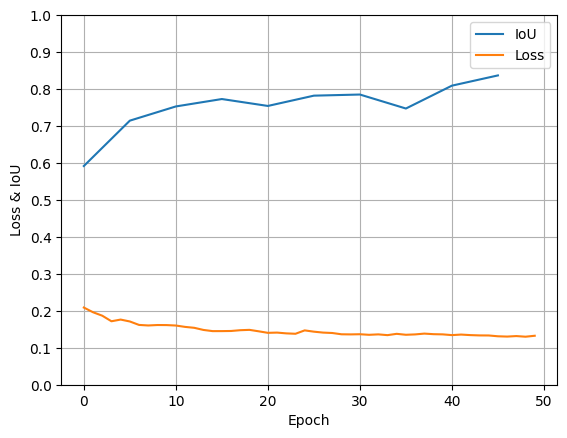

In [163]:
# show iou and loss
plt.figure()
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

In [177]:
len(video_img_dataset.video_set)

90

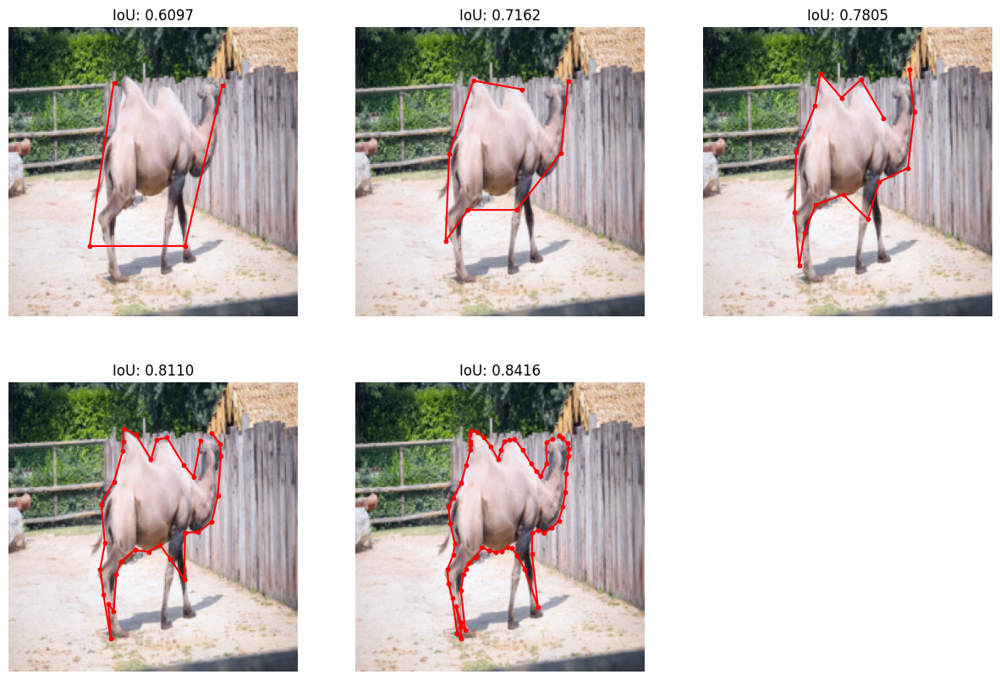

In [182]:
img, mask = video_img_dataset.video_set[25]
img = img.unsqueeze(0)
mask = mask.unsqueeze(0)
# show the result of one image
pred_boundary = model(img.cuda(), mask.cuda())
show_one_image_result(img.cuda(), mask.cuda(), pred_boundary, gt_rasterizer)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 0, Loss: 0.10969036208783708


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.21it/s]


Epoch 0, IoU: 0.802184910309024


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 1, Loss: 0.10387831426611761


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 2, Loss: 0.09920459758581185


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.97it/s]


Epoch 3, Loss: 0.09242210073805437


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 4, Loss: 0.0884921908742044


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 5, Loss: 0.08472423546197938


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.18it/s]


Epoch 5, IoU: 0.8664908445462948


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 6, Loss: 0.08365736674608254


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 7, Loss: 0.08086295235084325


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 8, Loss: 0.07895115126923817


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 9, Loss: 0.0774220945086421


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 10, Loss: 0.07647614090180979


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.19it/s]


Epoch 10, IoU: 0.9009999262123574


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 11, Loss: 0.07600574090895129


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 12, Loss: 0.07498860086609678


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 13, Loss: 0.07551132142543793


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 14, Loss: 0.07474236358411429


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 15, Loss: 0.07534873172095637


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.16it/s]


Epoch 15, IoU: 0.9095610641851658


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 16, Loss: 0.07252508947035162


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 17, Loss: 0.07094289893965895


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 18, Loss: 0.07016122391129412


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 19, Loss: 0.07162219426799112


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 20, Loss: 0.06967593175245494


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.15it/s]


Epoch 20, IoU: 0.9046059003690394


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.99it/s]


Epoch 21, Loss: 0.06975313771243502


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 22, Loss: 0.06689219903655169


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 23, Loss: 0.06726897085403524


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 24, Loss: 0.06652555678312372


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 25, Loss: 0.0676009360609985


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.20it/s]


Epoch 25, IoU: 0.9157190998879875


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 26, Loss: 0.06721853278577328


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 27, Loss: 0.06695917852949805


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 28, Loss: 0.06778829422120641


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 29, Loss: 0.06657325299229563


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 30, Loss: 0.0667941098714747


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.15it/s]


Epoch 30, IoU: 0.8933090145994977


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.98it/s]


Epoch 31, Loss: 0.0661501938522589


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 32, Loss: 0.06512377892689007


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 33, Loss: 0.06574695680017878


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.00it/s]


Epoch 34, Loss: 0.0656533023206199


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 35, Loss: 0.06503788949694575


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.22it/s]


Epoch 35, IoU: 0.9237833481009413


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 36, Loss: 0.06561529350171728


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 37, Loss: 0.06598340660878797


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 38, Loss: 0.06558014302537209


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 39, Loss: 0.06622956138921947


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 40, Loss: 0.06562907471344238


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.25it/s]


Epoch 40, IoU: 0.9295839892654885


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 41, Loss: 0.06481665327418142


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.04it/s]


Epoch 42, Loss: 0.06465256554869617


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.03it/s]


Epoch 43, Loss: 0.06470857942249716


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.03it/s]


Epoch 44, Loss: 0.06500874005439805


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.02it/s]


Epoch 45, Loss: 0.0643898864253992


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.22it/s]


Epoch 45, IoU: 0.939371546594108


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 46, Loss: 0.06325975482965387


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 47, Loss: 0.06287499330937862


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 48, Loss: 0.06414707859114903


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  7.01it/s]


Epoch 49, Loss: 0.06458732899187541


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.16it/s]


Epoch 49, IoU: 0.9310140580665774


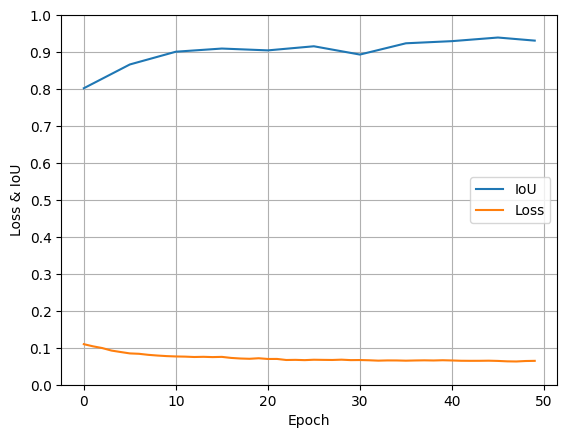

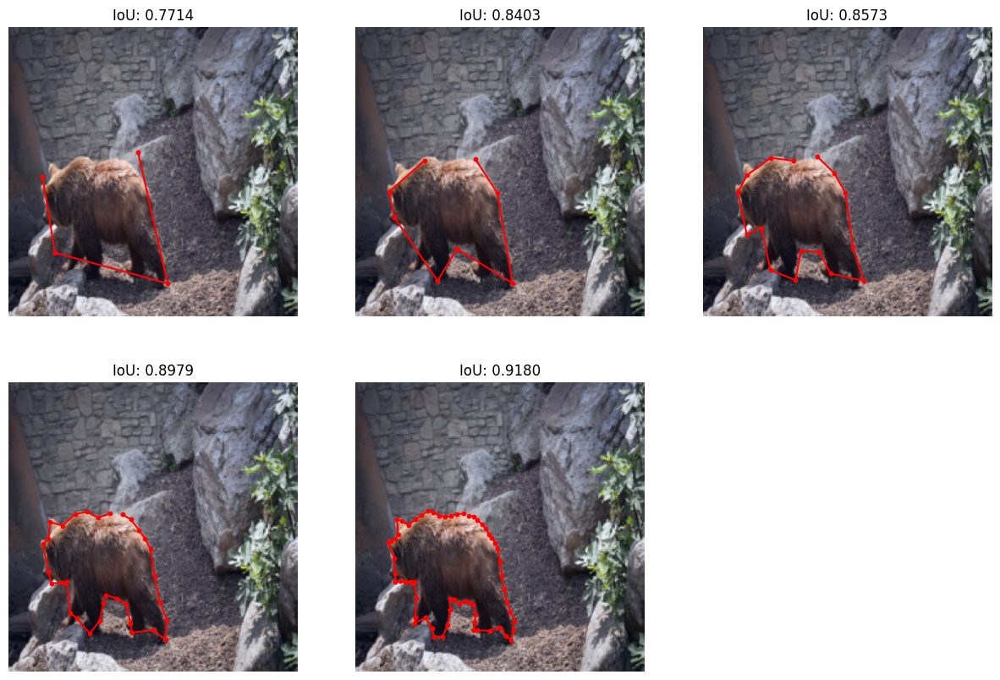

In [320]:
def overfit_one_video_img(
    video_set: list,
    model: nn.Module,
    epoch_num=50,
) -> tuple[dict, dict]:
    video_img_dataset = OneVideoImageDataset(video_set)
    video_img_loader = DataLoader(
        video_img_dataset,
        batch_size=1,
        shuffle=False,
    )
    loss_dict = {}
    iou_dict = {}
    iou_eval_period = 5
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    for e in range(epoch_num):
        model.train()
        mean_loss = 0
        for img, mask in tqdm(video_img_loader):
            optimizer.zero_grad()
            pred_boundary = model(img.cuda(), mask.cuda())
            loss = 0
            for i in range(len(pred_boundary)):
                loss += ras_loss(pred_boundary[i], mask.cuda())
            loss /= len(pred_boundary)
            loss.backward()
            optimizer.step()
            mean_loss += loss.item()
        mean_loss /= len(video_img_loader)
        print(f"Epoch {e}, Loss: {mean_loss}")
        loss_dict[e] = mean_loss
        if e % iou_eval_period == 0 or e == epoch_num - 1:
            model.eval()
            mean_iou = 0
            for img, mask in tqdm(video_img_loader):
                pred_boundary = model(img.cuda(), mask.cuda())
                iou = get_bou_iou(
                    0,
                    pred_boundary,
                    mask.cuda(),
                    gt_rasterizer,
                )
                mean_iou += iou.item()
            mean_iou /= len(video_img_loader)
            print(f"Epoch {e}, IoU: {mean_iou}")
            iou_dict[e] = mean_iou
    # show iou and loss
    plt.figure()
    plt.plot(list(iou_dict.keys()), list(iou_dict.values()), label="IoU")
    plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
    plt.legend()
    plt.xlabel("Epoch")
    plt.ylabel("Loss & IoU")
    plt.grid()
    plt.yticks(np.arange(0, 1.1, 0.1))
    plt.show()
    # show the result of one image
    model.train()
    img, mask = next(iter(video_img_loader))
    pred_boundary = model(img.cuda(), mask.cuda())
    show_one_image_result(
        img.cuda(),
        mask.cuda(),
        pred_boundary,
        gt_rasterizer,
    )
    return loss_dict, iou_dict
model = DeformLearnImage().cuda()
video_set = train_rawset.data_set[0]
loss_dict, dif_iou_dict = overfit_one_video_img(video_set, model)

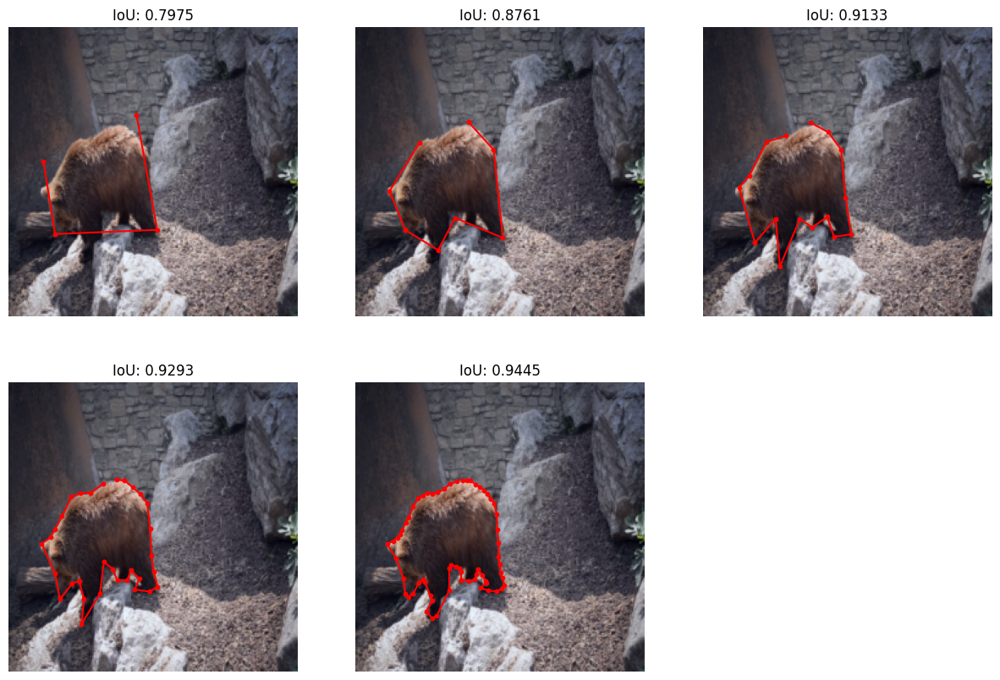

In [327]:
def test_one_image(model: nn.Module, video_set:list, index: int):
    img, mask = video_set[index]
    img = img.unsqueeze(0)
    mask = mask.unsqueeze(0)
    model.train()
    pred_boundary = model(img.cuda(), mask.cuda())
    show_one_image_result(img.cuda(), mask.cuda(), pred_boundary, gt_rasterizer)
test_one_image(model, video_set, 75)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main
100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 0, Dif Loss: 0.1143, Std Loss: 0.0075, Total Loss: 0.1219


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.32it/s]


Epoch 0, IoU: 0.7814904771200041


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.95it/s]


Epoch 1, Dif Loss: 0.1078, Std Loss: 0.0072, Total Loss: 0.1149


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 2, Dif Loss: 0.1020, Std Loss: 0.0072, Total Loss: 0.1092


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.95it/s]


Epoch 3, Dif Loss: 0.0965, Std Loss: 0.0077, Total Loss: 0.1042


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.95it/s]


Epoch 4, Dif Loss: 0.0931, Std Loss: 0.0085, Total Loss: 0.1016


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 5, Dif Loss: 0.0891, Std Loss: 0.0088, Total Loss: 0.0978


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.31it/s]


Epoch 5, IoU: 0.8746073522218843


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.95it/s]


Epoch 6, Dif Loss: 0.0881, Std Loss: 0.0091, Total Loss: 0.0972


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 7, Dif Loss: 0.0877, Std Loss: 0.0096, Total Loss: 0.0973


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 8, Dif Loss: 0.0887, Std Loss: 0.0088, Total Loss: 0.0975


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 9, Dif Loss: 0.0859, Std Loss: 0.0093, Total Loss: 0.0953


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 10, Dif Loss: 0.0861, Std Loss: 0.0090, Total Loss: 0.0951


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.29it/s]


Epoch 10, IoU: 0.8905258905596849


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 11, Dif Loss: 0.0844, Std Loss: 0.0087, Total Loss: 0.0930


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 12, Dif Loss: 0.0845, Std Loss: 0.0083, Total Loss: 0.0928


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 13, Dif Loss: 0.0825, Std Loss: 0.0080, Total Loss: 0.0906


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 14, Dif Loss: 0.0829, Std Loss: 0.0079, Total Loss: 0.0908


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 15, Dif Loss: 0.0825, Std Loss: 0.0080, Total Loss: 0.0906


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.27it/s]


Epoch 15, IoU: 0.893697631068346


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 16, Dif Loss: 0.0819, Std Loss: 0.0087, Total Loss: 0.0906


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 17, Dif Loss: 0.0811, Std Loss: 0.0081, Total Loss: 0.0892


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 18, Dif Loss: 0.0809, Std Loss: 0.0078, Total Loss: 0.0887


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 19, Dif Loss: 0.0804, Std Loss: 0.0082, Total Loss: 0.0886


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 20, Dif Loss: 0.0800, Std Loss: 0.0075, Total Loss: 0.0875


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.22it/s]


Epoch 20, IoU: 0.912708910500131


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 21, Dif Loss: 0.0788, Std Loss: 0.0077, Total Loss: 0.0864


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 22, Dif Loss: 0.0788, Std Loss: 0.0075, Total Loss: 0.0863


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 23, Dif Loss: 0.0781, Std Loss: 0.0077, Total Loss: 0.0858


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 24, Dif Loss: 0.0770, Std Loss: 0.0077, Total Loss: 0.0847


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 25, Dif Loss: 0.0769, Std Loss: 0.0078, Total Loss: 0.0848


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.21it/s]


Epoch 25, IoU: 0.9132005216144934


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 26, Dif Loss: 0.0768, Std Loss: 0.0077, Total Loss: 0.0845


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.90it/s]


Epoch 27, Dif Loss: 0.0768, Std Loss: 0.0079, Total Loss: 0.0846


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.90it/s]


Epoch 28, Dif Loss: 0.0776, Std Loss: 0.0076, Total Loss: 0.0852


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 29, Dif Loss: 0.0774, Std Loss: 0.0079, Total Loss: 0.0852


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.90it/s]


Epoch 30, Dif Loss: 0.0759, Std Loss: 0.0084, Total Loss: 0.0843


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.26it/s]


Epoch 30, IoU: 0.9034507187401376


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 31, Dif Loss: 0.0757, Std Loss: 0.0074, Total Loss: 0.0831


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 32, Dif Loss: 0.0763, Std Loss: 0.0076, Total Loss: 0.0839


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.91it/s]


Epoch 33, Dif Loss: 0.0759, Std Loss: 0.0077, Total Loss: 0.0836


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 34, Dif Loss: 0.0761, Std Loss: 0.0079, Total Loss: 0.0840


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 35, Dif Loss: 0.0762, Std Loss: 0.0081, Total Loss: 0.0843


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.29it/s]


Epoch 35, IoU: 0.9217399227909926


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 36, Dif Loss: 0.0761, Std Loss: 0.0077, Total Loss: 0.0837


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 37, Dif Loss: 0.0761, Std Loss: 0.0072, Total Loss: 0.0834


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 38, Dif Loss: 0.0759, Std Loss: 0.0075, Total Loss: 0.0833


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 39, Dif Loss: 0.0767, Std Loss: 0.0081, Total Loss: 0.0848


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.94it/s]


Epoch 40, Dif Loss: 0.0757, Std Loss: 0.0082, Total Loss: 0.0839


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.24it/s]


Epoch 40, IoU: 0.9215542652258059


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 41, Dif Loss: 0.0761, Std Loss: 0.0078, Total Loss: 0.0839


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 42, Dif Loss: 0.0770, Std Loss: 0.0084, Total Loss: 0.0854


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 43, Dif Loss: 0.0756, Std Loss: 0.0084, Total Loss: 0.0840


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 44, Dif Loss: 0.0759, Std Loss: 0.0088, Total Loss: 0.0847


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.92it/s]


Epoch 45, Dif Loss: 0.0756, Std Loss: 0.0079, Total Loss: 0.0835


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:05<00:00, 14.25it/s]


Epoch 45, IoU: 0.9233837549279376


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 46, Dif Loss: 0.0752, Std Loss: 0.0075, Total Loss: 0.0827


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:11<00:00,  6.93it/s]


Epoch 47, Dif Loss: 0.0750, Std Loss: 0.0078, Total Loss: 0.0829


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:12<00:00,  6.54it/s]


Epoch 48, Dif Loss: 0.0747, Std Loss: 0.0079, Total Loss: 0.0826


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:17<00:00,  4.60it/s]


Epoch 49, Dif Loss: 0.0744, Std Loss: 0.0074, Total Loss: 0.0819


100%|███████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:08<00:00,  9.58it/s]


Epoch 49, IoU: 0.9232160463565733


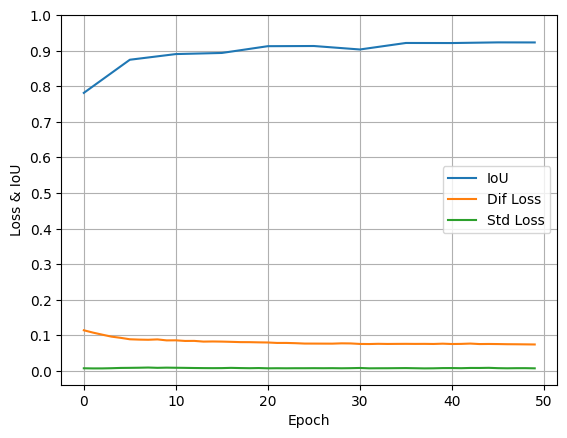

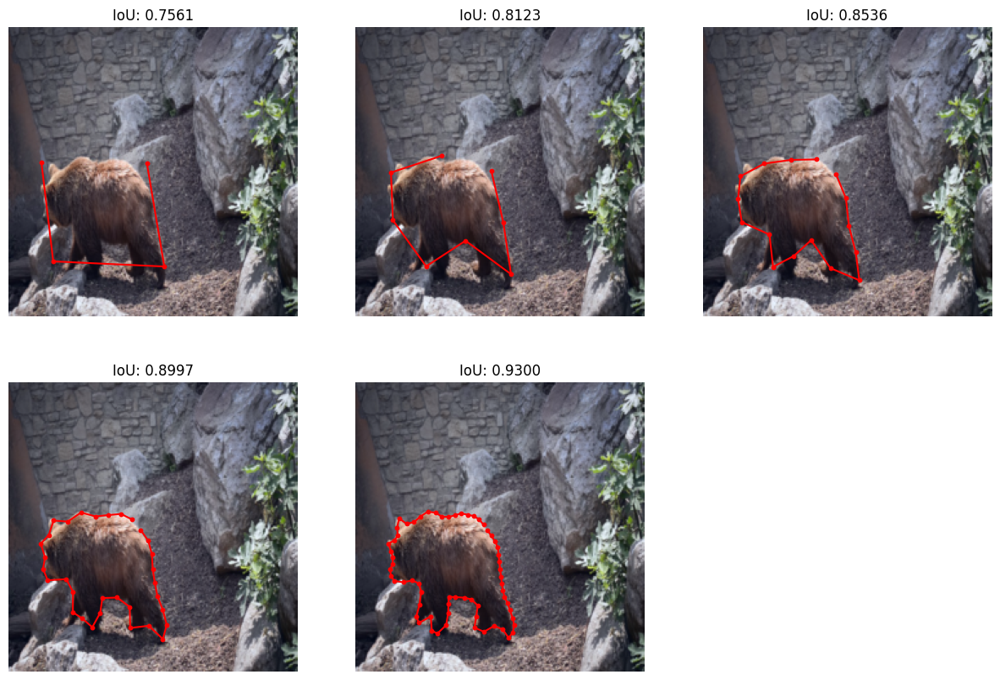

In [341]:
def over_one_video_img_with_deviation_loss(
    video_set: list,
    model: nn.Module,
    epoch_num=50,
):
    video_img_dataset = OneVideoImageDataset(video_set)
    video_img_loader = DataLoader(
        video_img_dataset,
        batch_size=1,
        shuffle=False,
    )
    dif_loss_dict = {}
    std_loss_dict = {}
    iou_dict = {}
    iou_eval_period = 5
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    for e in range(epoch_num):
        model.train()
        mean_dif_loss = 0
        mean_std_loss = 0
        mean_total_loss = 0
        for img, mask in tqdm(video_img_loader):
            optimizer.zero_grad()
            pred_boundary = model(img.cuda(), mask.cuda())
            dif_loss = 0
            std_loss = 0
            for i in range(len(pred_boundary)):
                dif_loss += ras_loss(pred_boundary[i], mask.cuda())
                std_loss += deviation_loss(pred_boundary[i])
            dif_loss /= len(pred_boundary)
            std_loss /= len(pred_boundary)
            total_loss = dif_loss + std_loss
            total_loss.backward()
            optimizer.step()
            mean_dif_loss += dif_loss.item()
            mean_std_loss += std_loss.item()
            mean_total_loss += total_loss.item()
        mean_dif_loss /= len(video_img_loader)
        mean_std_loss /= len(video_img_loader)
        mean_total_loss /= len(video_img_loader)
        print(f"Epoch {e}, Dif Loss: {mean_dif_loss:.4f}, Std Loss: {mean_std_loss:.4f}, Total Loss: {mean_total_loss:.4f}")
        dif_loss_dict[e] = mean_dif_loss
        std_loss_dict[e] = mean_std_loss
        if e % iou_eval_period == 0 or e == epoch_num - 1:
            model.eval()
            mean_iou = 0
            for img, mask in tqdm(video_img_loader):
                pred_boundary = model(img.cuda(), mask.cuda())
                iou = get_bou_iou(
                    0,
                    pred_boundary,
                    mask.cuda(),
                    gt_rasterizer,
                )
                mean_iou += iou.item()
            mean_iou /= len(video_img_loader)
            print(f"Epoch {e}, IoU: {mean_iou}")
            iou_dict[e] = mean_iou
    # show iou and loss
    plt.figure()
    plt.plot(list(iou_dict.keys()), list(iou_dict.values()), label="IoU")
    plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
    plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
    plt.legend()
    plt.xlabel("Epoch")
    plt.ylabel("Loss & IoU")
    plt.grid()
    plt.yticks(np.arange(0, 1.1, 0.1))
    plt.show()
    # show the result of one image
    model.train()
    img, mask = next(iter(video_img_loader))
    pred_boundary = model(img.cuda(), mask.cuda())
    show_one_image_result(
        img.cuda(),
        mask.cuda(),
        pred_boundary,
        gt_rasterizer,
    )
model = DeformLearnImage().cuda()
video_set = train_rawset.data_set[0]
over_one_video_img_with_deviation_loss(video_set, model)

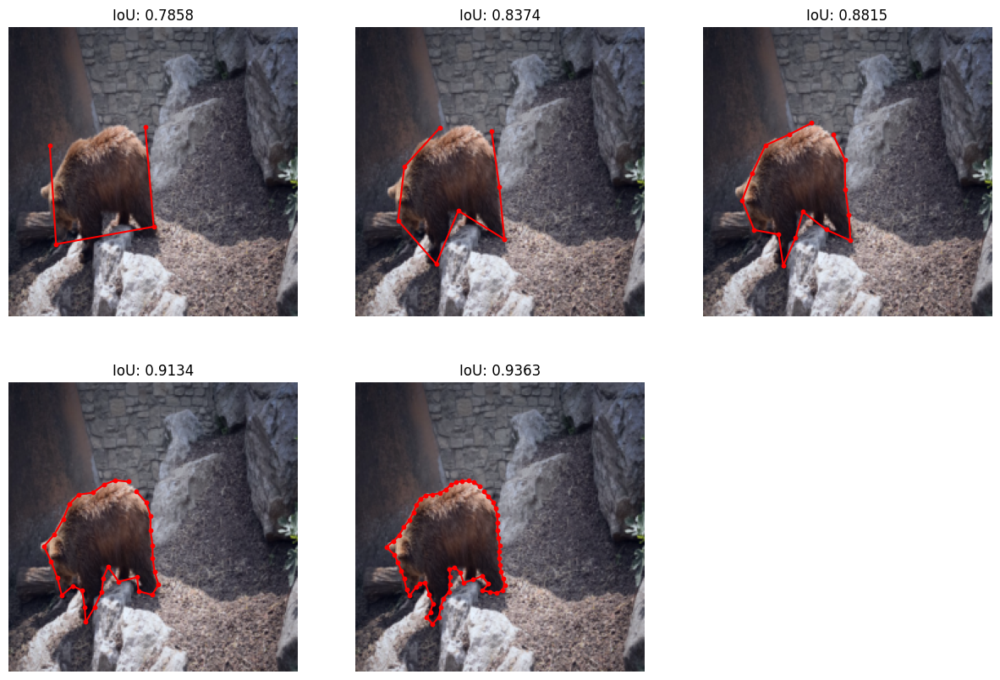

In [332]:
test_one_image(model, video_set, 75)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main
100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.76it/s]


Epoch 0, Loss: 0.20694911231597266


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.25it/s]


Epoch 0, IoU: 0.6108941932519277


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 1, Loss: 0.2002599393328031


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 2, Loss: 0.20022184484534794


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.00it/s]


Epoch 3, Loss: 0.1801779924167527


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 4, Loss: 0.17415395296282238


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.80it/s]


Epoch 5, Loss: 0.1730483074982961


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.00it/s]


Epoch 5, IoU: 0.7217700627115038


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 6, Loss: 0.17032868597242568


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 7, Loss: 0.17536830719974306


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 8, Loss: 0.16610033065080643


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 9, Loss: 0.15904515319400364


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 10, Loss: 0.16215574948324096


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.23it/s]


Epoch 10, IoU: 0.7861849314636654


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.04it/s]


Epoch 11, Loss: 0.15342196027437846


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.04it/s]


Epoch 12, Loss: 0.15271563935610982


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.05it/s]


Epoch 13, Loss: 0.15267170030209753


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.05it/s]


Epoch 14, Loss: 0.14991421807143424


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 15, Loss: 0.14901588790946538


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.26it/s]


Epoch 15, IoU: 0.7903117226229773


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.05it/s]


Epoch 16, Loss: 0.14661039354072677


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.05it/s]


Epoch 17, Loss: 0.14601677366428906


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.04it/s]


Epoch 18, Loss: 0.14311355236503814


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 19, Loss: 0.14098681352204748


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.05it/s]


Epoch 20, Loss: 0.13846846636798646


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.21it/s]


Epoch 20, IoU: 0.8044141021039751


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 21, Loss: 0.13978335385521254


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.04it/s]


Epoch 22, Loss: 0.13744152850574917


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 23, Loss: 0.1382191102537844


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 24, Loss: 0.13807324435975815


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 25, Loss: 0.1365083846780989


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.22it/s]


Epoch 25, IoU: 0.8123425801595052


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 26, Loss: 0.13494692237840758


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 27, Loss: 0.1372466329071257


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 28, Loss: 0.13655496198270056


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.78it/s]


Epoch 29, Loss: 0.13782304070062107


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 30, Loss: 0.13758548978302215


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.27it/s]


Epoch 30, IoU: 0.7577593604723613


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.80it/s]


Epoch 31, Loss: 0.13715288208590615


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.88it/s]


Epoch 32, Loss: 0.1409303746289677


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 33, Loss: 0.1373156135280927


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 34, Loss: 0.13387341904971334


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 35, Loss: 0.13227233158217536


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.16it/s]


Epoch 35, IoU: 0.8437117086516486


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 36, Loss: 0.13241606147752868


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 37, Loss: 0.13358822762966155


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 38, Loss: 0.13243116521173054


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 39, Loss: 0.1343520411186748


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.03it/s]


Epoch 40, Loss: 0.1327807886732949


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.20it/s]


Epoch 40, IoU: 0.8243834184275733


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.02it/s]


Epoch 41, Loss: 0.13480394904812176


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 42, Loss: 0.1320961628523138


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 43, Loss: 0.13423243943187926


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 44, Loss: 0.13299404225415654


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 45, Loss: 0.1329965347217189


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.18it/s]


Epoch 45, IoU: 0.8316167540020413


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 46, Loss: 0.1307917600704564


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.01it/s]


Epoch 47, Loss: 0.13400313696927493


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.00it/s]


Epoch 48, Loss: 0.1333267569541931


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  7.00it/s]


Epoch 49, Loss: 0.1342533014714718


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.15it/s]


Epoch 49, IoU: 0.8047975023587545


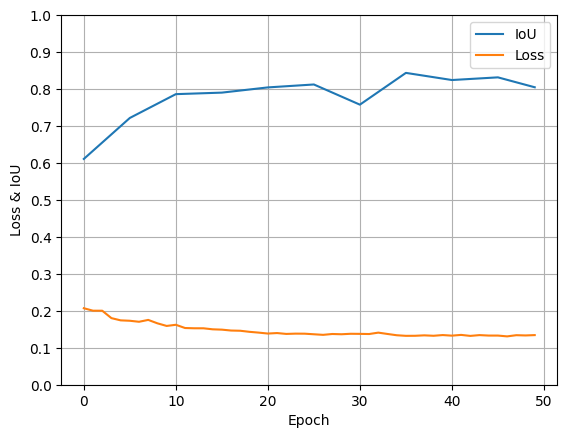

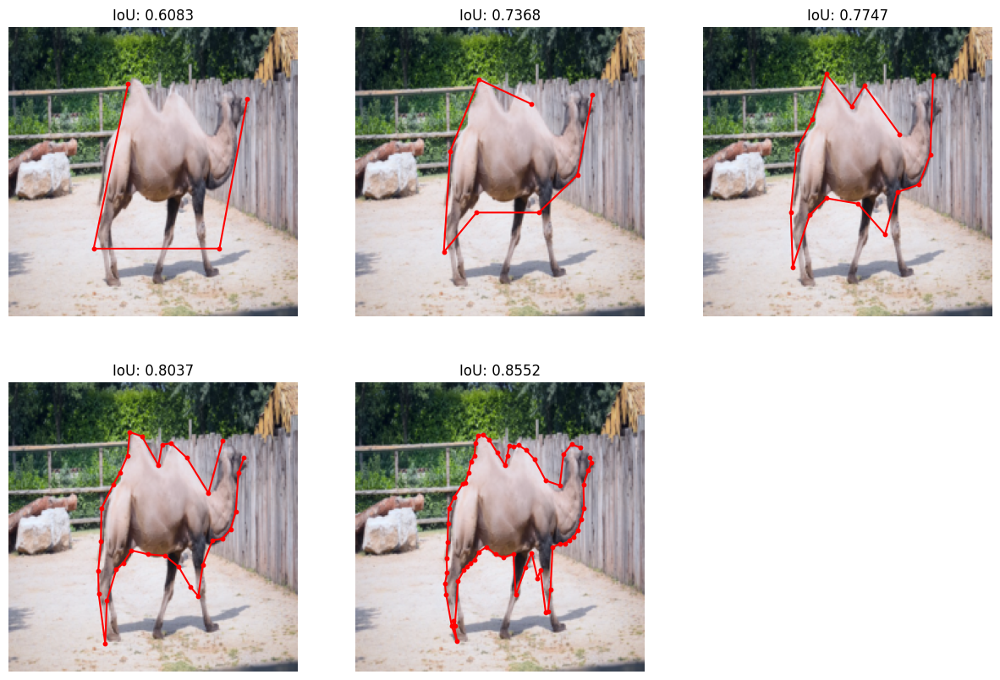

({0: 0.20694911231597266,
  1: 0.2002599393328031,
  2: 0.20022184484534794,
  3: 0.1801779924167527,
  4: 0.17415395296282238,
  5: 0.1730483074982961,
  6: 0.17032868597242568,
  7: 0.17536830719974306,
  8: 0.16610033065080643,
  9: 0.15904515319400364,
  10: 0.16215574948324096,
  11: 0.15342196027437846,
  12: 0.15271563935610982,
  13: 0.15267170030209753,
  14: 0.14991421807143424,
  15: 0.14901588790946538,
  16: 0.14661039354072677,
  17: 0.14601677366428906,
  18: 0.14311355236503814,
  19: 0.14098681352204748,
  20: 0.13846846636798646,
  21: 0.13978335385521254,
  22: 0.13744152850574917,
  23: 0.1382191102537844,
  24: 0.13807324435975815,
  25: 0.1365083846780989,
  26: 0.13494692237840758,
  27: 0.1372466329071257,
  28: 0.13655496198270056,
  29: 0.13782304070062107,
  30: 0.13758548978302215,
  31: 0.13715288208590615,
  32: 0.1409303746289677,
  33: 0.1373156135280927,
  34: 0.13387341904971334,
  35: 0.13227233158217536,
  36: 0.13241606147752868,
  37: 0.13358822762

In [333]:
model = DeformLearnImage().cuda()
video_set = val_rawset.data_set[6]
overfit_one_video_img(video_set, model)

In [334]:
len(video_set)

90

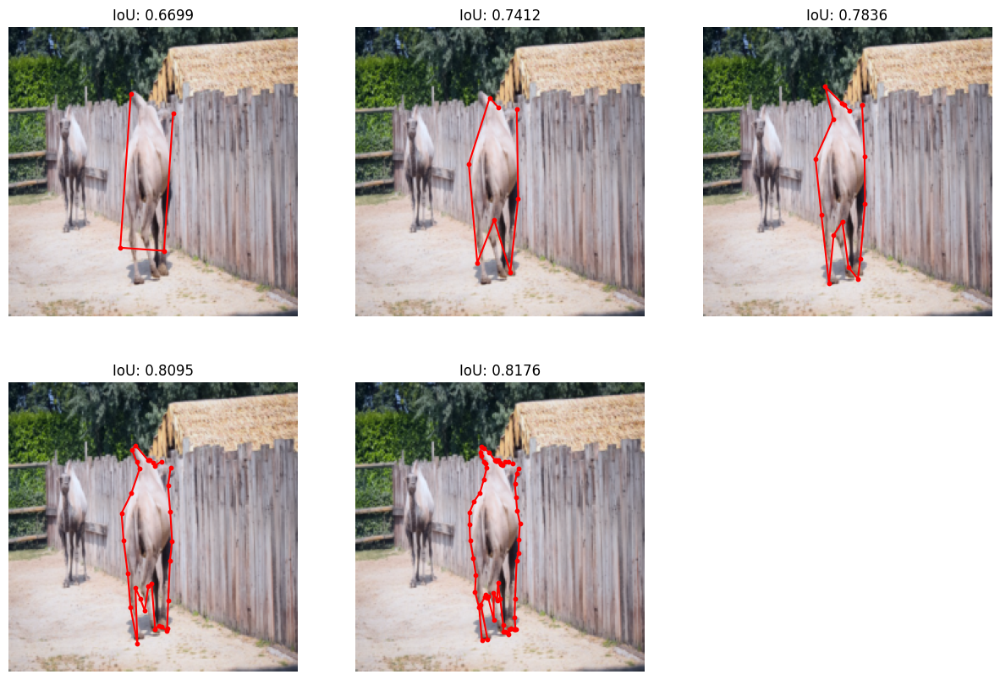

In [339]:
test_one_image(model, video_set, 89)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main
100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.63it/s]


Epoch 0, Dif Loss: 0.2129, Std Loss: 0.0356, Total Loss: 0.2485


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 13.47it/s]


Epoch 0, IoU: 0.6455519166257646


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.67it/s]


Epoch 1, Dif Loss: 0.2048, Std Loss: 0.0318, Total Loss: 0.2366


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.93it/s]


Epoch 2, Dif Loss: 0.1930, Std Loss: 0.0323, Total Loss: 0.2253


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.95it/s]


Epoch 3, Dif Loss: 0.1839, Std Loss: 0.0340, Total Loss: 0.2179


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 4, Dif Loss: 0.1813, Std Loss: 0.0337, Total Loss: 0.2150


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.93it/s]


Epoch 5, Dif Loss: 0.1843, Std Loss: 0.0334, Total Loss: 0.2177


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.33it/s]


Epoch 5, IoU: 0.7109940157996284


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.92it/s]


Epoch 6, Dif Loss: 0.1817, Std Loss: 0.0321, Total Loss: 0.2138


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.93it/s]


Epoch 7, Dif Loss: 0.1754, Std Loss: 0.0331, Total Loss: 0.2084


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.92it/s]


Epoch 8, Dif Loss: 0.1777, Std Loss: 0.0334, Total Loss: 0.2111


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.86it/s]


Epoch 9, Dif Loss: 0.1711, Std Loss: 0.0329, Total Loss: 0.2039


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 10, Dif Loss: 0.1694, Std Loss: 0.0327, Total Loss: 0.2021


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.33it/s]


Epoch 10, IoU: 0.7564678006701999


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.86it/s]


Epoch 11, Dif Loss: 0.1650, Std Loss: 0.0333, Total Loss: 0.1983


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.78it/s]


Epoch 12, Dif Loss: 0.1643, Std Loss: 0.0326, Total Loss: 0.1970


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 13, Dif Loss: 0.1618, Std Loss: 0.0324, Total Loss: 0.1941


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.95it/s]


Epoch 14, Dif Loss: 0.1610, Std Loss: 0.0320, Total Loss: 0.1930


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.95it/s]


Epoch 15, Dif Loss: 0.1619, Std Loss: 0.0319, Total Loss: 0.1938


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.38it/s]


Epoch 15, IoU: 0.7404805123806


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 16, Dif Loss: 0.1609, Std Loss: 0.0324, Total Loss: 0.1933


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.95it/s]


Epoch 17, Dif Loss: 0.1595, Std Loss: 0.0325, Total Loss: 0.1920


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 18, Dif Loss: 0.1585, Std Loss: 0.0324, Total Loss: 0.1909


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.93it/s]


Epoch 19, Dif Loss: 0.1585, Std Loss: 0.0321, Total Loss: 0.1905


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 20, Dif Loss: 0.1544, Std Loss: 0.0322, Total Loss: 0.1866


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.34it/s]


Epoch 20, IoU: 0.7675235317813025


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 21, Dif Loss: 0.1560, Std Loss: 0.0319, Total Loss: 0.1879


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 22, Dif Loss: 0.1561, Std Loss: 0.0315, Total Loss: 0.1876


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 23, Dif Loss: 0.1528, Std Loss: 0.0330, Total Loss: 0.1858


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 24, Dif Loss: 0.1525, Std Loss: 0.0322, Total Loss: 0.1847


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 25, Dif Loss: 0.1538, Std Loss: 0.0324, Total Loss: 0.1862


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.38it/s]


Epoch 25, IoU: 0.7546818355719248


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.89it/s]


Epoch 26, Dif Loss: 0.1556, Std Loss: 0.0319, Total Loss: 0.1874


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 27, Dif Loss: 0.1526, Std Loss: 0.0319, Total Loss: 0.1844


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 28, Dif Loss: 0.1519, Std Loss: 0.0315, Total Loss: 0.1834


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.88it/s]


Epoch 29, Dif Loss: 0.1502, Std Loss: 0.0319, Total Loss: 0.1821


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 30, Dif Loss: 0.1507, Std Loss: 0.0312, Total Loss: 0.1820


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.37it/s]


Epoch 30, IoU: 0.7781727049085829


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 31, Dif Loss: 0.1481, Std Loss: 0.0324, Total Loss: 0.1805


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.92it/s]


Epoch 32, Dif Loss: 0.1513, Std Loss: 0.0313, Total Loss: 0.1827


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.91it/s]


Epoch 33, Dif Loss: 0.1492, Std Loss: 0.0317, Total Loss: 0.1809


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.90it/s]


Epoch 34, Dif Loss: 0.1478, Std Loss: 0.0317, Total Loss: 0.1795


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 35, Dif Loss: 0.1475, Std Loss: 0.0318, Total Loss: 0.1793


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.36it/s]


Epoch 35, IoU: 0.8125901573234134


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.86it/s]


Epoch 36, Dif Loss: 0.1454, Std Loss: 0.0309, Total Loss: 0.1763


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.84it/s]


Epoch 37, Dif Loss: 0.1460, Std Loss: 0.0314, Total Loss: 0.1774


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.85it/s]


Epoch 38, Dif Loss: 0.1450, Std Loss: 0.0310, Total Loss: 0.1760


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.85it/s]


Epoch 39, Dif Loss: 0.1464, Std Loss: 0.0314, Total Loss: 0.1778


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 40, Dif Loss: 0.1450, Std Loss: 0.0314, Total Loss: 0.1763


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.37it/s]


Epoch 40, IoU: 0.8055357999271817


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 41, Dif Loss: 0.1460, Std Loss: 0.0314, Total Loss: 0.1773


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.87it/s]


Epoch 42, Dif Loss: 0.1450, Std Loss: 0.0313, Total Loss: 0.1762


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.78it/s]


Epoch 43, Dif Loss: 0.1451, Std Loss: 0.0312, Total Loss: 0.1763


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.67it/s]


Epoch 44, Dif Loss: 0.1458, Std Loss: 0.0311, Total Loss: 0.1769


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.94it/s]


Epoch 45, Dif Loss: 0.1451, Std Loss: 0.0313, Total Loss: 0.1764


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.38it/s]


Epoch 45, IoU: 0.8040133694807688


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.72it/s]


Epoch 46, Dif Loss: 0.1453, Std Loss: 0.0310, Total Loss: 0.1763


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.68it/s]


Epoch 47, Dif Loss: 0.1441, Std Loss: 0.0310, Total Loss: 0.1751


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:13<00:00,  6.90it/s]


Epoch 48, Dif Loss: 0.1438, Std Loss: 0.0317, Total Loss: 0.1755


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:12<00:00,  6.93it/s]


Epoch 49, Dif Loss: 0.1433, Std Loss: 0.0310, Total Loss: 0.1743


100%|███████████████████████████████████████████████████████████████████████████████████████████| 90/90 [00:06<00:00, 14.32it/s]


Epoch 49, IoU: 0.8366537511348724


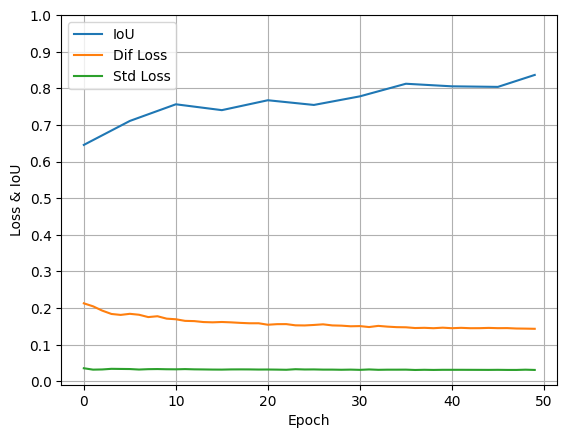

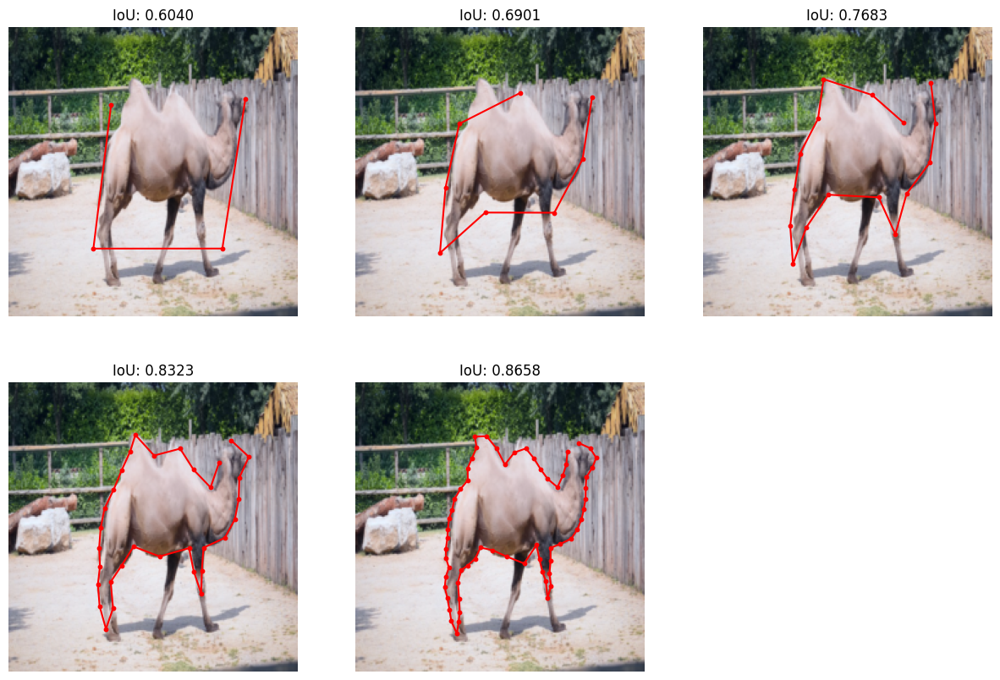

In [342]:
model = DeformLearnImage().cuda()
video_set = val_rawset.data_set[6]
over_one_video_img_with_deviation_loss(video_set, model)

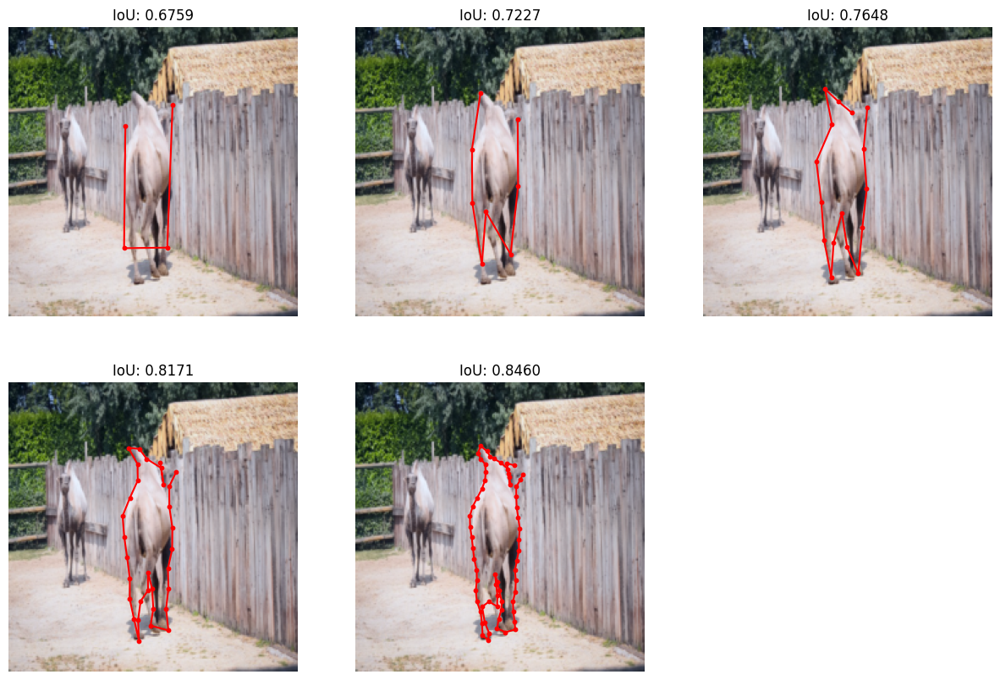

In [348]:
test_one_image(model, video_set, 89)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main
100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.02it/s]


Epoch 0, Loss: 0.23215193226933478


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.34it/s]


Epoch 0, IoU: 0.4313846545914809


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.05it/s]


Epoch 1, Loss: 0.2149383880198002


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 2, Loss: 0.2008507914841175


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 3, Loss: 0.1711644683033228


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 4, Loss: 0.15846635786195595


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 5, Loss: 0.15472861267626287


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.38it/s]


Epoch 5, IoU: 0.7516363978385925


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.06it/s]


Epoch 6, Loss: 0.14623980944355328


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.06it/s]


Epoch 7, Loss: 0.14314169697463514


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.06it/s]


Epoch 8, Loss: 0.13987040345867474


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 9, Loss: 0.13421046311656634


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 10, Loss: 0.13323652545611064


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.37it/s]


Epoch 10, IoU: 0.8048073748747507


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 11, Loss: 0.1332576684653759


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 12, Loss: 0.12860130270322165


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 13, Loss: 0.12372613636155923


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.08it/s]


Epoch 14, Loss: 0.12370861731469632


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 15, Loss: 0.12523072436451912


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.37it/s]


Epoch 15, IoU: 0.8122247656186422


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 16, Loss: 0.12367274376253287


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 17, Loss: 0.1244115283091863


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 18, Loss: 0.1259367883205414


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 19, Loss: 0.12120603385070959


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.06it/s]


Epoch 20, Loss: 0.12168929527203241


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.38it/s]


Epoch 20, IoU: 0.8223849316438039


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 21, Loss: 0.11640592825909456


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 22, Loss: 0.11240719296038151


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 23, Loss: 0.11033927177389463


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 24, Loss: 0.10716803272565206


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.05it/s]


Epoch 25, Loss: 0.10922198767463366


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.31it/s]


Epoch 25, IoU: 0.8393053750197093


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.06it/s]


Epoch 26, Loss: 0.11006493382155895


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 27, Loss: 0.11132795065641403


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.08it/s]


Epoch 28, Loss: 0.10979883372783661


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 29, Loss: 0.10934649184346198


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.04it/s]


Epoch 30, Loss: 0.11287073418498039


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.37it/s]


Epoch 30, IoU: 0.813037724296252


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.04it/s]


Epoch 31, Loss: 0.11218342234690984


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.04it/s]


Epoch 32, Loss: 0.1148727008452018


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.04it/s]


Epoch 33, Loss: 0.11054099351167679


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.04it/s]


Epoch 34, Loss: 0.10853498230377832


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 35, Loss: 0.10748772198955218


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 13.51it/s]


Epoch 35, IoU: 0.8484009583791097


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.81it/s]


Epoch 36, Loss: 0.1066764550904433


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.80it/s]


Epoch 37, Loss: 0.10859975243608157


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.82it/s]


Epoch 38, Loss: 0.10874381909767787


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.81it/s]


Epoch 39, Loss: 0.10580409777661165


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.81it/s]


Epoch 40, Loss: 0.11042298612495263


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 13.50it/s]


Epoch 40, IoU: 0.8380356321732203


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.81it/s]


Epoch 41, Loss: 0.10399306615193685


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.82it/s]


Epoch 42, Loss: 0.10335827072461447


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.96it/s]


Epoch 43, Loss: 0.10578583317498366


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.07it/s]


Epoch 44, Loss: 0.10351241789758206


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 45, Loss: 0.10081468435625235


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 13.48it/s]


Epoch 45, IoU: 0.8772402226924896


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.81it/s]


Epoch 46, Loss: 0.10115441642701625


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.82it/s]


Epoch 47, Loss: 0.1015673956523339


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.96it/s]


Epoch 48, Loss: 0.10624181454380353


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  7.06it/s]


Epoch 49, Loss: 0.1092080174634854


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.33it/s]


Epoch 49, IoU: 0.8529398103555044


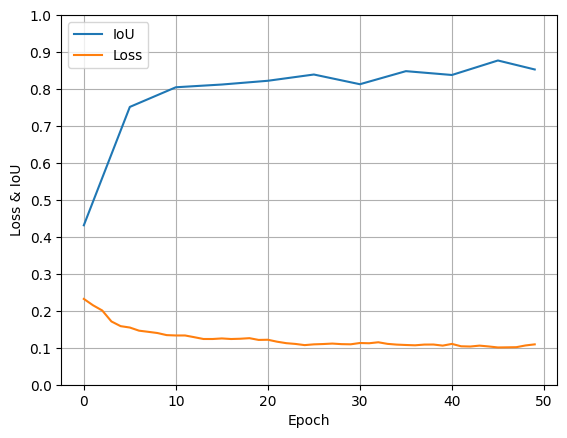

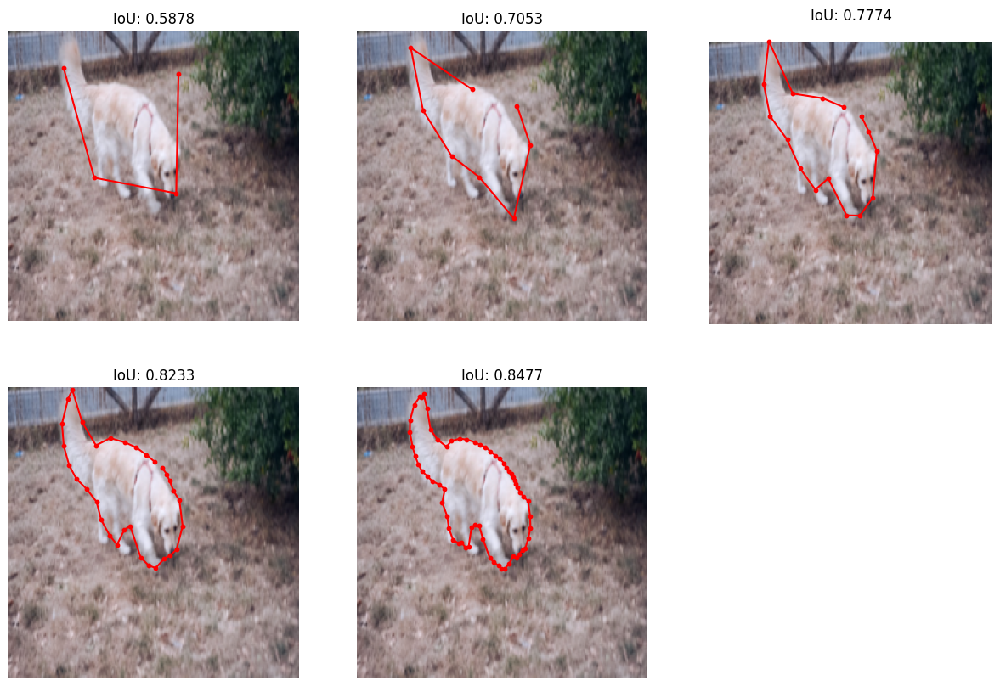

In [349]:
model = DeformLearnImage().cuda()
video_set = val_rawset.data_set[11]
overfit_one_video_img(video_set, model)
None

In [350]:
len(video_set)

60

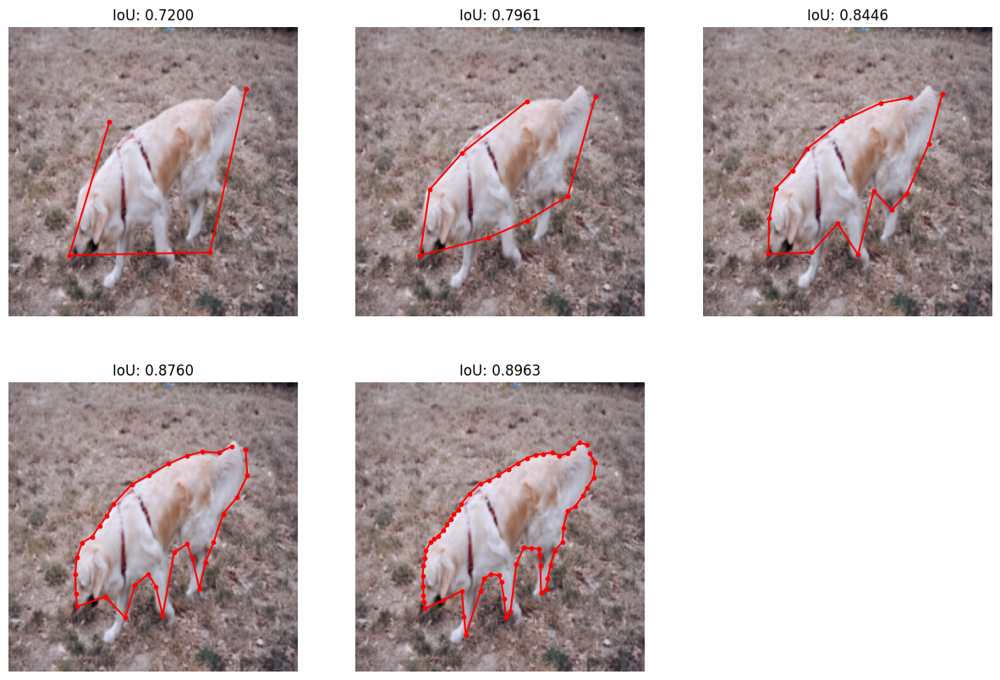

In [357]:
test_one_image(model, video_set, 59)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main
100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 0, Dif Loss: 0.2273, Std Loss: 0.0522, Total Loss: 0.2795


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.28it/s]


Epoch 0, IoU: 0.44459730237722395


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 1, Dif Loss: 0.2250, Std Loss: 0.0407, Total Loss: 0.2657


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.91it/s]


Epoch 2, Dif Loss: 0.1902, Std Loss: 0.0387, Total Loss: 0.2290


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 3, Dif Loss: 0.1736, Std Loss: 0.0396, Total Loss: 0.2132


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.91it/s]


Epoch 4, Dif Loss: 0.1578, Std Loss: 0.0385, Total Loss: 0.1964


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 5, Dif Loss: 0.1481, Std Loss: 0.0378, Total Loss: 0.1859


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.22it/s]


Epoch 5, IoU: 0.7853947073221207


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.88it/s]


Epoch 6, Dif Loss: 0.1437, Std Loss: 0.0374, Total Loss: 0.1811


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 7, Dif Loss: 0.1430, Std Loss: 0.0364, Total Loss: 0.1794


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 8, Dif Loss: 0.1403, Std Loss: 0.0378, Total Loss: 0.1780


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.88it/s]


Epoch 9, Dif Loss: 0.1513, Std Loss: 0.0359, Total Loss: 0.1872


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.88it/s]


Epoch 10, Dif Loss: 0.1433, Std Loss: 0.0354, Total Loss: 0.1786


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.18it/s]


Epoch 10, IoU: 0.7782104084889094


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.89it/s]


Epoch 11, Dif Loss: 0.1347, Std Loss: 0.0360, Total Loss: 0.1707


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.88it/s]


Epoch 12, Dif Loss: 0.1320, Std Loss: 0.0362, Total Loss: 0.1682


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 13, Dif Loss: 0.1378, Std Loss: 0.0351, Total Loss: 0.1729


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.88it/s]


Epoch 14, Dif Loss: 0.1369, Std Loss: 0.0360, Total Loss: 0.1729


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.91it/s]


Epoch 15, Dif Loss: 0.1350, Std Loss: 0.0357, Total Loss: 0.1707


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.28it/s]


Epoch 15, IoU: 0.831576868891716


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 16, Dif Loss: 0.1329, Std Loss: 0.0359, Total Loss: 0.1688


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 17, Dif Loss: 0.1327, Std Loss: 0.0357, Total Loss: 0.1684


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 18, Dif Loss: 0.1271, Std Loss: 0.0345, Total Loss: 0.1616


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.93it/s]


Epoch 19, Dif Loss: 0.1236, Std Loss: 0.0354, Total Loss: 0.1590


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 20, Dif Loss: 0.1270, Std Loss: 0.0358, Total Loss: 0.1628


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.29it/s]


Epoch 20, IoU: 0.8149749507506688


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 21, Dif Loss: 0.1280, Std Loss: 0.0367, Total Loss: 0.1646


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 22, Dif Loss: 0.1252, Std Loss: 0.0350, Total Loss: 0.1602


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 23, Dif Loss: 0.1205, Std Loss: 0.0346, Total Loss: 0.1551


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.91it/s]


Epoch 24, Dif Loss: 0.1208, Std Loss: 0.0350, Total Loss: 0.1558


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 25, Dif Loss: 0.1210, Std Loss: 0.0354, Total Loss: 0.1564


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.26it/s]


Epoch 25, IoU: 0.8252856185038885


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 26, Dif Loss: 0.1195, Std Loss: 0.0351, Total Loss: 0.1545


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.91it/s]


Epoch 27, Dif Loss: 0.1204, Std Loss: 0.0352, Total Loss: 0.1556


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.89it/s]


Epoch 28, Dif Loss: 0.1199, Std Loss: 0.0345, Total Loss: 0.1544


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.91it/s]


Epoch 29, Dif Loss: 0.1180, Std Loss: 0.0355, Total Loss: 0.1535


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.92it/s]


Epoch 30, Dif Loss: 0.1181, Std Loss: 0.0351, Total Loss: 0.1531


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.29it/s]


Epoch 30, IoU: 0.8556088934342067


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.89it/s]


Epoch 31, Dif Loss: 0.1187, Std Loss: 0.0342, Total Loss: 0.1529


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 32, Dif Loss: 0.1165, Std Loss: 0.0352, Total Loss: 0.1517


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.88it/s]


Epoch 33, Dif Loss: 0.1148, Std Loss: 0.0351, Total Loss: 0.1499


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.87it/s]


Epoch 34, Dif Loss: 0.1198, Std Loss: 0.0350, Total Loss: 0.1548


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.89it/s]


Epoch 35, Dif Loss: 0.1218, Std Loss: 0.0340, Total Loss: 0.1558


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.28it/s]


Epoch 35, IoU: 0.8436209966739019


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 36, Dif Loss: 0.1188, Std Loss: 0.0345, Total Loss: 0.1533


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 37, Dif Loss: 0.1152, Std Loss: 0.0355, Total Loss: 0.1507


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 38, Dif Loss: 0.1180, Std Loss: 0.0358, Total Loss: 0.1537


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 39, Dif Loss: 0.1179, Std Loss: 0.0353, Total Loss: 0.1532


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 40, Dif Loss: 0.1180, Std Loss: 0.0343, Total Loss: 0.1523


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.26it/s]


Epoch 40, IoU: 0.8571742594242096


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.89it/s]


Epoch 41, Dif Loss: 0.1157, Std Loss: 0.0351, Total Loss: 0.1508


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 42, Dif Loss: 0.1160, Std Loss: 0.0341, Total Loss: 0.1500


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.89it/s]


Epoch 43, Dif Loss: 0.1147, Std Loss: 0.0354, Total Loss: 0.1501


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.88it/s]


Epoch 44, Dif Loss: 0.1180, Std Loss: 0.0349, Total Loss: 0.1529


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.88it/s]


Epoch 45, Dif Loss: 0.1150, Std Loss: 0.0349, Total Loss: 0.1499


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.20it/s]


Epoch 45, IoU: 0.8476847797632218


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 46, Dif Loss: 0.1157, Std Loss: 0.0348, Total Loss: 0.1504


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.90it/s]


Epoch 47, Dif Loss: 0.1149, Std Loss: 0.0348, Total Loss: 0.1496


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.87it/s]


Epoch 48, Dif Loss: 0.1152, Std Loss: 0.0351, Total Loss: 0.1502


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:08<00:00,  6.83it/s]


Epoch 49, Dif Loss: 0.1132, Std Loss: 0.0356, Total Loss: 0.1487


100%|███████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:04<00:00, 14.27it/s]


Epoch 49, IoU: 0.8569782892862956


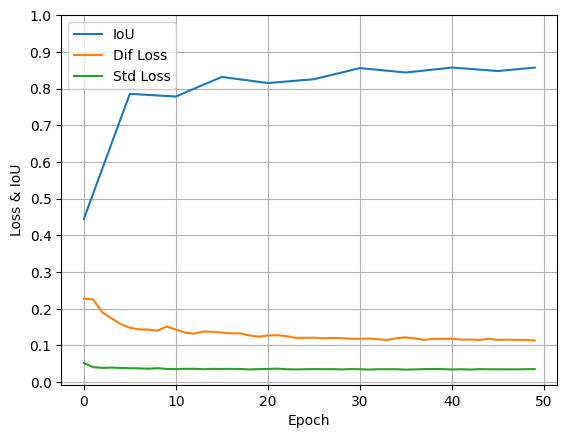

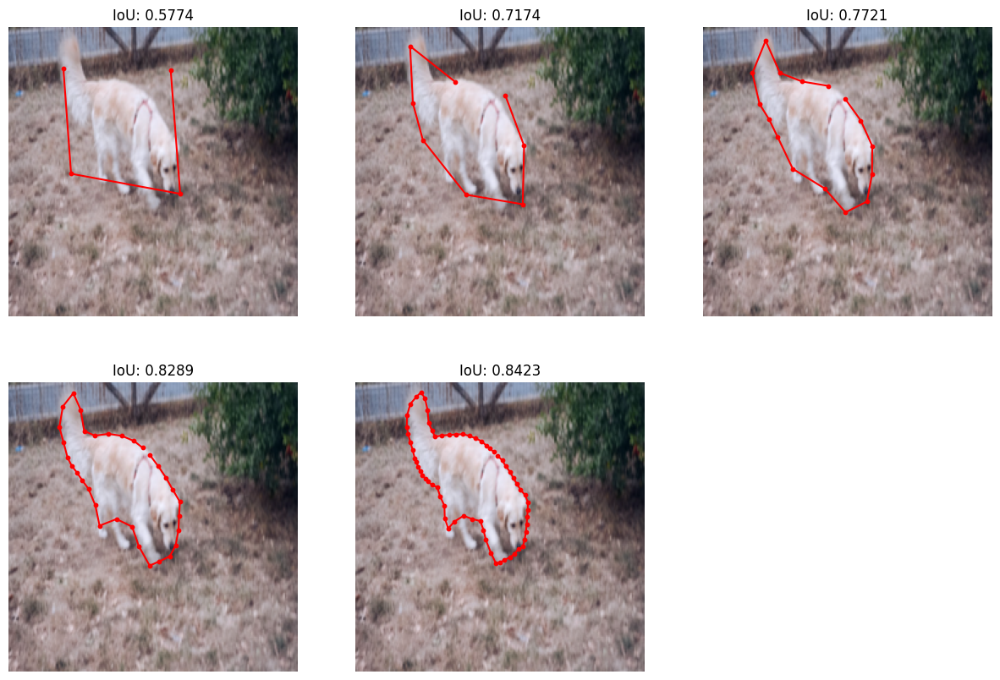

In [358]:
model = DeformLearnImage().cuda()
video_set = val_rawset.data_set[11]
over_one_video_img_with_deviation_loss(video_set, model)

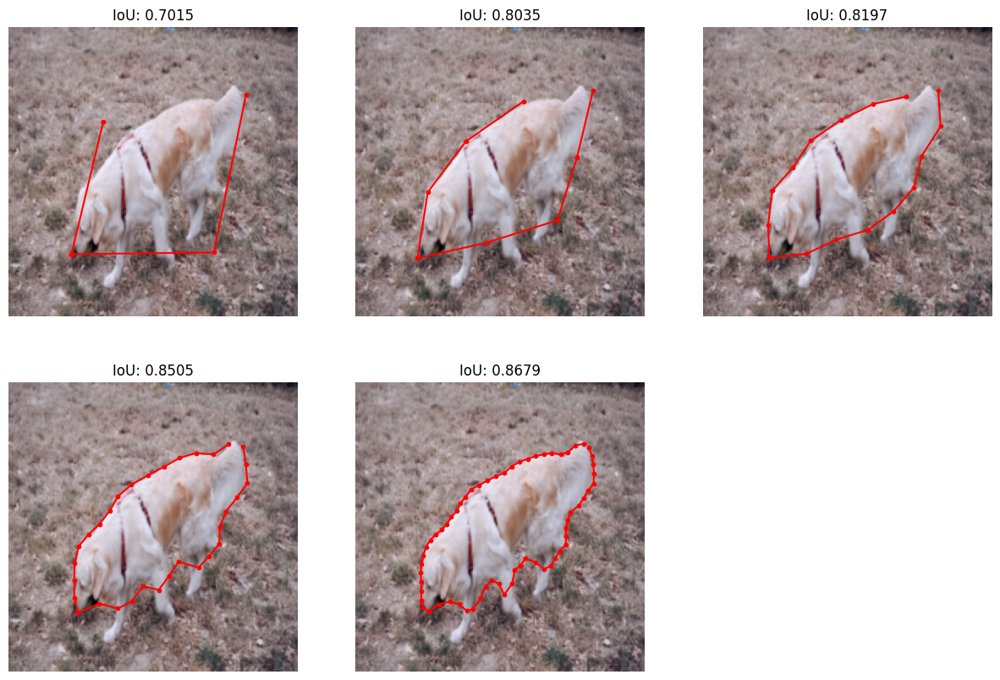

In [362]:
test_one_image(model, video_set, 59)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.2430039942264557, IoU: 0.5905690789222717
Epoch 1, Loss: 0.2082657814025879, IoU: 0.6735749840736389
Epoch 2, Loss: 0.17093555629253387, IoU: 0.7317448854446411
Epoch 3, Loss: 0.15341511368751526, IoU: 0.7534075379371643
Epoch 4, Loss: 0.13967040181159973, IoU: 0.7675819993019104
Epoch 5, Loss: 0.1371673196554184, IoU: 0.7542803287506104
Epoch 6, Loss: 0.1284644603729248, IoU: 0.7767188549041748
Epoch 7, Loss: 0.12301266193389893, IoU: 0.7836511731147766
Epoch 8, Loss: 0.11889863014221191, IoU: 0.7969544529914856
Epoch 9, Loss: 0.11240928620100021, IoU: 0.8174721598625183
Epoch 10, Loss: 0.11412046104669571, IoU: 0.8181595206260681
Epoch 11, Loss: 0.10928759723901749, IoU: 0.8299508690834045
Epoch 12, Loss: 0.10709027200937271, IoU: 0.836548388004303
Epoch 13, Loss: 0.10530358552932739, IoU: 0.8370976448059082
Epoch 14, Loss: 0.1035366803407669, IoU: 0.8353101015090942
Epoch 15, Loss: 0.10361100733280182, IoU: 0.8367972373962402
Epoch 16, Loss: 0.09853247553110123, IoU

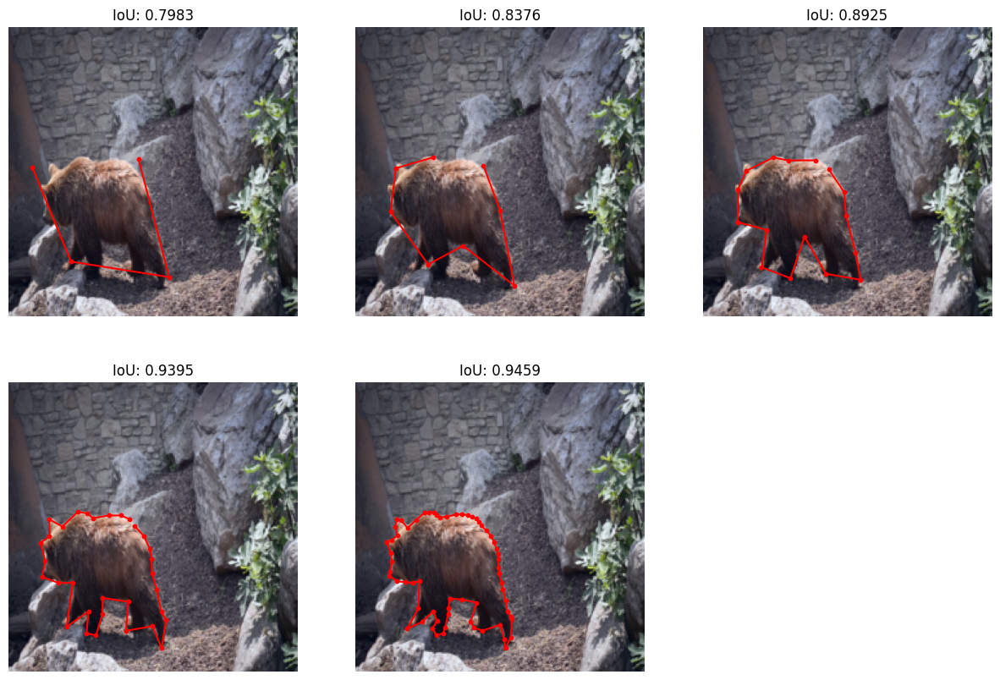

In [289]:
def overfit_one_imge(
    img: torch.Tensor, mask: torch.Tensor, model: nn.Module, epoch_num=300
):
    batch_img = img.unsqueeze(0).cuda()
    batch_mask = mask.unsqueeze(0).cuda()
    ras_loss = RasLoss().cuda()
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    loss_dict = {}
    iou_dict = {}
    for e in range(epoch_num):
        model.train()
        optimizer.zero_grad()
        pred_boundary = model(batch_img, batch_mask)
        loss = 0
        for i in range(len(pred_boundary)):
            loss += ras_loss(pred_boundary[i], batch_mask)
        loss /= len(pred_boundary)
        loss.backward()
        optimizer.step()
        loss_dict[e] = loss.item()
        iou = get_bou_iou(0, pred_boundary[-1], batch_mask, ras_loss.soft_polygon)
        iou_dict[e] = iou.item()
        print(f"Epoch {e}, Loss: {loss.item()}, IoU: {iou.item()}")
    pred_boundary = model(batch_img, batch_mask)
    show_one_image_result(batch_img, batch_mask, pred_boundary, ras_loss.soft_polygon)
    return loss_dict, iou_dict


model = DeformLearnImage().cuda()
loss_dict, dif_iou_dict = overfit_one_imge(bear_img, bear_mask, model)

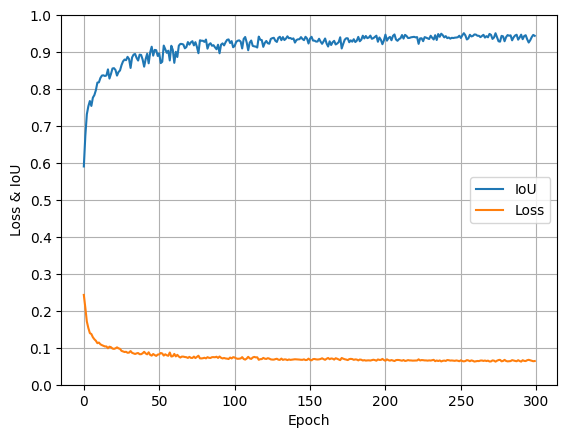

In [291]:
# show iou and loss
plt.figure()
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

In [204]:
dif_weight = 0.33
len_weight = 0.01
std_weight = 0.33

In [205]:
def overfitting_one_image_with_more_losses(img: torch.Tensor, mask: torch.Tensor, epoch_num=300):
    batch_img = img.unsqueeze(0).cuda()
    batch_mask = mask.unsqueeze(0).cuda()
    ras_loss = RasLoss().cuda()
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    dif_loss_dict = {}
    len_loss_dict = {}
    std_loss_dict = {}
    iou_dict = {}
    for e in range(epoch_num):
        model.train()
        optimizer.zero_grad()
        pred_boundary = model(batch_img, batch_mask)
        dif_loss = 0
        len_loss = 0
        std_loss = 0
        for i in range(len(pred_boundary)):
            dif_loss += ras_loss(pred_boundary[i], batch_mask)
            len_loss += total_len_loss(pred_boundary[i])
            tmp_std_loss = deviation_loss(pred_boundary[i])
            if tmp_std_loss > 0.001:
                std_loss += tmp_std_loss
            else:
                std_loss += 0
        dif_loss /= len(pred_boundary)
        len_loss /= len(pred_boundary)
        std_loss /= len(pred_boundary)
        loss = dif_weight * dif_loss + len_weight * len_loss + std_weight * std_loss
        loss.backward()
        optimizer.step()
        iou = get_bou_iou(0, pred_boundary[-1], batch_mask, ras_loss.soft_polygon)
        iou_dict[e] = iou.item()
        dif_loss_dict[e] = dif_loss.item()
        len_loss_dict[e] = len_loss.item()
        std_loss_dict[e] = std_loss.item() if std_loss != 0 else 0
        print(f"EPOCH {e}, Dif Loss: {dif_loss.item():.4f}, Len Loss: {len_loss.item():.4f}, Std Loss: {std_loss_dict[e]:.4f}, IoU: {iou.item():.4f}")
    pred_boundary = model(batch_img, batch_mask)
    show_one_image_result(batch_img, batch_mask, pred_boundary, ras_loss.soft_polygon)
    return dif_loss_dict, len_loss_dict, std_loss_dict, iou_dict
model = DeformLearnImage(
    up_scale_num=4,
    medium_level_size=[14, 56],
).cuda()
# dif_loss_dict, len_loss_dict, std_loss_dict, iou_dict = overfitting_one_image_with_more_losses(bear_img, bear_mask)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


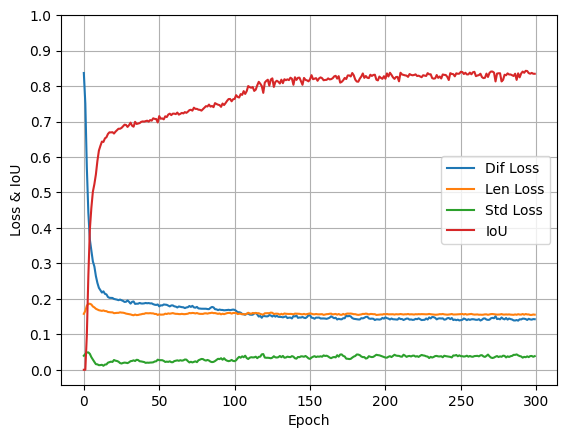

In [34]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.49994587898254395, IoU: 0.32703742384910583
Epoch 1, Loss: 0.46956300735473633, IoU: 0.3669045567512512
Epoch 2, Loss: 0.44462236762046814, IoU: 0.3999468684196472
Epoch 3, Loss: 0.4225129187107086, IoU: 0.4355522394180298
Epoch 4, Loss: 0.4135533273220062, IoU: 0.45276451110839844
Epoch 5, Loss: 0.39927157759666443, IoU: 0.47490760684013367
Epoch 6, Loss: 0.3848129212856293, IoU: 0.4937434792518616
Epoch 7, Loss: 0.37657174468040466, IoU: 0.5152852535247803
Epoch 8, Loss: 0.369698166847229, IoU: 0.5306600332260132
Epoch 9, Loss: 0.36298203468322754, IoU: 0.5355461239814758
Epoch 10, Loss: 0.3549606204032898, IoU: 0.5408241748809814
Epoch 11, Loss: 0.33922478556632996, IoU: 0.5808029770851135
Epoch 12, Loss: 0.33641982078552246, IoU: 0.5795194506645203
Epoch 13, Loss: 0.32858505845069885, IoU: 0.5938239097595215
Epoch 14, Loss: 0.32428333163261414, IoU: 0.6039301156997681
Epoch 15, Loss: 0.3071959912776947, IoU: 0.6366289854049683
Epoch 16, Loss: 0.30007386207580566, I

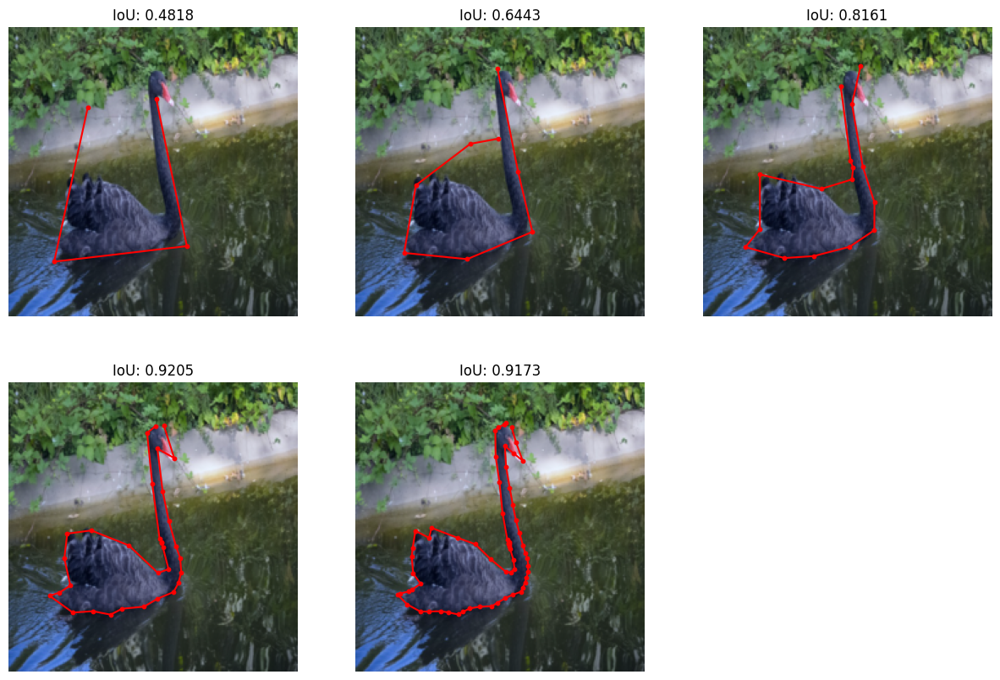

In [292]:
model = DeformLearnImage().cuda()
loss_dict, dif_iou_dict = overfit_one_imge(swan_img, swan_mask, model)

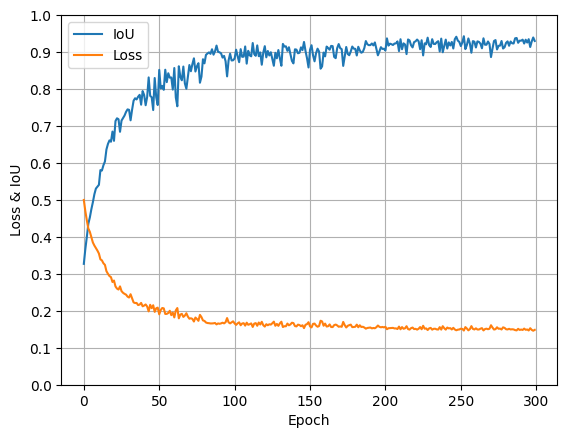

In [293]:
# show iou and loss
plt.figure()
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.9002, Len Loss: 0.2082, Std Loss: 0.0609, IoU: 0.0000
EPOCH 1, Dif Loss: 0.8898, Len Loss: 0.1865, Std Loss: 0.0435, IoU: 0.0000
EPOCH 2, Dif Loss: 0.8663, Len Loss: 0.1899, Std Loss: 0.0390, IoU: 0.0000
EPOCH 3, Dif Loss: 0.8324, Len Loss: 0.1889, Std Loss: 0.0370, IoU: 0.0000
EPOCH 4, Dif Loss: 0.7772, Len Loss: 0.1852, Std Loss: 0.0405, IoU: 0.0000
EPOCH 5, Dif Loss: 0.7294, Len Loss: 0.1792, Std Loss: 0.0376, IoU: 0.0000
EPOCH 6, Dif Loss: 0.6205, Len Loss: 0.1742, Std Loss: 0.0367, IoU: 0.0252
EPOCH 7, Dif Loss: 0.4654, Len Loss: 0.1744, Std Loss: 0.0374, IoU: 0.2221
EPOCH 8, Dif Loss: 0.3866, Len Loss: 0.1722, Std Loss: 0.0342, IoU: 0.4135
EPOCH 9, Dif Loss: 0.3778, Len Loss: 0.1716, Std Loss: 0.0296, IoU: 0.4664
EPOCH 10, Dif Loss: 0.3958, Len Loss: 0.1774, Std Loss: 0.0284, IoU: 0.4504
EPOCH 11, Dif Loss: 0.3866, Len Loss: 0.1748, Std Loss: 0.0256, IoU: 0.4624
EPOCH 12, Dif Loss: 0.3801, Len Loss: 0.1733, Std Loss: 0.0239, IoU: 0.4726
EPOCH 13, Dif Loss: 0.

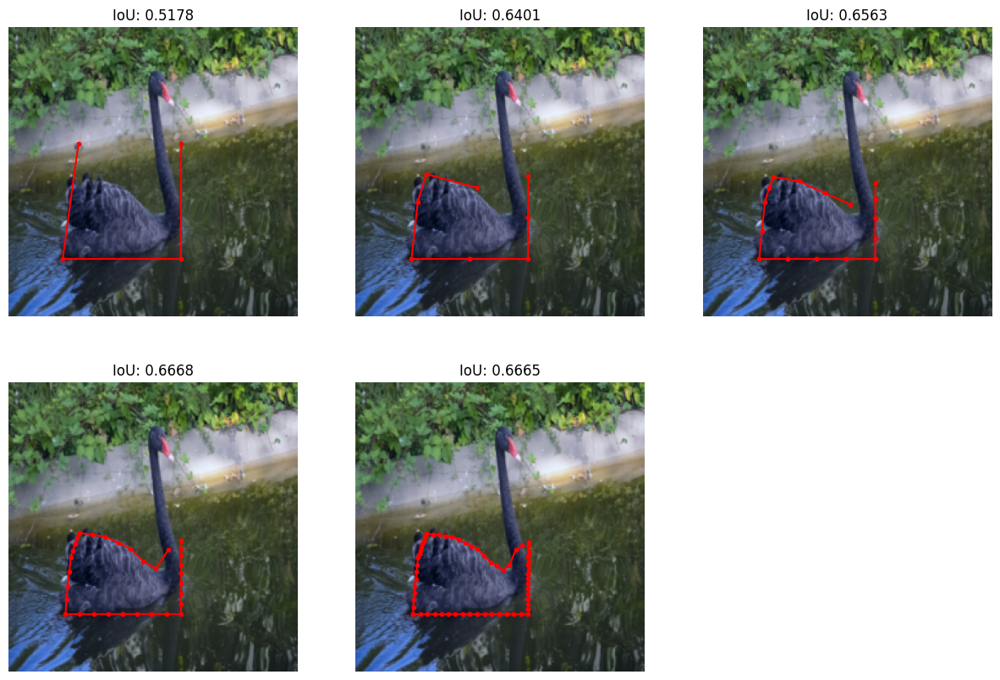

In [48]:
model = DeformLearnImage().cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(swan_img, swan_mask)

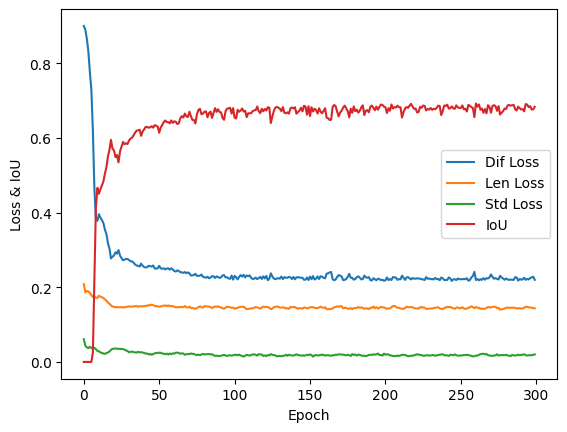

In [49]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.3759619891643524, IoU: 0.447861909866333
Epoch 1, Loss: 0.34095320105552673, IoU: 0.4978533089160919
Epoch 2, Loss: 0.31668469309806824, IoU: 0.5366813540458679
Epoch 3, Loss: 0.30298325419425964, IoU: 0.5552123785018921
Epoch 4, Loss: 0.28910645842552185, IoU: 0.5818771719932556
Epoch 5, Loss: 0.2759014666080475, IoU: 0.6028831601142883
Epoch 6, Loss: 0.27119022607803345, IoU: 0.6145305633544922
Epoch 7, Loss: 0.2639560401439667, IoU: 0.6247013211250305
Epoch 8, Loss: 0.2550605833530426, IoU: 0.6461141109466553
Epoch 9, Loss: 0.24640841782093048, IoU: 0.6629968881607056
Epoch 10, Loss: 0.24277906119823456, IoU: 0.6666430234909058
Epoch 11, Loss: 0.23872776329517365, IoU: 0.6673685312271118
Epoch 12, Loss: 0.22952042520046234, IoU: 0.6933870315551758
Epoch 13, Loss: 0.2221992462873459, IoU: 0.7141922116279602
Epoch 14, Loss: 0.21746936440467834, IoU: 0.7241253852844238
Epoch 15, Loss: 0.21225447952747345, IoU: 0.7278908491134644
Epoch 16, Loss: 0.2069844752550125, IoU:

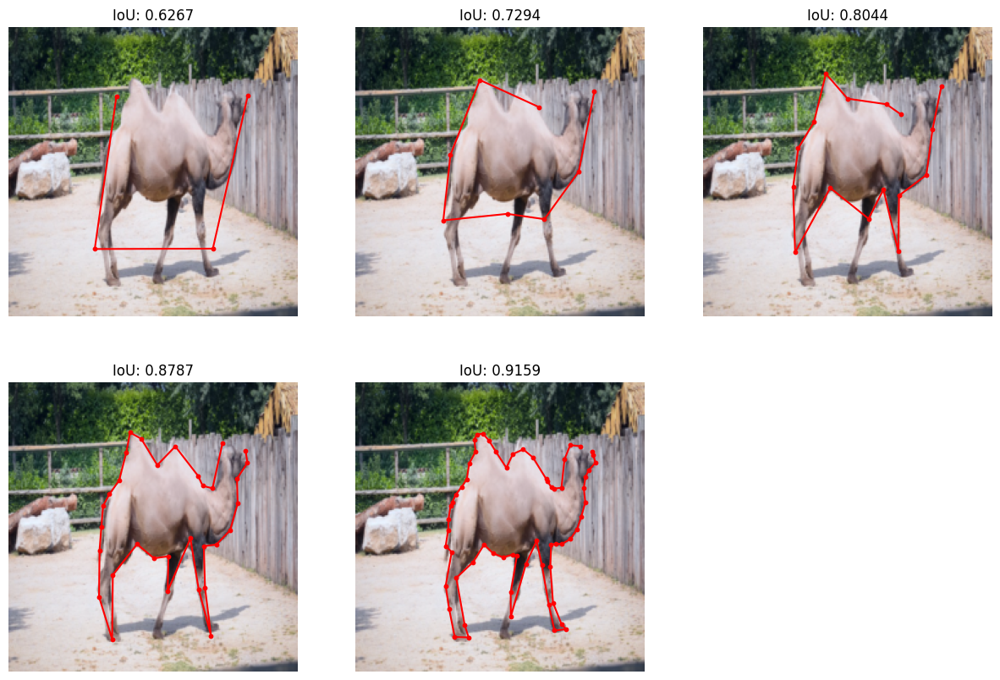

In [298]:
model = DeformLearnImage().cuda()
loss_dict, dif_iou_dict = overfit_one_imge(camel_img, camel_mask, model)

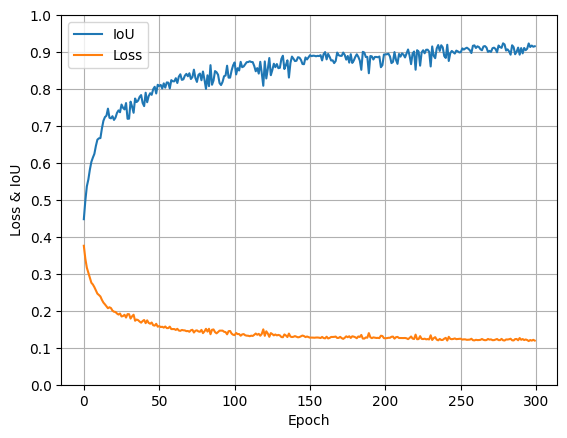

In [299]:
# show iou and loss
plt.figure()
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.3743, Len Loss: 0.2384, Std Loss: 0.0358, IoU: 0.4491
EPOCH 1, Dif Loss: 0.3450, Len Loss: 0.2335, Std Loss: 0.0341, IoU: 0.5019
EPOCH 2, Dif Loss: 0.3228, Len Loss: 0.2274, Std Loss: 0.0333, IoU: 0.5235
EPOCH 3, Dif Loss: 0.3119, Len Loss: 0.2238, Std Loss: 0.0319, IoU: 0.5303
EPOCH 4, Dif Loss: 0.3024, Len Loss: 0.2210, Std Loss: 0.0293, IoU: 0.5465
EPOCH 5, Dif Loss: 0.2917, Len Loss: 0.2190, Std Loss: 0.0277, IoU: 0.5714
EPOCH 6, Dif Loss: 0.2850, Len Loss: 0.2172, Std Loss: 0.0258, IoU: 0.5834
EPOCH 7, Dif Loss: 0.2741, Len Loss: 0.2147, Std Loss: 0.0249, IoU: 0.6072
EPOCH 8, Dif Loss: 0.2634, Len Loss: 0.2117, Std Loss: 0.0249, IoU: 0.6300
EPOCH 9, Dif Loss: 0.2569, Len Loss: 0.2087, Std Loss: 0.0239, IoU: 0.6365
EPOCH 10, Dif Loss: 0.2480, Len Loss: 0.2068, Std Loss: 0.0214, IoU: 0.6549
EPOCH 11, Dif Loss: 0.2372, Len Loss: 0.2030, Std Loss: 0.0210, IoU: 0.6751
EPOCH 12, Dif Loss: 0.2306, Len Loss: 0.2014, Std Loss: 0.0191, IoU: 0.6898
EPOCH 13, Dif Loss: 0.

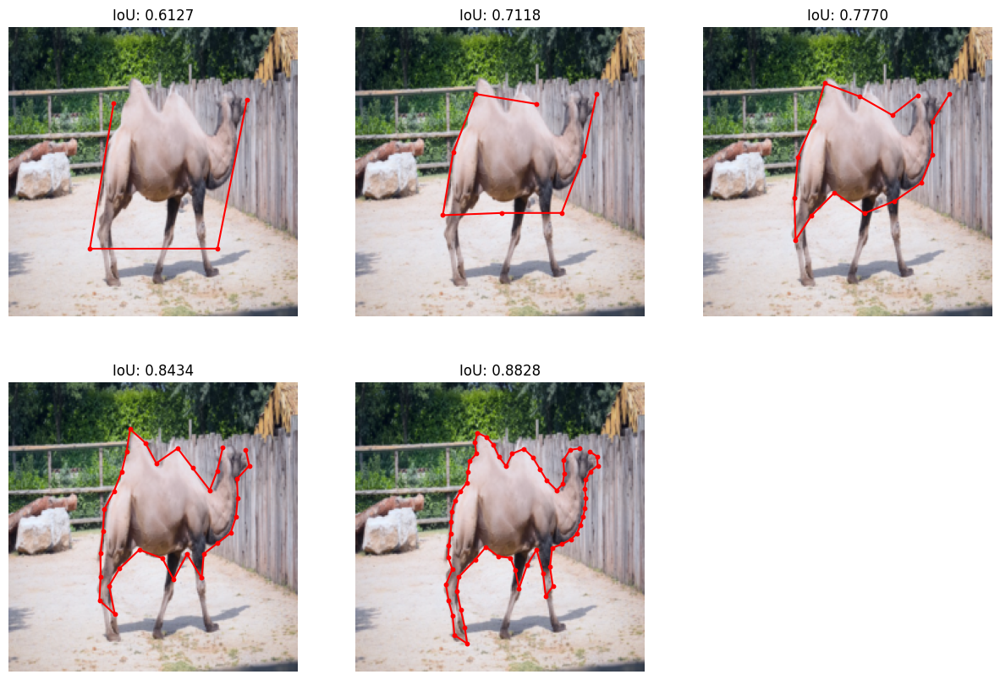

In [206]:
model = DeformLearnImage(
    up_scale_num=4,
    medium_level_size=[14, 56],
).cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(camel_img, camel_mask)

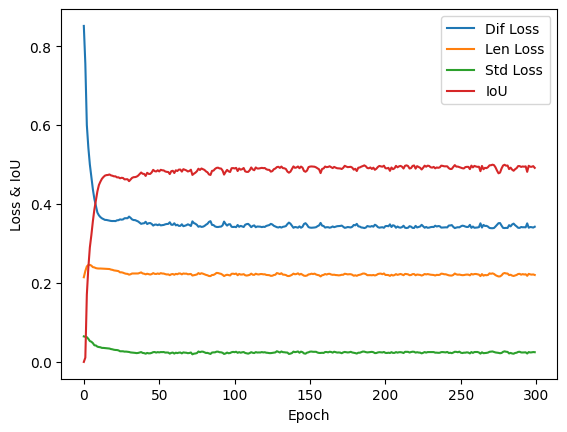

In [53]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.3129219710826874, IoU: 0.5047166347503662
Epoch 1, Loss: 0.27503058314323425, IoU: 0.5822444558143616
Epoch 2, Loss: 0.2404640167951584, IoU: 0.6409837007522583
Epoch 3, Loss: 0.23444171249866486, IoU: 0.64124596118927
Epoch 4, Loss: 0.21911191940307617, IoU: 0.6782846450805664
Epoch 5, Loss: 0.20082271099090576, IoU: 0.7222093343734741
Epoch 6, Loss: 0.20213298499584198, IoU: 0.7141962647438049
Epoch 7, Loss: 0.18806058168411255, IoU: 0.7328943610191345
Epoch 8, Loss: 0.17643094062805176, IoU: 0.7605886459350586
Epoch 9, Loss: 0.18031764030456543, IoU: 0.7531600594520569
Epoch 10, Loss: 0.1680178940296173, IoU: 0.765296995639801
Epoch 11, Loss: 0.1631966531276703, IoU: 0.7611620426177979
Epoch 12, Loss: 0.16496379673480988, IoU: 0.7471693158149719
Epoch 13, Loss: 0.16039450466632843, IoU: 0.7624769806861877
Epoch 14, Loss: 0.1548772007226944, IoU: 0.776063084602356
Epoch 15, Loss: 0.1552269607782364, IoU: 0.7742248773574829
Epoch 16, Loss: 0.15434588491916656, IoU: 0.

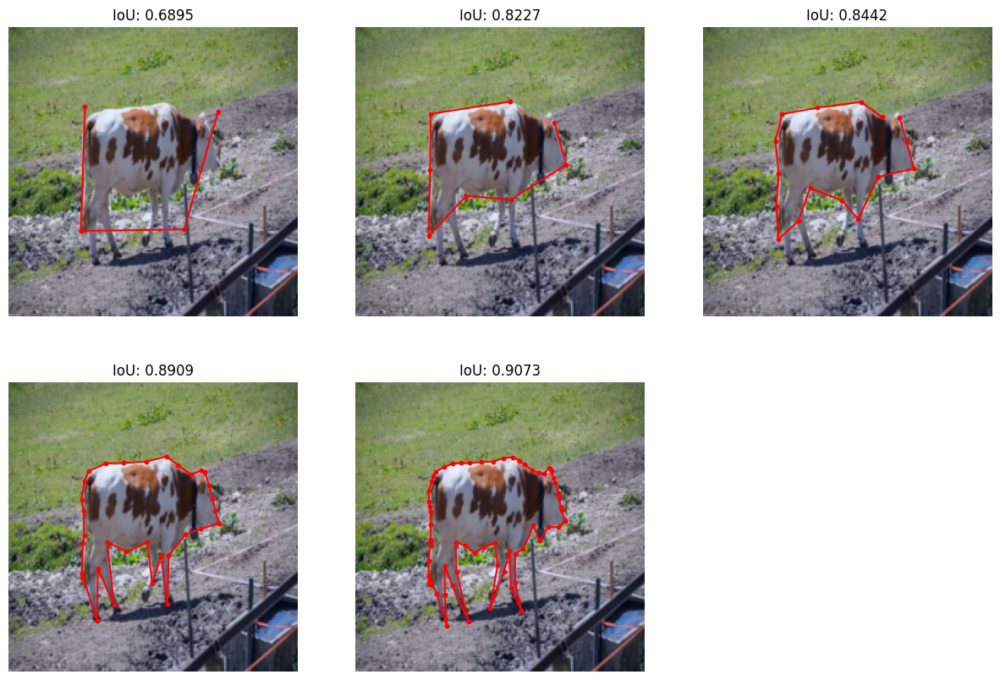

In [300]:
model = DeformLearnImage().cuda()
loss_dict, dif_iou_dict = overfit_one_imge(cow_img, cow_mask, model)

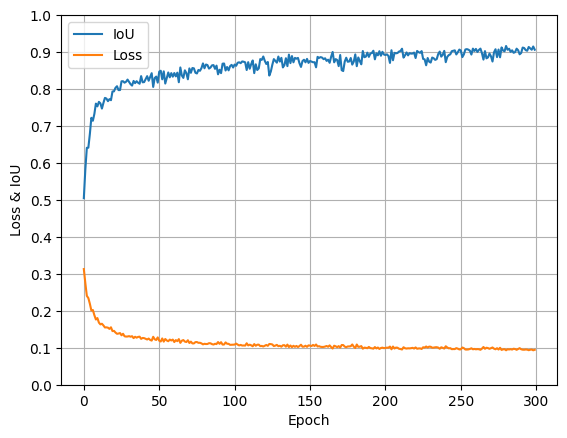

In [301]:
# show iou and loss
plt.figure()
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()


In [42]:
model = DeformLearnImage(
    up_scale_num=4,
    medium_level_size=[14, 56],
).cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(cow_img, cow_mask)


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.9390, Len Loss: 0.1736, Std Loss: 0.0374, IoU: 0.0000
EPOCH 1, Dif Loss: 0.9303, Len Loss: 0.1708, Std Loss: 0.0369, IoU: 0.0000
EPOCH 2, Dif Loss: 0.9160, Len Loss: 0.1748, Std Loss: 0.0414, IoU: 0.0000
EPOCH 3, Dif Loss: 0.9004, Len Loss: 0.1728, Std Loss: 0.0405, IoU: 0.0000
EPOCH 4, Dif Loss: 0.8906, Len Loss: 0.1723, Std Loss: 0.0373, IoU: 0.0000
EPOCH 5, Dif Loss: 0.8546, Len Loss: 0.1733, Std Loss: 0.0377, IoU: 0.0000
EPOCH 6, Dif Loss: 0.8159, Len Loss: 0.1815, Std Loss: 0.0371, IoU: 0.0000
EPOCH 7, Dif Loss: 0.7542, Len Loss: 0.1885, Std Loss: 0.0420, IoU: 0.0000
EPOCH 8, Dif Loss: 0.6249, Len Loss: 0.1951, Std Loss: 0.0440, IoU: 0.0616
EPOCH 9, Dif Loss: 0.5338, Len Loss: 0.1956, Std Loss: 0.0384, IoU: 0.1392
EPOCH 10, Dif Loss: 0.4676, Len Loss: 0.1968, Std Loss: 0.0339, IoU: 0.2191
EPOCH 11, Dif Loss: 0.4056, Len Loss: 0.1968, Std Loss: 0.0279, IoU: 0.3043
EPOCH 12, Dif Loss: 0.3545, Len Loss: 0.1972, Std Loss: 0.0251, IoU: 0.4026
EPOCH 13, Dif Loss: 0.

KeyboardInterrupt: 

In [379]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()

NameError: name 'dif_loss_dict' is not defined

<Figure size 640x480 with 0 Axes>

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.4211713969707489, IoU: 0.39094993472099304
Epoch 1, Loss: 0.3820751905441284, IoU: 0.46065255999565125
Epoch 2, Loss: 0.3546225130558014, IoU: 0.5076444149017334
Epoch 3, Loss: 0.31649693846702576, IoU: 0.5872164368629456
Epoch 4, Loss: 0.2950226366519928, IoU: 0.6172529458999634
Epoch 5, Loss: 0.26850268244743347, IoU: 0.6785630583763123
Epoch 6, Loss: 0.24535074830055237, IoU: 0.7146382331848145
Epoch 7, Loss: 0.24260397255420685, IoU: 0.6631172299385071
Epoch 8, Loss: 0.23385457694530487, IoU: 0.6616283059120178
Epoch 9, Loss: 0.21826224029064178, IoU: 0.6983165144920349
Epoch 10, Loss: 0.2153724730014801, IoU: 0.687186598777771
Epoch 11, Loss: 0.2033996433019638, IoU: 0.7394813299179077
Epoch 12, Loss: 0.19631701707839966, IoU: 0.742171585559845
Epoch 13, Loss: 0.1898737996816635, IoU: 0.7717270255088806
Epoch 14, Loss: 0.18037132918834686, IoU: 0.7856684327125549
Epoch 15, Loss: 0.18331824243068695, IoU: 0.7539745569229126
Epoch 16, Loss: 0.17504771053791046, IoU:

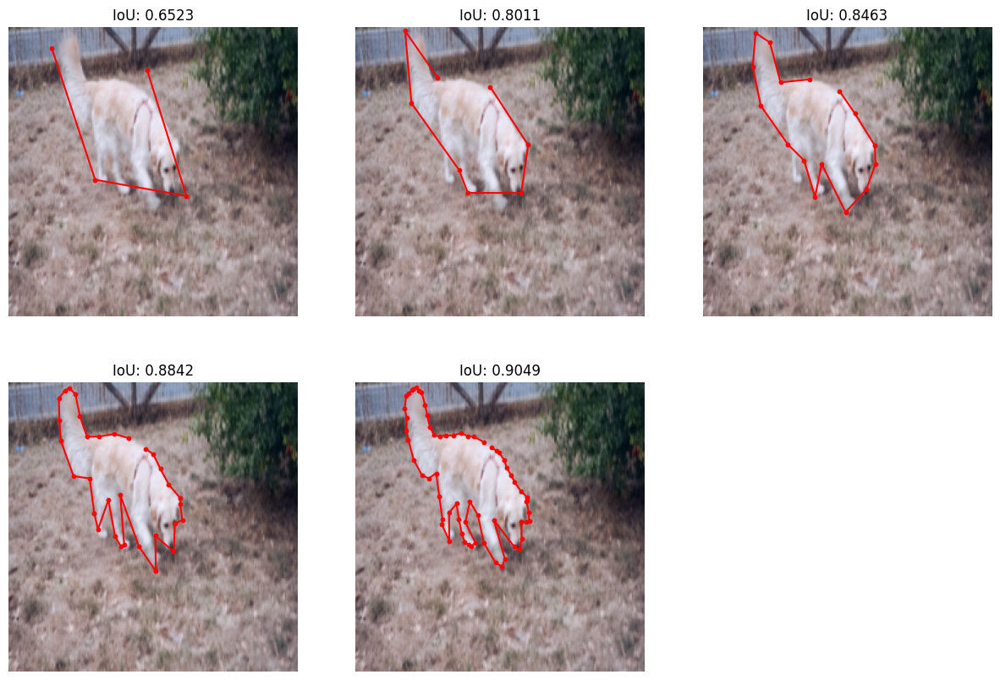

In [302]:
model = DeformLearnImage().cuda()
loss_dict, dif_iou_dict = overfit_one_imge(dog_img, dog_mask, model)


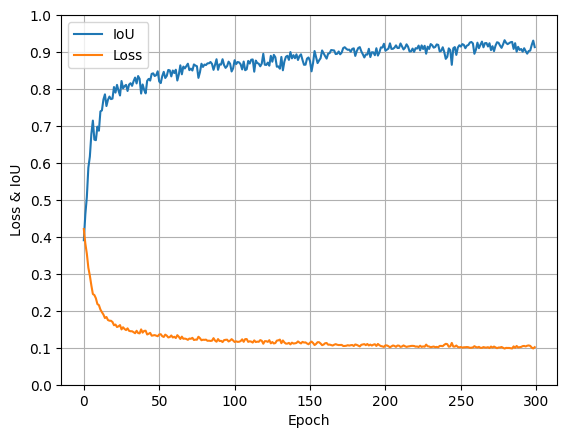

In [304]:
# show iou and loss
plt.figure()
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.grid()
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.8343, Len Loss: 0.1954, Std Loss: 0.0515, IoU: 0.0000
EPOCH 1, Dif Loss: 0.7149, Len Loss: 0.1768, Std Loss: 0.0447, IoU: 0.0096
EPOCH 2, Dif Loss: 0.5717, Len Loss: 0.1769, Std Loss: 0.0429, IoU: 0.0901
EPOCH 3, Dif Loss: 0.4038, Len Loss: 0.1823, Std Loss: 0.0466, IoU: 0.3140
EPOCH 4, Dif Loss: 0.3669, Len Loss: 0.1829, Std Loss: 0.0404, IoU: 0.4470
EPOCH 5, Dif Loss: 0.3423, Len Loss: 0.1817, Std Loss: 0.0404, IoU: 0.4993
EPOCH 6, Dif Loss: 0.3286, Len Loss: 0.1804, Std Loss: 0.0363, IoU: 0.5215
EPOCH 7, Dif Loss: 0.3155, Len Loss: 0.1797, Std Loss: 0.0365, IoU: 0.5459
EPOCH 8, Dif Loss: 0.3017, Len Loss: 0.1773, Std Loss: 0.0344, IoU: 0.5667
EPOCH 9, Dif Loss: 0.2922, Len Loss: 0.1762, Std Loss: 0.0360, IoU: 0.5851
EPOCH 10, Dif Loss: 0.2662, Len Loss: 0.1722, Std Loss: 0.0379, IoU: 0.6146
EPOCH 11, Dif Loss: 0.2525, Len Loss: 0.1676, Std Loss: 0.0396, IoU: 0.6173
EPOCH 12, Dif Loss: 0.2373, Len Loss: 0.1638, Std Loss: 0.0480, IoU: 0.6258
EPOCH 13, Dif Loss: 0.

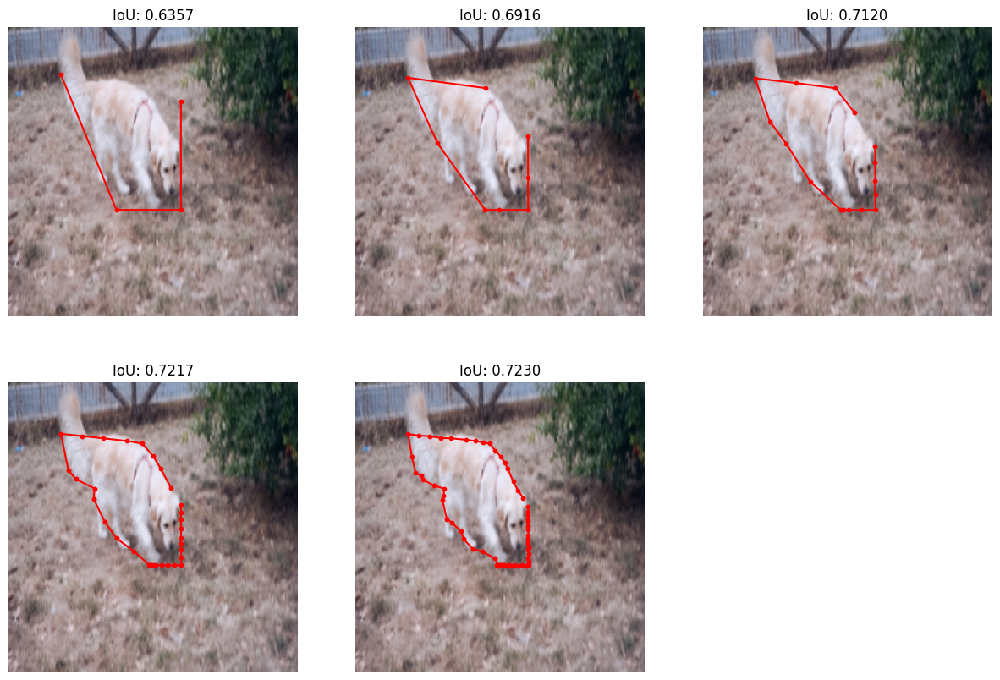

In [60]:
model = DeformLearnImage(
    up_scale_num=4,
    medium_level_size=[14, 56],
).cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(dog_img, dog_mask)


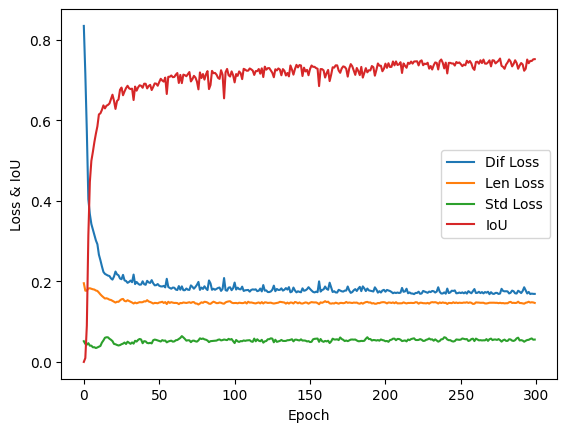

In [61]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()

In [36]:
class DeformBaseImage(nn.Module):
    def __init__(
        self,
        layer_num=1,
        up_scale_num=4,
        head_num=6,
        medium_level_size=[14, 56],
        offset_limit=56,
        n_points=4,
        freeze_backbone=True,
    ) -> None:
        super(DeformBaseImage, self).__init__()
        self.up_scale_num = up_scale_num
        self.offset_limit = offset_limit
        self.medium_level_size = medium_level_size
        self.featup = torch.hub.load(
            "mhamilton723/FeatUp",
            "dino16",
            use_norm=True,
        ).cuda()
        if freeze_backbone:
            for param in self.featup.parameters():
                param.requires_grad = False
        d_model = 384
        d_ffn = 1024
        n_levels = len(medium_level_size) + 1
        self.pos_enoc = PositionalEncoding(d_model)
        self.layer_norm = nn.LayerNorm(d_model)
        deform_encoder_layer = DeformableTransformerEncoderLayer(
            d_model=d_model,
            d_ffn=d_ffn,
            n_levels=n_levels,
            n_heads=head_num,
            n_points=n_points,
        )
        self.deform_encoder = DeformableTransformerEncoder(
            deform_encoder_layer,
            num_layers=layer_num,
        )
        query_num = 4
        self.query_num = query_num
        for i in range(up_scale_num):
            query_num *= 2
        deform_decoder_layer = DeformableTransformerDecoderLayer(
            d_model=d_model,
            d_ffn=d_ffn,
            n_levels=n_levels,
            n_heads=head_num,
            n_points=n_points,
        )
        self.deform_decoder = DeformableTransformerDecoder(
            deform_decoder_layer,
            num_layers=layer_num,
        )
        self.xy_fc = nn.Linear(d_model, 2)

    def get_valid_ratio(self, mask: torch.Tensor):
        _, H, W = mask.shape
        valid_H = torch.sum(~mask[:, :, 0], 1)
        valid_W = torch.sum(~mask[:, 0, :], 1)
        valid_ratio_h = valid_H.float() / H
        valid_ratio_w = valid_W.float() / W
        valid_ratio = torch.stack([valid_ratio_w, valid_ratio_h], -1)
        return valid_ratio

    def forward(
        self,
        img: torch.Tensor,
        mask: torch.Tensor,
    ):
        feats = self.featup(img)
        # prepare the input for the MSDeformAttn module
        srcs = []
        padding_masks = []
        for low_res in self.medium_level_size:
            srcs.append(
                F.interpolate(
                    feats,
                    size=(low_res, low_res),
                    mode="bilinear",
                ),
            )
        srcs.append(feats)
        for src in srcs:
            padding_masks.append(torch.zeros_like(src[:, 0:1, :, :]).squeeze(1).bool())
        src_flatten = []
        spatial_shapes = []
        for src in srcs:
            src_flatten.append(
                rearrange(src, "b c h w -> b (h w) c"),
            )
            spatial_shapes.append(src.shape[-2:])
        level_start_index = torch.cat(
            (
                torch.tensor([0]),
                torch.cumsum(
                    torch.tensor([x.shape[1] for x in src_flatten]),
                    0,
                )[:-1],
            )
        ).cuda()
        src_flatten = torch.cat(src_flatten, 1).cuda()
        valid_ratios = torch.stack(
            [self.get_valid_ratio(mask) for mask in padding_masks],
            1,
        ).cuda()
        spatial_shapes = torch.as_tensor(
            spatial_shapes,
            dtype=torch.long,
            device=src_flatten.device,
        )
        src_flatten = self.layer_norm(src_flatten)
        src_flatten = self.pos_enoc(src_flatten)
        src_flatten = self.deform_encoder(
            src=src_flatten,
            spatial_shapes=spatial_shapes,
            level_start_index=level_start_index,
            valid_ratios=valid_ratios,
        )

        B, S, C = src_flatten.shape
        init_bou = get_bounding_box(mask).cuda() / 224
        query = get_bou_feats(feats, (init_bou * 224).int().clamp(0, 223))
        query = self.layer_norm(query)
        query = self.pos_enoc(query)
        decode_output, _ = self.deform_decoder(
            query,
            init_bou,
            src_flatten,
            spatial_shapes,
            level_start_index,
            valid_ratios,
        )
        xy_offset = self.xy_fc(decode_output).sigmoid() * self.offset_limit / 224
        init_bou += xy_offset
        init_bou = init_bou.clamp(0, 1)
        results = [init_bou]
        for i in range(self.up_scale_num):
            cur_bou = add_mid_points(results[-1])
            query = get_bou_feats(feats, (cur_bou * 224).int().clamp(0, 223))
            query = self.layer_norm(query)
            query = self.pos_enoc(query)
            decode_output, _ = self.deform_decoder(
                query,
                cur_bou,
                src_flatten,
                spatial_shapes,
                level_start_index,
                valid_ratios,
            )
            xy_offset = self.xy_fc(decode_output).sigmoid() * self.offset_limit / 224
            cur_bou += xy_offset
            cur_bou = cur_bou.clamp(0, 1)
            results.append(cur_bou)
        results = [result * 224 for result in results]
        if self.training:
            return results
        else:
            return results[-1]


model = DeformBaseImage(up_scale_num=4).cuda()
model.train()
results = model(batch_bear_img, batch_bear_mask)
results[-1].shape

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


torch.Size([1, 64, 2])

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.8593740463256836, IoU: 0.0
Epoch 1, Loss: 0.7525038123130798, IoU: 0.018668662756681442
Epoch 2, Loss: 0.5813968777656555, IoU: 0.09817400574684143
Epoch 3, Loss: 0.43002891540527344, IoU: 0.2760731875896454
Epoch 4, Loss: 0.3543132245540619, IoU: 0.40715596079826355
Epoch 5, Loss: 0.3164275288581848, IoU: 0.4758470356464386
Epoch 6, Loss: 0.29296836256980896, IoU: 0.5148318409919739
Epoch 7, Loss: 0.27665433287620544, IoU: 0.5386502742767334
Epoch 8, Loss: 0.26552149653434753, IoU: 0.5555582046508789
Epoch 9, Loss: 0.25293368101119995, IoU: 0.5734120607376099
Epoch 10, Loss: 0.24092145264148712, IoU: 0.6015329360961914
Epoch 11, Loss: 0.235049769282341, IoU: 0.6174713969230652
Epoch 12, Loss: 0.23343491554260254, IoU: 0.6240072250366211
Epoch 13, Loss: 0.23353314399719238, IoU: 0.624636709690094
Epoch 14, Loss: 0.23056721687316895, IoU: 0.629645586013794
Epoch 15, Loss: 0.2307778149843216, IoU: 0.6302372217178345
Epoch 16, Loss: 0.22819553315639496, IoU: 0.63603127002

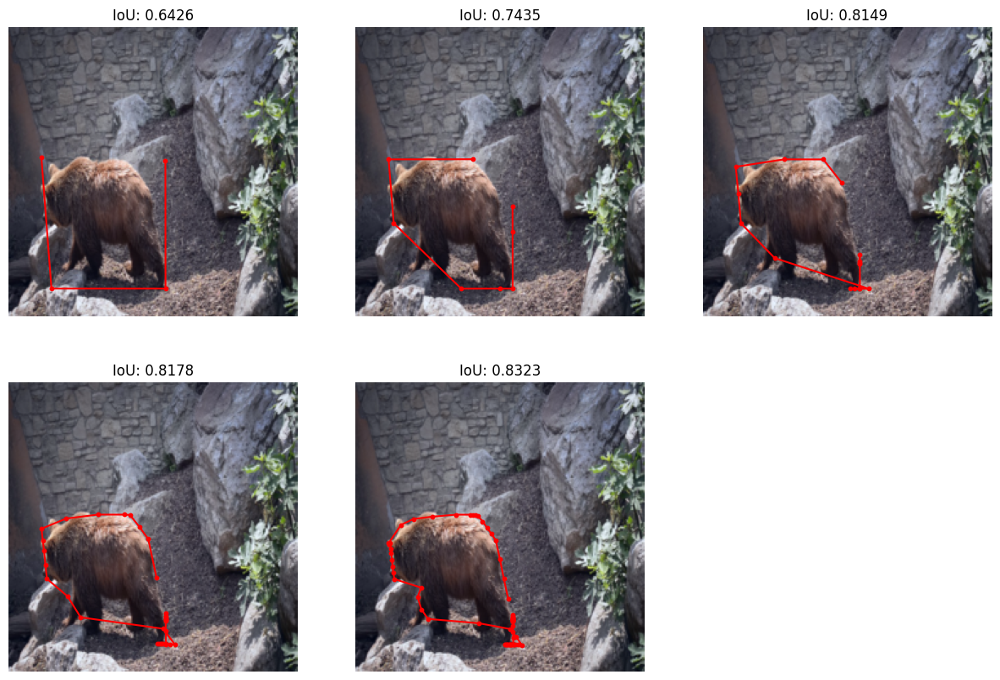

In [39]:
model = DeformBaseImage(up_scale_num=4).cuda()
loss_dict, dif_iou_dict = overfit_one_imge(bear_img, bear_mask, model)

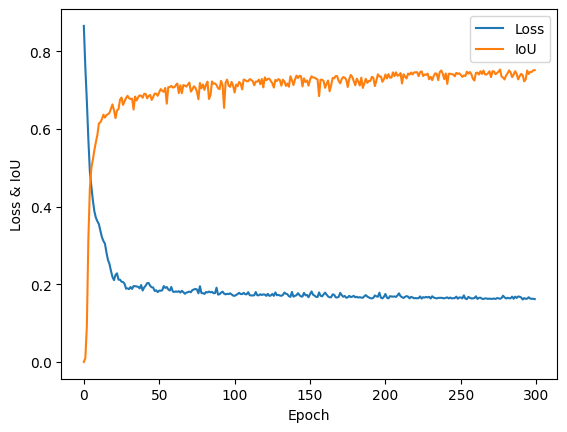

In [62]:
# show iou and loss
plt.figure()
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.8791, Len Loss: 0.1409, Std Loss: 0.0434, IoU: 0.0000
EPOCH 1, Dif Loss: 0.8628, Len Loss: 0.1422, Std Loss: 0.0350, IoU: 0.0000
EPOCH 2, Dif Loss: 0.8100, Len Loss: 0.1469, Std Loss: 0.0401, IoU: 0.0000
EPOCH 3, Dif Loss: 0.7046, Len Loss: 0.1540, Std Loss: 0.0369, IoU: 0.0105
EPOCH 4, Dif Loss: 0.6284, Len Loss: 0.1528, Std Loss: 0.0323, IoU: 0.0533
EPOCH 5, Dif Loss: 0.4856, Len Loss: 0.1597, Std Loss: 0.0329, IoU: 0.1772
EPOCH 6, Dif Loss: 0.3759, Len Loss: 0.1677, Std Loss: 0.0283, IoU: 0.3548
EPOCH 7, Dif Loss: 0.3155, Len Loss: 0.1684, Std Loss: 0.0230, IoU: 0.4654
EPOCH 8, Dif Loss: 0.2842, Len Loss: 0.1689, Std Loss: 0.0172, IoU: 0.5176
EPOCH 9, Dif Loss: 0.2618, Len Loss: 0.1679, Std Loss: 0.0141, IoU: 0.5453
EPOCH 10, Dif Loss: 0.2394, Len Loss: 0.1676, Std Loss: 0.0146, IoU: 0.5936
EPOCH 11, Dif Loss: 0.2257, Len Loss: 0.1669, Std Loss: 0.0129, IoU: 0.6272
EPOCH 12, Dif Loss: 0.2249, Len Loss: 0.1675, Std Loss: 0.0113, IoU: 0.6343
EPOCH 13, Dif Loss: 0.

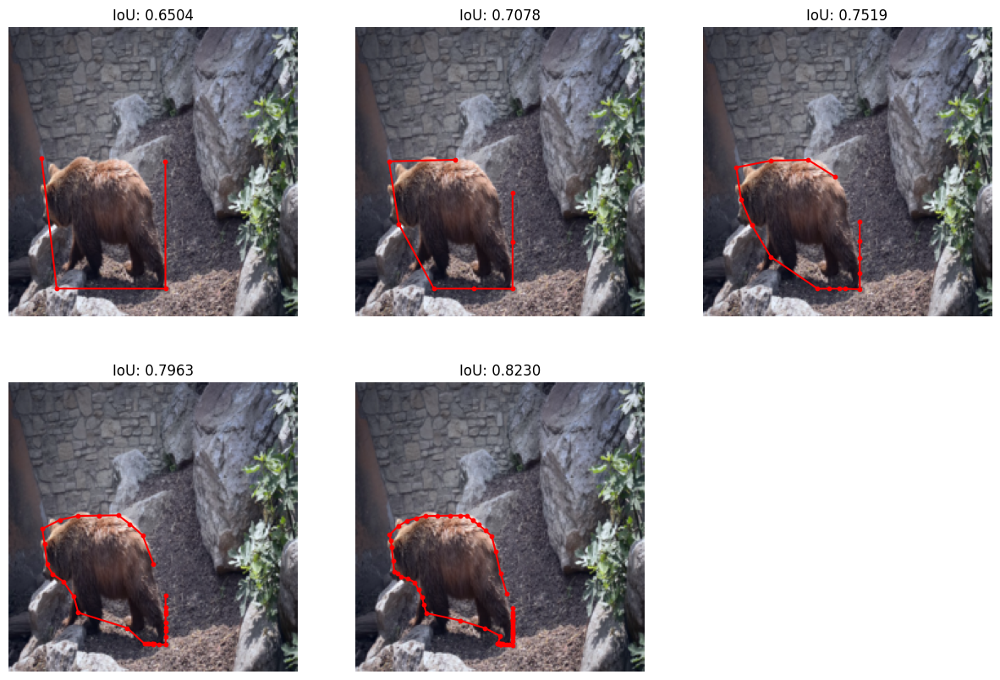

In [63]:
model = DeformBaseImage(up_scale_num=4).cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(bear_img, bear_mask)

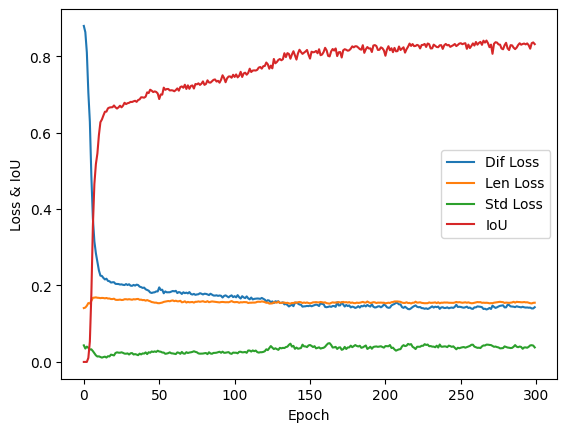

In [64]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.8632704615592957, IoU: 0.0
Epoch 1, Loss: 0.7900102138519287, IoU: 0.0
Epoch 2, Loss: 0.7004556059837341, IoU: 8.470301943972218e-16
Epoch 3, Loss: 0.6176661849021912, IoU: 0.04896005988121033
Epoch 4, Loss: 0.5060197114944458, IoU: 0.2639866769313812
Epoch 5, Loss: 0.46855804324150085, IoU: 0.3441680669784546
Epoch 6, Loss: 0.4503489136695862, IoU: 0.3721117079257965
Epoch 7, Loss: 0.4231052100658417, IoU: 0.39155516028404236
Epoch 8, Loss: 0.4069279134273529, IoU: 0.4221513271331787
Epoch 9, Loss: 0.37871477007865906, IoU: 0.46529334783554077
Epoch 10, Loss: 0.3673969805240631, IoU: 0.48805972933769226
Epoch 11, Loss: 0.3526155948638916, IoU: 0.5069620609283447
Epoch 12, Loss: 0.33740925788879395, IoU: 0.5265769362449646
Epoch 13, Loss: 0.3135435879230499, IoU: 0.5484142303466797
Epoch 14, Loss: 0.2791813910007477, IoU: 0.5924148559570312
Epoch 15, Loss: 0.2864025831222534, IoU: 0.5835806727409363
Epoch 16, Loss: 0.2813096344470978, IoU: 0.5810369253158569
Epoch 17, 

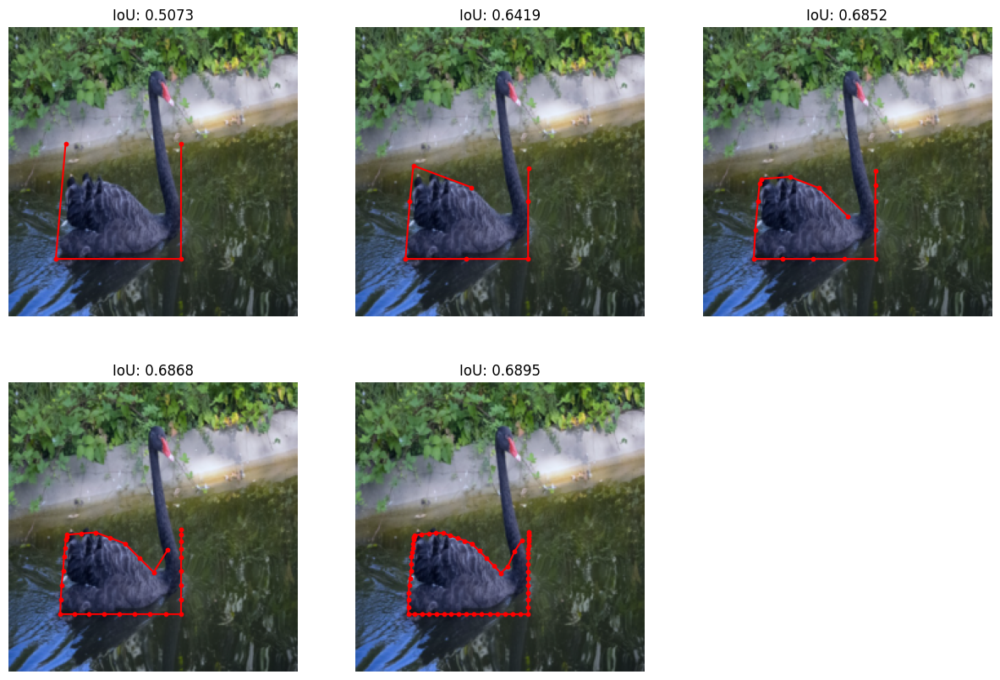

In [65]:
model = DeformBaseImage(up_scale_num=4).cuda()
loss_dict, dif_iou_dict = overfit_one_imge(swan_img, swan_mask, model)

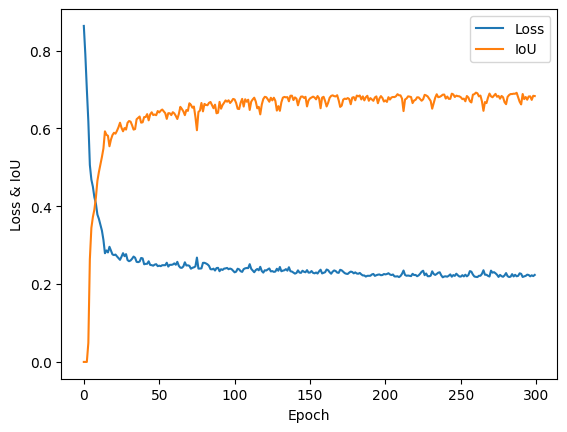

In [66]:
# show iou and loss
plt.figure()
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.8691, Len Loss: 0.2047, Std Loss: 0.0506, IoU: 0.0000
EPOCH 1, Dif Loss: 0.8070, Len Loss: 0.1823, Std Loss: 0.0434, IoU: 0.0000
EPOCH 2, Dif Loss: 0.7606, Len Loss: 0.1795, Std Loss: 0.0312, IoU: 0.0000
EPOCH 3, Dif Loss: 0.7409, Len Loss: 0.1761, Std Loss: 0.0311, IoU: 0.0000
EPOCH 4, Dif Loss: 0.6789, Len Loss: 0.1735, Std Loss: 0.0220, IoU: 0.0000
EPOCH 5, Dif Loss: 0.5310, Len Loss: 0.1678, Std Loss: 0.0194, IoU: 0.0892
EPOCH 6, Dif Loss: 0.4279, Len Loss: 0.1734, Std Loss: 0.0186, IoU: 0.3235
EPOCH 7, Dif Loss: 0.3901, Len Loss: 0.1764, Std Loss: 0.0185, IoU: 0.4432
EPOCH 8, Dif Loss: 0.3860, Len Loss: 0.1766, Std Loss: 0.0200, IoU: 0.4536
EPOCH 9, Dif Loss: 0.4016, Len Loss: 0.1814, Std Loss: 0.0201, IoU: 0.4573
EPOCH 10, Dif Loss: 0.3937, Len Loss: 0.1812, Std Loss: 0.0212, IoU: 0.4765
EPOCH 11, Dif Loss: 0.3866, Len Loss: 0.1782, Std Loss: 0.0168, IoU: 0.4820
EPOCH 12, Dif Loss: 0.3728, Len Loss: 0.1739, Std Loss: 0.0181, IoU: 0.4967
EPOCH 13, Dif Loss: 0.

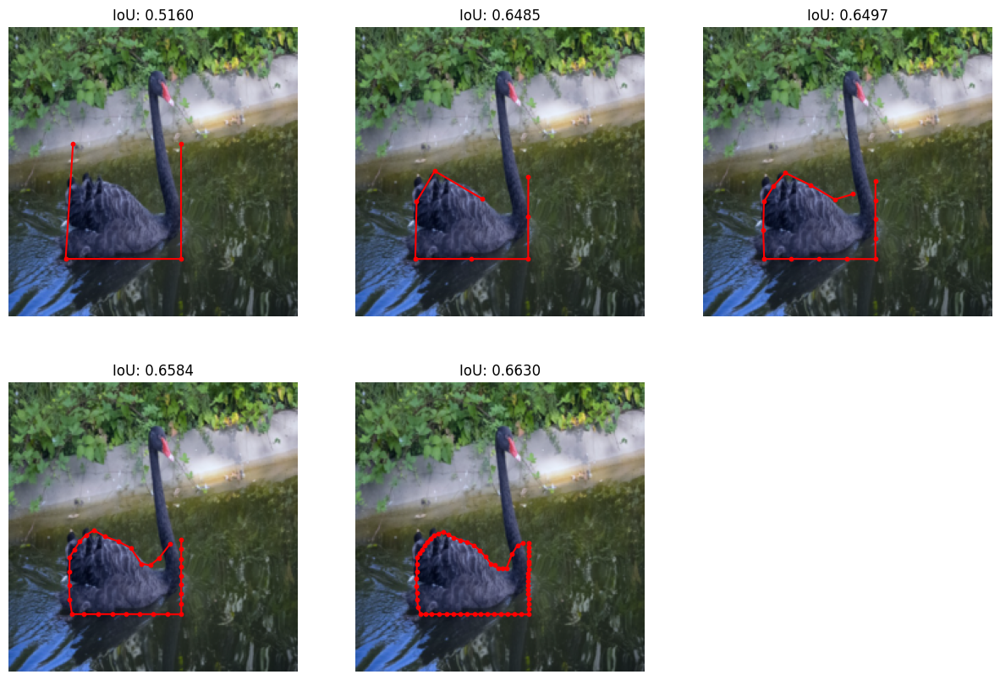

In [67]:
model = DeformBaseImage(up_scale_num=4).cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(swan_img, swan_mask)


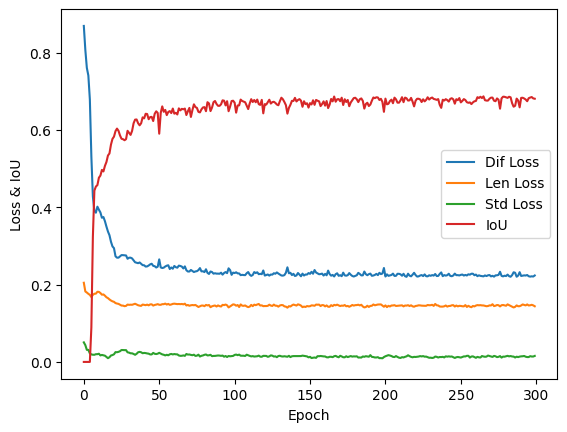

In [68]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.9084145426750183, IoU: 0.0
Epoch 1, Loss: 0.8055999875068665, IoU: 0.0
Epoch 2, Loss: 0.7152588963508606, IoU: 0.04938103258609772
Epoch 3, Loss: 0.6150016188621521, IoU: 0.16223961114883423
Epoch 4, Loss: 0.5511322021484375, IoU: 0.23736687004566193
Epoch 5, Loss: 0.5114448666572571, IoU: 0.299570769071579
Epoch 6, Loss: 0.49723559617996216, IoU: 0.32457485795021057
Epoch 7, Loss: 0.49383145570755005, IoU: 0.327821284532547
Epoch 8, Loss: 0.4704490602016449, IoU: 0.338699609041214
Epoch 9, Loss: 0.45849522948265076, IoU: 0.3440857231616974
Epoch 10, Loss: 0.4355689585208893, IoU: 0.36881202459335327
Epoch 11, Loss: 0.41507968306541443, IoU: 0.3901916444301605
Epoch 12, Loss: 0.4018249213695526, IoU: 0.40448689460754395
Epoch 13, Loss: 0.3919965922832489, IoU: 0.42207276821136475
Epoch 14, Loss: 0.3774533271789551, IoU: 0.4373941421508789
Epoch 15, Loss: 0.36920711398124695, IoU: 0.4545435309410095
Epoch 16, Loss: 0.3674241006374359, IoU: 0.46016526222229004
Epoch 17, 

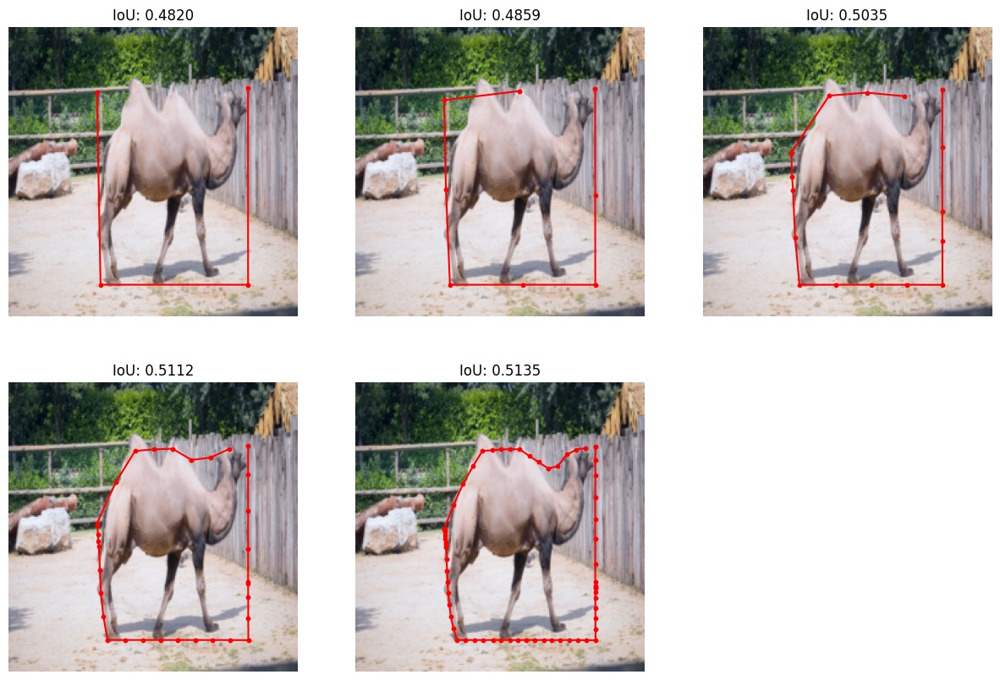

In [69]:
model = DeformBaseImage(up_scale_num=4).cuda()
loss_dict, dif_iou_dict = overfit_one_imge(camel_img, camel_mask, model)

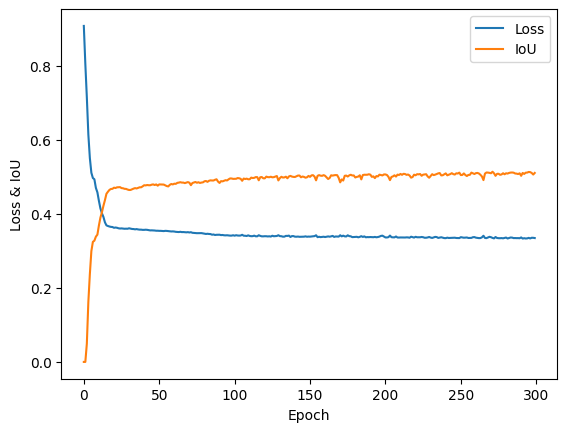

In [70]:
# show iou and loss
plt.figure()
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.8997, Len Loss: 0.2002, Std Loss: 0.0578, IoU: 0.0000
EPOCH 1, Dif Loss: 0.8858, Len Loss: 0.1917, Std Loss: 0.0495, IoU: 0.0000
EPOCH 2, Dif Loss: 0.8405, Len Loss: 0.2012, Std Loss: 0.0434, IoU: 0.0010
EPOCH 3, Dif Loss: 0.8092, Len Loss: 0.2013, Std Loss: 0.0373, IoU: 0.0139
EPOCH 4, Dif Loss: 0.7151, Len Loss: 0.2066, Std Loss: 0.0366, IoU: 0.0506
EPOCH 5, Dif Loss: 0.6224, Len Loss: 0.2134, Std Loss: 0.0314, IoU: 0.1135
EPOCH 6, Dif Loss: 0.5012, Len Loss: 0.2185, Std Loss: 0.0354, IoU: 0.2459
EPOCH 7, Dif Loss: 0.4492, Len Loss: 0.2231, Std Loss: 0.0301, IoU: 0.3106
EPOCH 8, Dif Loss: 0.4107, Len Loss: 0.2273, Std Loss: 0.0333, IoU: 0.3784
EPOCH 9, Dif Loss: 0.3851, Len Loss: 0.2316, Std Loss: 0.0361, IoU: 0.4099
EPOCH 10, Dif Loss: 0.3734, Len Loss: 0.2326, Std Loss: 0.0344, IoU: 0.4330
EPOCH 11, Dif Loss: 0.3607, Len Loss: 0.2343, Std Loss: 0.0349, IoU: 0.4618
EPOCH 12, Dif Loss: 0.3600, Len Loss: 0.2356, Std Loss: 0.0344, IoU: 0.4714
EPOCH 13, Dif Loss: 0.

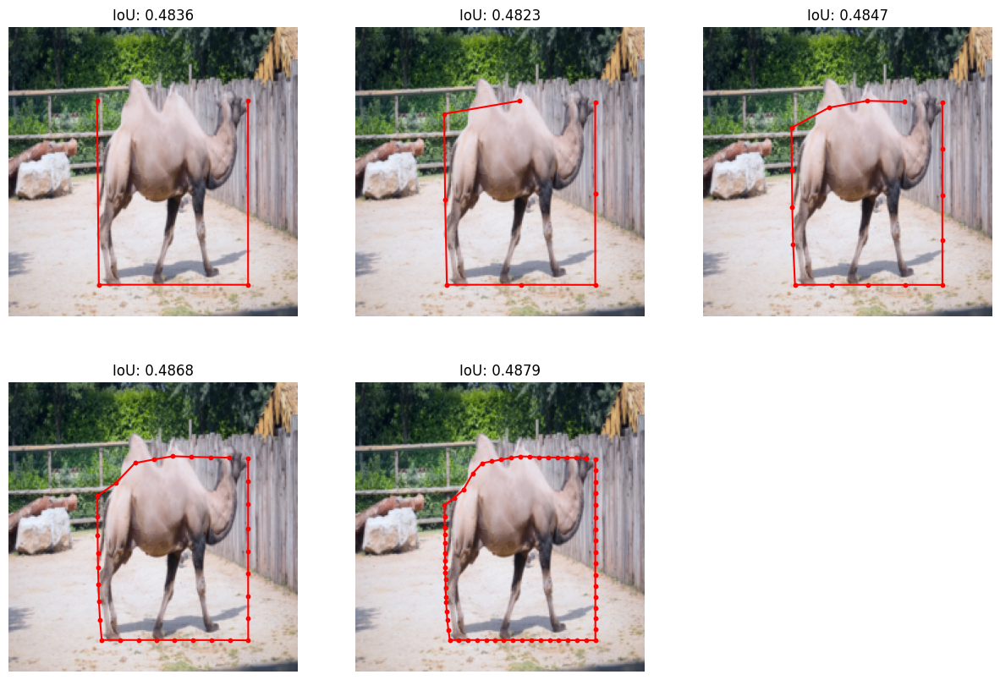

In [71]:
model = DeformBaseImage(up_scale_num=4).cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(camel_img, camel_mask)


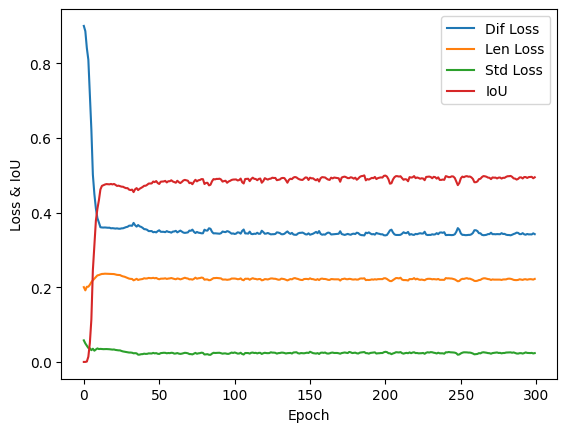

In [72]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.8300922513008118, IoU: 0.00310900853946805
Epoch 1, Loss: 0.6690075993537903, IoU: 0.05531080812215805
Epoch 2, Loss: 0.5329713225364685, IoU: 0.17903125286102295
Epoch 3, Loss: 0.4413033425807953, IoU: 0.28425562381744385
Epoch 4, Loss: 0.37576547265052795, IoU: 0.3851928412914276
Epoch 5, Loss: 0.34990987181663513, IoU: 0.4323265552520752
Epoch 6, Loss: 0.32410502433776855, IoU: 0.48284539580345154
Epoch 7, Loss: 0.3129781484603882, IoU: 0.5086624622344971
Epoch 8, Loss: 0.30451008677482605, IoU: 0.5233278870582581
Epoch 9, Loss: 0.3021450638771057, IoU: 0.5292463898658752
Epoch 10, Loss: 0.30026721954345703, IoU: 0.5339822173118591
Epoch 11, Loss: 0.2994438707828522, IoU: 0.5354558229446411
Epoch 12, Loss: 0.29845255613327026, IoU: 0.5371326804161072
Epoch 13, Loss: 0.29736989736557007, IoU: 0.5394009947776794
Epoch 14, Loss: 0.2972012758255005, IoU: 0.5401601791381836
Epoch 15, Loss: 0.2969844341278076, IoU: 0.5406953692436218
Epoch 16, Loss: 0.29664871096611023, I

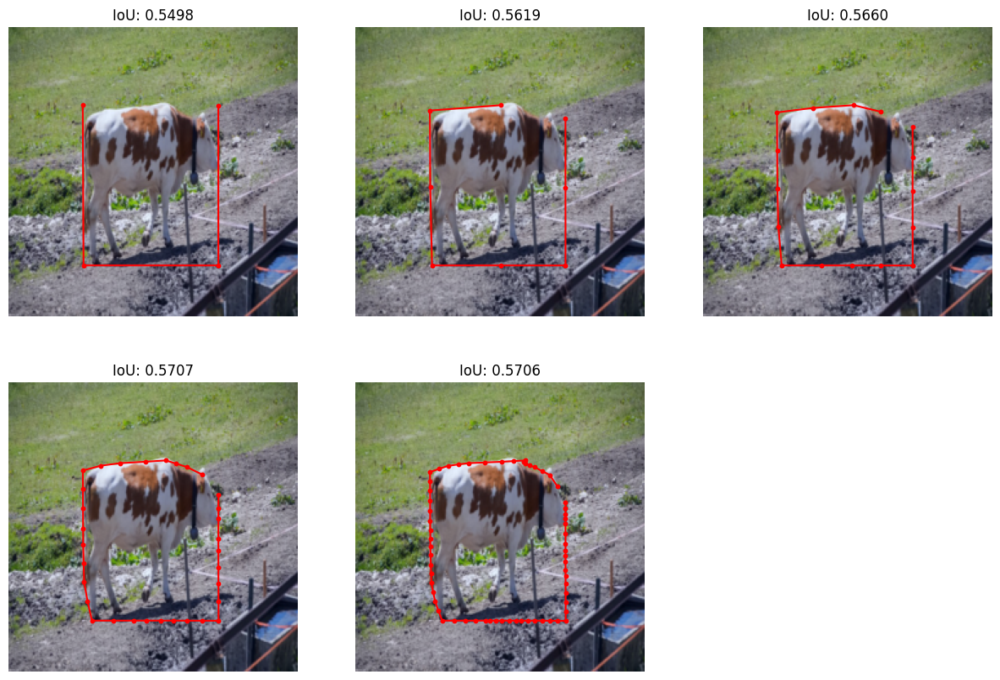

In [73]:
model = DeformBaseImage(up_scale_num=4).cuda()
loss_dict, dif_iou_dict = overfit_one_imge(cow_img, cow_mask, model)


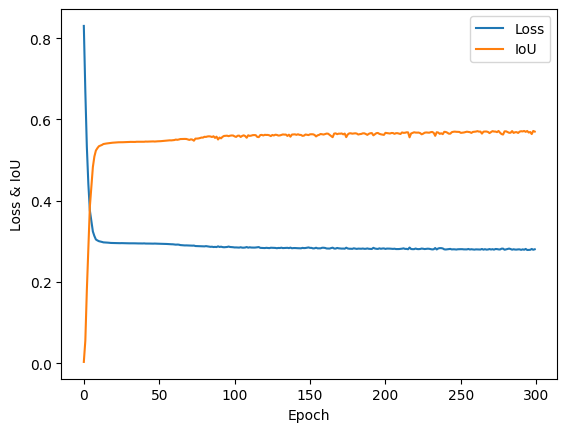

In [74]:
# show iou and loss
plt.figure()
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.8819, Len Loss: 0.2016, Std Loss: 0.0527, IoU: 0.0000
EPOCH 1, Dif Loss: 0.8014, Len Loss: 0.2107, Std Loss: 0.0608, IoU: 0.0000
EPOCH 2, Dif Loss: 0.6717, Len Loss: 0.2198, Std Loss: 0.0503, IoU: 0.0690
EPOCH 3, Dif Loss: 0.5619, Len Loss: 0.2159, Std Loss: 0.0450, IoU: 0.1698
EPOCH 4, Dif Loss: 0.4749, Len Loss: 0.2141, Std Loss: 0.0341, IoU: 0.2639
EPOCH 5, Dif Loss: 0.4061, Len Loss: 0.2068, Std Loss: 0.0259, IoU: 0.3386
EPOCH 6, Dif Loss: 0.3537, Len Loss: 0.2034, Std Loss: 0.0214, IoU: 0.4267
EPOCH 7, Dif Loss: 0.3276, Len Loss: 0.2014, Std Loss: 0.0201, IoU: 0.4790
EPOCH 8, Dif Loss: 0.3167, Len Loss: 0.2004, Std Loss: 0.0194, IoU: 0.5001
EPOCH 9, Dif Loss: 0.3066, Len Loss: 0.2001, Std Loss: 0.0185, IoU: 0.5199
EPOCH 10, Dif Loss: 0.3027, Len Loss: 0.1999, Std Loss: 0.0184, IoU: 0.5278
EPOCH 11, Dif Loss: 0.3008, Len Loss: 0.1999, Std Loss: 0.0183, IoU: 0.5326
EPOCH 12, Dif Loss: 0.2994, Len Loss: 0.1999, Std Loss: 0.0182, IoU: 0.5359
EPOCH 13, Dif Loss: 0.

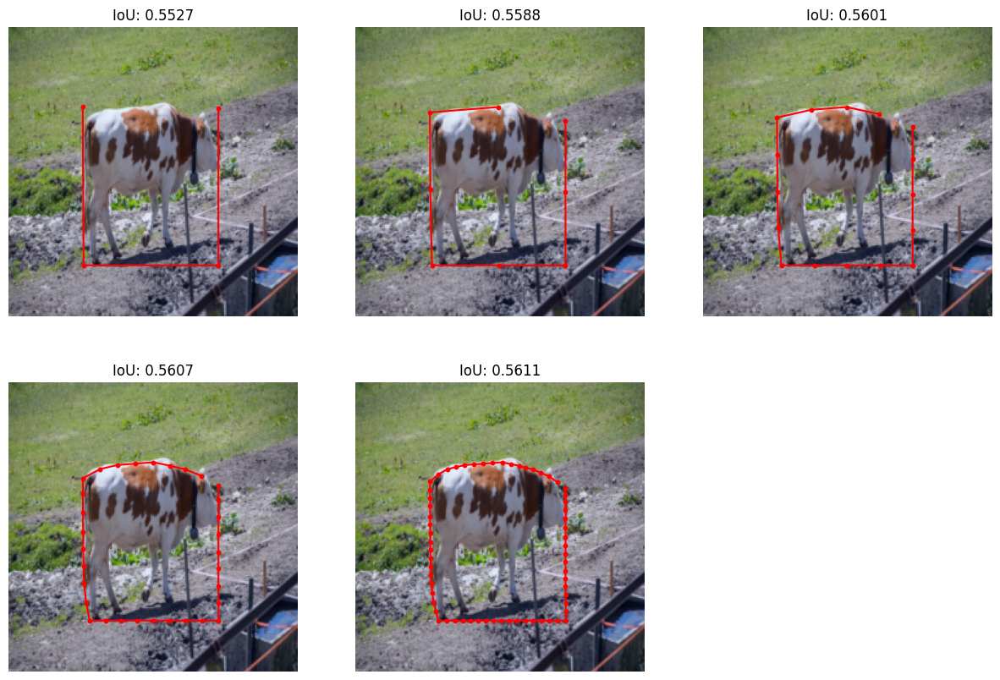

In [75]:
model = DeformBaseImage(up_scale_num=4).cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(cow_img, cow_mask)


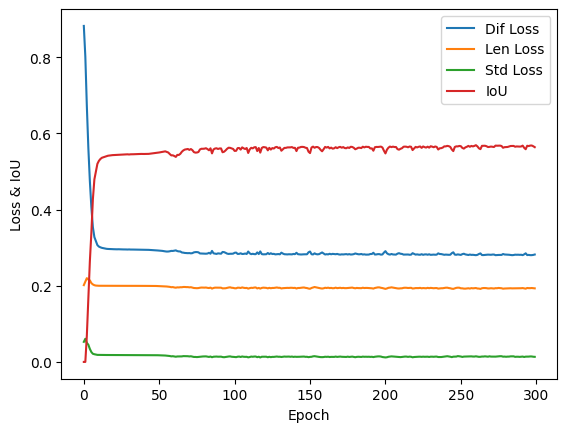

In [76]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


Epoch 0, Loss: 0.7974475026130676, IoU: 0.0
Epoch 1, Loss: 0.6387249231338501, IoU: 0.06926202774047852
Epoch 2, Loss: 0.5406486392021179, IoU: 0.16561943292617798
Epoch 3, Loss: 0.4450136721134186, IoU: 0.29928237199783325
Epoch 4, Loss: 0.39557918906211853, IoU: 0.4206732213497162
Epoch 5, Loss: 0.3773449957370758, IoU: 0.4614163935184479
Epoch 6, Loss: 0.3732467293739319, IoU: 0.4708108901977539
Epoch 7, Loss: 0.36125221848487854, IoU: 0.48837557435035706
Epoch 8, Loss: 0.355111688375473, IoU: 0.507209837436676
Epoch 9, Loss: 0.3428739607334137, IoU: 0.5266498923301697
Epoch 10, Loss: 0.3364727199077606, IoU: 0.5391178131103516
Epoch 11, Loss: 0.3269631266593933, IoU: 0.5523616075515747
Epoch 12, Loss: 0.30712732672691345, IoU: 0.5800407528877258
Epoch 13, Loss: 0.29473504424095154, IoU: 0.5693222284317017
Epoch 14, Loss: 0.27576860785484314, IoU: 0.5989453196525574
Epoch 15, Loss: 0.26249128580093384, IoU: 0.5990396738052368
Epoch 16, Loss: 0.25042805075645447, IoU: 0.6055682301521

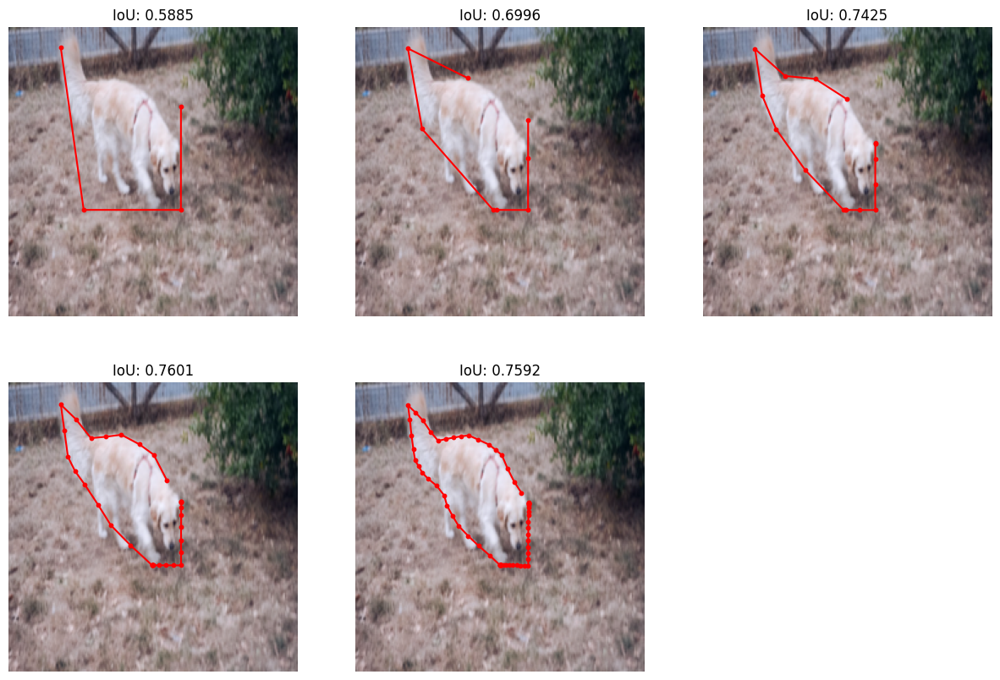

In [77]:
model = DeformBaseImage(up_scale_num=4).cuda()
loss_dict, dif_iou_dict = overfit_one_imge(dog_img, dog_mask, model)


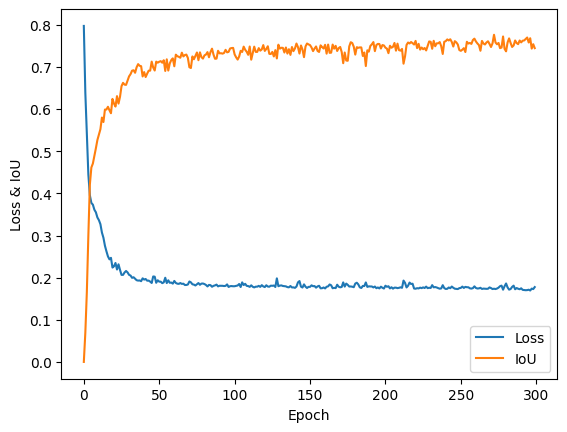

In [78]:
# show iou and loss
plt.figure()
plt.plot(list(loss_dict.keys()), list(loss_dict.values()), label="Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


EPOCH 0, Dif Loss: 0.8570, Len Loss: 0.1795, Std Loss: 0.0360, IoU: 0.0000
EPOCH 1, Dif Loss: 0.7736, Len Loss: 0.1788, Std Loss: 0.0330, IoU: 0.0000
EPOCH 2, Dif Loss: 0.6820, Len Loss: 0.1698, Std Loss: 0.0249, IoU: 0.0100
EPOCH 3, Dif Loss: 0.5483, Len Loss: 0.1762, Std Loss: 0.0221, IoU: 0.1102
EPOCH 4, Dif Loss: 0.4054, Len Loss: 0.1773, Std Loss: 0.0241, IoU: 0.3350
EPOCH 5, Dif Loss: 0.3743, Len Loss: 0.1794, Std Loss: 0.0234, IoU: 0.4323
EPOCH 6, Dif Loss: 0.3576, Len Loss: 0.1779, Std Loss: 0.0210, IoU: 0.4699
EPOCH 7, Dif Loss: 0.3376, Len Loss: 0.1764, Std Loss: 0.0219, IoU: 0.4984
EPOCH 8, Dif Loss: 0.3299, Len Loss: 0.1746, Std Loss: 0.0195, IoU: 0.5133
EPOCH 9, Dif Loss: 0.3185, Len Loss: 0.1686, Std Loss: 0.0159, IoU: 0.5129
EPOCH 10, Dif Loss: 0.3153, Len Loss: 0.1684, Std Loss: 0.0162, IoU: 0.5110
EPOCH 11, Dif Loss: 0.3201, Len Loss: 0.1650, Std Loss: 0.0135, IoU: 0.5039
EPOCH 12, Dif Loss: 0.3153, Len Loss: 0.1629, Std Loss: 0.0139, IoU: 0.5174
EPOCH 13, Dif Loss: 0.

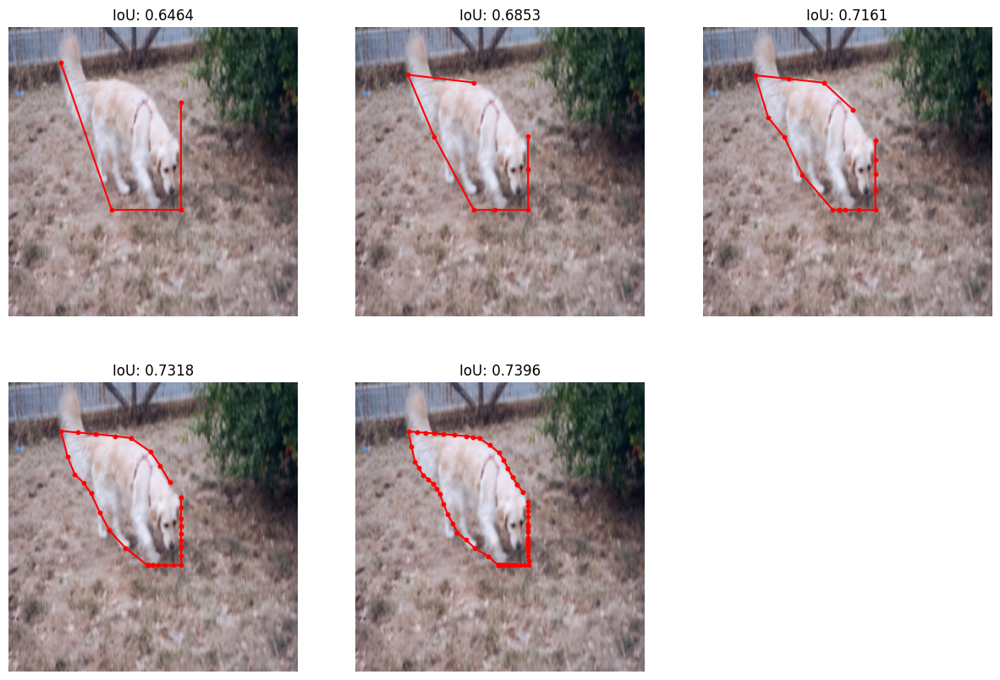

In [79]:
model = DeformBaseImage(up_scale_num=4).cuda()
dif_loss_dict, len_loss_dict, std_loss_dict, dif_iou_dict = overfitting_one_image_with_more_losses(dog_img, dog_mask)

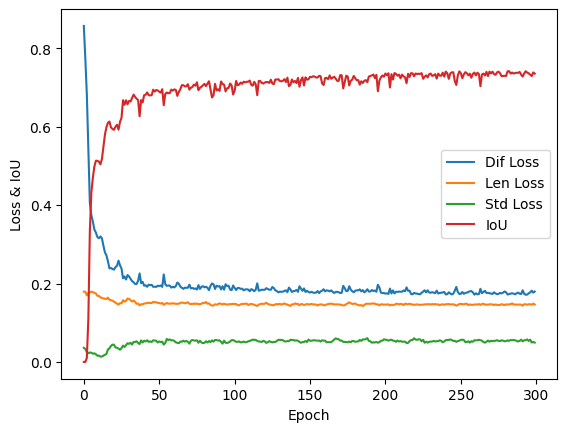

In [80]:
# show iou and loss
plt.figure()
plt.plot(list(dif_loss_dict.keys()), list(dif_loss_dict.values()), label="Dif Loss")
plt.plot(list(len_loss_dict.keys()), list(len_loss_dict.values()), label="Len Loss")
plt.plot(list(std_loss_dict.keys()), list(std_loss_dict.values()), label="Std Loss")
plt.plot(list(dif_iou_dict.keys()), list(dif_iou_dict.values()), label="IoU")
plt.legend()
plt.xlabel("Epoch")
plt.ylabel("Loss & IoU")
plt.show()
